# Overview

## Model diagram

<img src='mathmod_figures/math_model_v03.tif' width="800">
<br><br>
<center><b> Mathematical model schematic.</b><br> We hypothesize that the anchor plays a role in cluster formation -- since it is proposed to stabilize Src at the membrane, it could slow diffusion as well. </center>

## Model equations

\begin{align} \\
\frac{\text{d}{Src}_{cl,cy}}{\text{d}t} & = \eta\left[ -k_3{Src}_{cl,cy}+ k_4{Src}_{cl,me} \right]\\
\frac{\text{d}{Src}_{cl,me}}{\text{d}t} & = -(k_4 + k_2){Src}_{cl,me} + k_3 {Src}_{cl,cy} + k_1 {Src}_{op,me} \\
\frac{\text{d}{Src}_{op,cy}}{\text{d}t} & = \eta\left[-k_3 {Src}_{op,cy} + k_4 {Src}_{op,me} + k_5 {Src}_{op,me,Anc} \right]\\
\frac{\text{d}{Src}_{op,me}}{\text{d}t} & = -(k_1 + k_4 + k_9 Binder + k_7 Anchor){Src}_{op,me} + k_2 {Src}_{cl,me} + k_3 {Src}_{op,cy} + k_{8}{Src}_{op,me,Anc} + k_{10}{Src}_{op,me,Bin} \\
\frac{\text{d}{Src}_{op,me,Bin}}{\text{d}t} & = -(k_{10} + k_7Anchor + k_4){Src}_{op,me,Bin} + k_9Binder \bullet {Src}_{op,me} + k_8 {Src}_{op,me,Bin,Anc} + k_3 {Src}_{op,cy,Bin} \\
\frac{\text{d}{Src}_{op,me,Anc}}{\text{d}t} & = -(k_5 + k_8 + k_9Binder){Src}_{op,me,Anc} + k_7Anchor\bullet {Src}_{op,me} +  k_{10} {Src}_{op,me,Bin,Anc} \\
\frac{\text{d}{Src}_{op,me,Bin,Anc}}{\text{d}t} & = -(k_5 + k_8 + k_{10}){Src}_{op,me,Bin,Anc} + k_7Anchor \bullet {Src}_{op,me,Bin} + k_9 Binder \bullet {Src}_{op,me,Anc} \\
\frac{\text{d}{Src}_{op,cy,Bin}}{\text{d}t} & = \eta\left[-k_3{Src}_{op,cy,Bin} + k_4{Src}_{op,me,Bin} + k_5{Src}_{op,me,Bin,Anc} \right]\\
\frac{\text{d}{Binder}}{\text{d}t} & = \eta\left[-k_9({Src}_{op,me} + {Src}_{op,me,Anc}) Binder + k_{10}({Src}_{op,me,Bin} + {Src}_{op,me,Bin,Anc}) \right]\\
\frac{\text{d}{Anchor}}{\text{d}t} & = -k_7({Src}_{op,me} + {Src}_{op,me,Bin}) Anchor + k_{8}({Src}_{op,me,Anc} + {Src}_{op,me,Bin,Anc}) + k_{5}({Src}_{op,me,Anc} + {Src}_{op,me,Bin,Anc}) \\
\end{align}

Where $op$ indicates open, $cl$ indicates closed, $me$ indicated membrane-associated, $cy$ indicates cytosolic, $Bin$ indicates Binder is associated, $Anc$ indicates a membrane anchor is associated, and $\eta$ is the volume ratio between the cytosol and membrane.

## Model constraints

In the ODE model, we use time units of ms, and concentration units of $\mu$M. This allows for nicer numbers for computation.

### Membrane-cytoplasm volume ratio
We use $\eta=0.04$, meaning that the membrane volume is assumed to be 4% of the cytosol volume. We also assume a 2000 $\mu$m$^3$ volume for a MEF cell, which seems reasonable as far as I can tell (see [Akhoondi M et al, Biochem Biophys Acta. 2011](https://www.ncbi.nlm.nih.gov/pubmed/21126509) and [the Harvard Bionumbers database](http://bionumbers.hms.harvard.edu/search.aspx?trm=mouse+embroynic+fibroblast+volume)).

### First order rate constants

For our first-order rate constants, we use a range of [0,100] s$^{-1}$.

### Second order rate constants

For most of our second-order rate constants, we use a range of [0,1000] $\mu$M$^{-1}$s$^{-1}$, capping at the upper limit of enzyme-substrate reactions as estimated by Alberty, Hammes, and Eigen (_J. Phys. Chem._ 1958, 62(2), 154-9; _Advances in Enzymology and Related Areas of Molecular Biology_ (1963) p.1-38).

### Concentrations

We use a range of [0,1] $\mu$M for tagSrc and Binder, with the cell cytosol volume as reference. We use a range of [0,100] $\mu$M for the anchor, with the cell membrane volume as reference. A higher concentration is =/= a higher abundance, so we let the (membrane-restricted) anchor range up to 100x tagSrc and Binder concentrations.

# Simulating the ODE

## EA code (for Longleaf)

In [ ]:
#!/usr/bin/env python

import numpy as np
from scipy.sparse import diags
from scipy.sparse import identity
from scipy.linalg import solve
import sys
import os
import matplotlib
import matplotlib.pyplot as plt
from deap import base, creator, tools, algorithms
import pickle
import time as timeski
from scipy.integrate import odeint
import warnings
#%matplotlib inline

###################################################################
#EA PARAMS
###################################################################
number_of_runs = 10
number_of_generations = 200
number_of_individuals = 200
number_of_parameters = 12
mutation_rate = 0.1
crossover_rate = 0.5

data_to_score_against = 'test'

###################################################################
#CHECK FOR / CREATE DIR FOR DATA
###################################################################
def strip_filename(fn):
    #input = full path filename
    #output = filename only
    #EX input = '/home/iammoresentient/phd_lab/data/data_posnegfb_3cellsum.pickled'
    #EX output = 'data_posnegfb_3cellsum'
    if '/' in fn:
        fn = fn.split('/')[-1]
    fn = fn.split('.')[0]
    return fn


def add_info(fn, gens, inds, mutationrate, crossoverrate):
    #input = filename only
    #output = date + filename + EA data
    # EX input = 'data_posnegfb_3cellsum'
    # EX output = '170327_data_posnegfb_3cellsum_#g#i#m#c'
    
    #get current date:
    cur_date = timeski.strftime('%y%m%d')
    # setup EA data:
    ea_data = str(gens) + 'g' + str(inds) + 'i' + str(int(mutationrate*100)) + 'm' + str(int(crossoverrate*100)) + 'c'
    #put it all together:
    new_fn = cur_date + '_' + os.path.basename(__file__).split('.')[0].split('_')[-1] + '_' + ea_data
    return new_fn
    
stripped_name = strip_filename(data_to_score_against)
informed_name = add_info(stripped_name, number_of_generations, number_of_individuals, mutation_rate, crossover_rate)
fn_to_use = informed_name
dir_to_use = os.getcwd() + '/' + informed_name

#check if dir exists and make 
if not os.path.isdir(dir_to_use):
    os.makedirs(dir_to_use)
    # and make README file:
    fn = dir_to_use + '/' + 'README.txt'
    file = open(fn, 'w')
    
    # write pertinent info at top
    file.write('README\n\n')
    file.write('Filename: ' + fn_to_use + '\n')
    file.write('Directory: ' + dir_to_use + '\n')
    file.write('Data file: ' + data_to_score_against + '\n\n')
    file.write('Generations: ' + str(number_of_generations) + '\n')
    file.write('Individuals: ' + str(number_of_individuals) + '\n')
    file.write('Mutation rate: ' + str(mutation_rate) + '\n')
    file.write('Crossover rate: ' + str(crossover_rate) + '\n')
    file.write('\n\n\n\n')

    script_name = os.path.basename(__file__)
    open_script = open(script_name, 'r')
    write_script = open_script.read()
    file.write(write_script)
    open_script.close()

    file.close()


def ssODE(y,t,p):
    eta = 0.04
    A,B,C,D,E,F,G,H,I,J = y
    [k1,k2,k3,k4,k5,k6,k7,k8,k9,k10,k11]=p
    #k11=0.
    dA = -k3*A + k4*B
    dB = -(k2+k4)*B + k3*A + k1*D
    dC = -(k3+k6*J)*C + k4*D + k11*H + k5*F
    dD = -(k1+k4+k9*I+k7*J)*D + k2*B + k3*C + k10*E + k8*F
    dE = -(k10+k7*J+k4)*E + k9*I*D + k8*G + k3*H
    dF = -(k8+k9*I+k5)*F + k7*J*D + k10*G + k6*J*C
    dG = -(k8+k10+k5)*G + k7*E*J + k9*I*F +k6*J*H
    dH = -(k3+k11+k6*J)*H + k4*E + k5*G
    dI = -(k9*D+k9*F)*I + k10*(E+G) + k11*H
    dJ = -(k6*(C+H)+k7*(D+E))*J + k5*(F+G) + k8*(F+G)
        
    derivs = [dA*eta,dB,dC*eta,dD,dE,dF,dG,dH*eta,dI*eta,dJ]
    return derivs


def get_lifetime(ss,p):
    A,B,C,D,E,F,G,H,I,J = ss
    [k1,k2,k3,k4,k5,k6,k7,k8,k9,k10,k11]=p
    
    ts_flux = (B*k4 + D*k4 + E*k4 + F*k4 + F*k5 + G*k5) / (B+D+E+F+G) # G was removed from the denominator here
    bin_flux = (E*k10 + G*k10 + E*k4) / (E+G)
    
    ts_lifetime = 1./ts_flux
    bin_lifetime = 1./bin_flux
    
    return ts_lifetime,bin_lifetime

def sim(p,doplot):
    eta = 0.04
    # added k5 back in, which is the anchor-mediated release rate.
    k1,k2,k3,k4,k5,k7,k8,k9,k10,tS_base,bin_base,J_tot = p
    k11=0.
    #k5=0.
    k6=0.
    odeparams = [k1,k2,k3,k4,k5,k6,k7,k8,k9,k10,k11]
    
    tS_tot = tS_base * np.array((1.,4.,6.,10.))
    bin_tot = bin_base * np.array((1.,4.,6.,10.))
    
    ts_life = np.zeros(4)
    bin_life = np.zeros(4)
    
    for i in range(0,4):
        y0 = [tS_tot[i],0.,0.,0.,0.,0.,0.,0.,bin_tot[i],J_tot]
        t = np.arange(0.,1000.,.1) # run to SS.
        odeSoln = odeint(ssODE,y0,t,args=(odeparams,))
        ts_life[i],bin_life[i] = get_lifetime(odeSoln[-1,:],odeparams)

    if doplot:
        eta = 0.04
        plt.figure()
        plt.plot([1.,4.,6.,10.],ts_life,marker='o',linestyle='none',markeredgecolor='k',
                markerfacecolor='k')
        plt.figure()
        plt.plot([1.,4.,6.,10.],bin_life,marker='o',linestyle='none',markeredgecolor='k',
                markerfacecolor='k')     
        plt.figure()
        result = odeSoln
        
        tS_tot_tc = result[:,0] + eta*result[:,1] + result[:,2] + eta*result[:,3] \
                                + eta*result[:,4] + eta*result[:,5] + eta*result[:,6] \
                                + result[:,7]
        bin_tot_tc = eta*result[:,4] + eta*result[:,6] + result[:,7] + result[:,8]
        J_tot_tc = eta*result[:,5] + eta*result[:,6] + eta*result[:,9]
        fig,ax=plt.subplots(1,3)
        ax[0].plot(t,tS_tot_tc)
        ax[1].plot(t,bin_tot_tc)
        ax[2].plot(t,J_tot_tc)
        plt.title('mass conservation check')

    return ts_life,bin_life

###################################################################
#MATRIX FOR VARIABLES TO INTERP AND EXPONENTIATE 
###################################################################
def make_conversion_matrix():
# matrix for variables to interp and exponentiate 
# matrix has 5 rows X len_ind columns
# ROW 0: interp boolean
# ROW 1: interp range min 
# ROW 2: interp range max
# ROW 3: power boolean
# ROW 4: power base
    #number of parameters:
    len_ind = number_of_parameters
    arr_IandP = np.zeros((5,len_ind))
    
    # set 
    a,b = 0, len_ind
    arr_IandP[1,a:b] = 0 #interp_range_min
    arr_IandP[2,a:b] = 1 #interp_range_max
    arr_IandP[4,a:b] = 0 #power_base

    unimol_rxn_ids = [0,1,2,3,4,6,8]
    for i in range(0,7):
        arr_IandP[2,unimol_rxn_ids[i]] = 0.1 # interp_range_max
    # set k8, unimol_rxn_ids[4] constrained further
    arr_IandP[1,unimol_rxn_ids[5]]=0.005
    arr_IandP[2,unimol_rxn_ids[5]]=0.015
    
    ## set k4 and k10, unimol_rxn_ids[3] and [5] constrained further
    #arr_IandP[1,unimol_rxn_ids[3]]=0.01 # lower bound >10 s-1
    #arr_IandP[1,unimol_rxn_ids[5]]=0.01
    
    
    # second order rxns are [0,1] uM-1 ms-1, as desired.
    
    # concentrations are [0,1] uM for tagSrc and Binder
    
    # concentration for anchor is [0,100] uM
    arr_IandP[2,-1]=100
        
    #don't mess with this:
    #auto set interp_bool and power_bool cells:
    arr_IandP[0][np.nonzero(arr_IandP[1])] = 1 #if interp_range_min =/= 0
    arr_IandP[0][np.nonzero(arr_IandP[2])] = 1 #if interp_range_max =/= 0
    arr_IandP[3][np.nonzero(arr_IandP[4])] = 1 #if power_base =/= 0

    return arr_IandP

#make conversion matrix
arr_conversion_matrix = make_conversion_matrix()

def convert_individual(ea_individual, conversion_matrix):
# use conversion matrix to convert interp and exponentiate individual:
    # conversion matrix has 5 rows of arrs of size len(individual):
        # conversion_matrix[0] = interp_bool
        # conversion_matrix[1] = interp_range_min
        # conversion_matrix[2] = interp_range_max
        # conversion_matrix[3] = power_bool
        # conversion_matrix[4] = base_val
    
    # copy and get len of individual
    arr_params_conv = np.copy(ea_individual)
    len_ind = len(ea_individual)

    # Interp:
    for idx in np.nonzero(conversion_matrix[0])[0]:
        ea_val = ea_individual[idx]
        r_min = conversion_matrix[1][idx]
        r_max = conversion_matrix[2][idx]
        arr_params_conv[idx] = np.interp(ea_val, (0,1), (r_min, r_max))
        
    # Exponentiate:
    for idx in np.nonzero(conversion_matrix[3])[0]:
        ea_val = arr_params_conv[idx]
        base_val = conversion_matrix[4][idx]
        arr_params_conv[idx] = np.power(base_val, ea_val)
        
    return arr_params_conv

def score(ea_individual):
    #print(ea_individual)

    #convert EA 0-1 parameter values into correct range:
    arr_params = convert_individual(ea_individual, arr_conversion_matrix)
    
    #simulate converted parameter values:
    ts_lifetime,bin_lifetime = sim(arr_params, False) 
    
    #ts_ref = [675.,645.,635.,610.]
    ts_ref=[710.4,639.5,632.4,621.8]
    #bin_ref = [470.,370.,330.,320.]
    bin_ref = [469.,371.,343.,330.]
    score = sum( (ts_ref-ts_lifetime)**2 + (bin_ref-bin_lifetime)**2 )
    #print(score)
    return score,

###################################################################
#EVOLUTIONARY ALGORITHM
###################################################################


for i in range(number_of_runs):
    #TYPE
    #Create minimizing fitness class w/ single objective:
    creator.create('FitnessMin', base.Fitness, weights=(-1.0,))
    #Create individual class:
    creator.create('Individual', list, fitness=creator.FitnessMin)

    #TOOLBOX
    toolbox = base.Toolbox()
    #Register function to create a number in the interval [1-100?]:
    #toolbox.register('init_params', )
    #Register function to use initRepeat to fill individual w/ n calls to rand_num:
    toolbox.register('individual', tools.initRepeat, creator.Individual, 
                     np.random.random, n=number_of_parameters)
    #Register function to use initRepeat to fill population with individuals:
    toolbox.register('population', tools.initRepeat, list, toolbox.individual)

    #GENETIC OPERATORS:
    # Register evaluate fxn = evaluation function, individual to evaluate given later
    toolbox.register('evaluate', score)
    # Register mate fxn = two points crossover function 
    toolbox.register('mate', tools.cxTwoPoint)
    # Register mutate by swapping two points of the individual:
    toolbox.register('mutate', tools.mutPolynomialBounded, 
                     eta=0.1, low=0.0, up=1.0, indpb=0.2)
    # Register select = size of tournament set to 3
    toolbox.register('select', tools.selTournament, tournsize=3)

    #EVOLUTION!
    pop = toolbox.population(n=number_of_individuals)
    hof = tools.HallOfFame(1)

    stats = tools.Statistics(key = lambda ind: [ind.fitness.values, ind])
    stats.register('all', np.copy)

    # using built in eaSimple algo
    pop, logbook = algorithms.eaSimple(pop, toolbox, cxpb=crossover_rate, 
                                       mutpb=mutation_rate, 
                                       ngen=number_of_generations, 
                                       stats=stats, halloffame=hof, 
                                       verbose=False)

    
    ###################################################################
    #MAKE LISTS
    ###################################################################
    # Find best scores and individuals in population 
    arr_best_score = []
    arr_best_ind = []
    for a in range(len(logbook)):
        scores = []
        for b in range(len(logbook[a]['all'])):
            scores.append(logbook[a]['all'][b][0][0])
        #print(a, np.nanmin(scores), np.nanargmin(scores))
        arr_best_score.append(np.nanmin(scores))
        #logbook is of type 'deap.creator.Individual' and must be loaded later
        #don't want to have to load it to view data everytime, thus numpy
        ind_np = np.asarray(logbook[a]['all'][np.nanargmin(scores)][1])
        ind_np_conv = convert_individual(ind_np, arr_conversion_matrix)
        arr_best_ind.append(ind_np_conv)
        #arr_best_ind.append(np.asarray(logbook[a]['all'][np.nanargmin(scores)][1]))

    # Get all individuals and scores for the final generation
    arr_lastgen_score = []
    arr_lastgen_ind = []
    gen_counter = 0
    for a in range(len(logbook)):
        for b in range(len(logbook[a]['all'])):
            ind_np_lg = np.asarray(logbook[a]['all'][b][1][:])
            ind_np_conv_lg = convert_individual(ind_np_lg, arr_conversion_matrix)
            if gen_counter == (number_of_generations):
                arr_lastgen_ind.append(ind_np_conv_lg)
                arr_lastgen_score.append(np.asarray(logbook[a]['all'][b][0][:]))
        gen_counter += 1

    ###################################################################
    #PICKLE
    ###################################################################
    arr_to_pickle = [arr_best_score, arr_best_ind]

    def get_filename(val):
        filename_base = dir_to_use + '/' + fn_to_use + '_'
        if val < 10:
            toret = '000' + str(val)
        elif 10 <= val < 100:
            toret = '00' + str(val)
        elif 100 <= val < 1000:
            toret = '0' + str(val)
        else:
            toret = str(val)
        return filename_base + toret + '.pickled'

    counter = 0
    filename = get_filename(counter)
    while os.path.isfile(filename) == True:
        counter += 1
        filename = get_filename(counter)

    pickle.dump(arr_to_pickle, open(filename,'wb'))

## Simulation code (local use)

In [12]:
from scipy.integrate import odeint
def ssODE(y,t,p):
    eta = 0.04
    A,B,C,D,E,F,G,H,I,J = y
    [k1,k2,k3,k4,k5,k6,k7,k8,k9,k10,k11]=p
    #k11=0.
    dA = -k3*A + k4*B
    dB = -(k2+k4)*B + k3*A + k1*D
    dC = -(k3+k6*J)*C + k4*D + k11*H + k5*F
    dD = -(k1+k4+k9*I+k7*J)*D + k2*B + k3*C + k10*E + k8*F
    dE = -(k10+k7*J+k4)*E + k9*I*D + k8*G + k3*H
    dF = -(k8+k9*I+k5)*F + k7*J*D + k10*G + k6*J*C
    dG = -(k8+k10+k5)*G + k7*E*J + k9*I*F +k6*J*H
    dH = -(k3+k11+k6*J)*H + k4*E + k5*G
    dI = -(k9*D+k9*F)*I + k10*(E+G) + k11*H
    dJ = -(k6*(C+H)+k7*(D+E))*J + k5*(F+G) + k8*(F+G)
        
    derivs = [dA*eta,dB,dC*eta,dD,dE,dF,dG,dH*eta,dI*eta,dJ]
    return derivs


def get_lifetime(ss,p):
    A,B,C,D,E,F,G,H,I,J = ss
    [k1,k2,k3,k4,k5,k6,k7,k8,k9,k10,k11]=p
    
    ts_flux = (B*k4 + D*k4 + E*k4 + F*k4 + F*k5 + G*k5) / (B+D+E+F+G) 
    bin_flux = (E*k10 + G*k10 + E*k4) / (E+G)
    
    ts_lifetime = 1./ts_flux
    bin_lifetime = 1./bin_flux
    
    return ts_lifetime,bin_lifetime

def sim(p,doplot):
    eta = 0.04
    # added k5 back in, which is the anchor-mediated release rate.
    k1,k2,k3,k4,k5,k7,k8,k9,k10,tS_base,bin_base,J_tot = p
    k11=0.
    #k5=0.
    k6=0.
    odeparams = [k1,k2,k3,k4,k5,k6,k7,k8,k9,k10,k11]
    
    tS_tot = tS_base * np.array((1.,4.,6.,10.))
    bin_tot = bin_base * np.array((1.,4.,6.,10.))
    
    ts_life = np.zeros(4)
    bin_life = np.zeros(4)
    
    for i in range(0,4):
        y0 = [tS_tot[i],0.,0.,0.,0.,0.,0.,0.,bin_tot[i],J_tot]
        t = np.arange(0.,1000.,.1) # run to SS.
        odeSoln = odeint(ssODE,y0,t,args=(odeparams,))
        ts_life[i],bin_life[i] = get_lifetime(odeSoln[-1,:],odeparams)

    if doplot:
        eta = 0.04
        plt.figure()
        plt.plot([1.,4.,6.,10.],ts_life,marker='o',linestyle='none',markeredgecolor='k',
                markerfacecolor='k')
        plt.figure()
        plt.plot([1.,4.,6.,10.],bin_life,marker='o',linestyle='none',markeredgecolor='k',
                markerfacecolor='k')     
        plt.figure()
        result = odeSoln
        
        tS_tot_tc = result[:,0] + eta*result[:,1] + result[:,2] + eta*result[:,3] \
                                + eta*result[:,4] + eta*result[:,5] + eta*result[:,6] \
                                + result[:,7]
        bin_tot_tc = eta*result[:,4] + eta*result[:,6] + result[:,7] + result[:,8]
        J_tot_tc = eta*result[:,5] + eta*result[:,6] + eta*result[:,9]
        fig,ax=plt.subplots(1,3)
        ax[0].plot(t,tS_tot_tc)
        ax[1].plot(t,bin_tot_tc)
        ax[2].plot(t,J_tot_tc)
        plt.title('mass conservation check')

    return ts_life,bin_life

# Loading lifetime results

## Figure directory

In [5]:
import os, errno
#figsavedir = '190110/figs/'
figsavedir = '190207/tmp/'


try:
    os.makedirs(figsavedir)
except OSError as e:
    if e.errno != errno.EEXIST:
        raise

## Loading code

In [1]:
# Basic function for loading data

import numpy as np
import os
import pickle

def load_data(dir_to_check, score_cutoff):
    #MSE threshold score at which to not include 
    val_to_keep_end_score = score_cutoff
    
    #load training data:
    #scorefxn_time, scorefxn_data = pickle.load(open(file_path_train, 'rb'))

    #load new data:
    arr_best_scores = []
    arr_best_inds = []
    arr_end_scores = []
    files = os.listdir(dir_to_check)
    for i in range(0,len(files)):
        filename = dir_to_check + '/' + files[i]
        if os.path.isfile(filename):
            if '.pickled' in files[i]:
                #print(filename)
                arr_to_unpickle = pickle.load(open(filename,'rb'))
                arr_best_score, arr_best_ind = arr_to_unpickle
                temp_end_score = arr_best_score[-1]
                if temp_end_score < val_to_keep_end_score:
                    arr_end_scores.append(temp_end_score)
                    arr_best_scores.append(arr_best_score)
                    arr_best_inds.append(arr_best_ind)
                #print(len(arr_to_unpickle), len(arr_best_score), len(arr_best_ind))
        else:
            break

    arr_best_scores = np.asarray(arr_best_scores)
    arr_best_inds = np.asarray(arr_best_inds)
    arr_end_scores = np.asarray(arr_end_scores)

    print('Loaded ' + str(len(arr_best_scores)) + ' files (out of ' + str(len(files)) + ') with cutoff score of ' + str(score_cutoff))

    return arr_best_scores, arr_end_scores, arr_best_inds

Loaded 2004 files (out of 2005) with cutoff score of 10000000


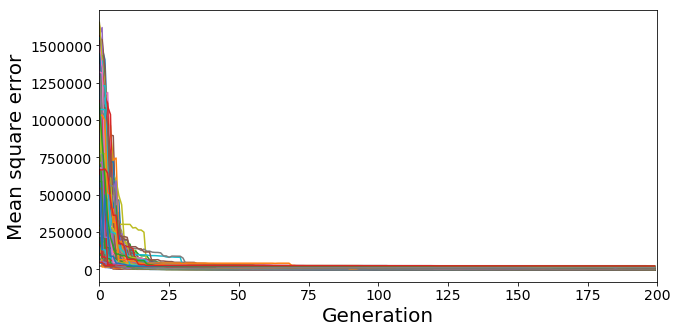

In [2]:
################################################################
# Loads the data.
# Data are located @ /Users/mikepab/Dropbox/jeff_mike/phd_pde/ML-RDE-phagosynapse/171020/171020_0-1_100g50i10m50c/
################################################################

arr_best_scores, arr_end_scores, arr_best_inds =\
load_data('/Volumes/med/Elston Lab/MikePablo/20181010 - satadrive backup/20181005_try4_EAdata/181006_eta_200g200i10m50c/',10000000)
#load_data('/Volumes/SATAdrive/20181005_try4_EAdata/181006_eta_200g200i10m50c/', 10000000)
#CONVERT DATA:
from operator import itemgetter
import numpy as np
np.set_printoptions(precision=1, suppress=True)

data = sorted(zip(arr_best_scores, arr_end_scores, arr_best_inds), key=itemgetter(1))

#MSE PLOT    
import matplotlib.pyplot as plt
%matplotlib inline

gen = 200
fig = plt.figure(figsize=(10,5))

for i in range(len(data)):
    #data[i][0][gen] = arr_best_scores
    #data[i][1] = arr_end_scores
    #data[i][2][gen] = arr_best_inds

    #plot2: MSE vs generations     
    plt.xlabel('Generation', fontsize=20)
    plt.ylabel('Mean square error', fontsize=20)
    plt.xlim([0,200])
    #plt.ylim([0,1000])
    #plt.ylim([0,1500])
    plt.plot([x for x in range(gen)], data[i][0][:gen])
    plt.tick_params(axis='both',which='major',labelsize=14)
    #print(np.shape(data[i][0]))
    
    maxval = len(data[i][2])-1
#plt.savefig(figsavedir+'/MSE_timecourse.tif',dpi=300,bbox_inches='tight')

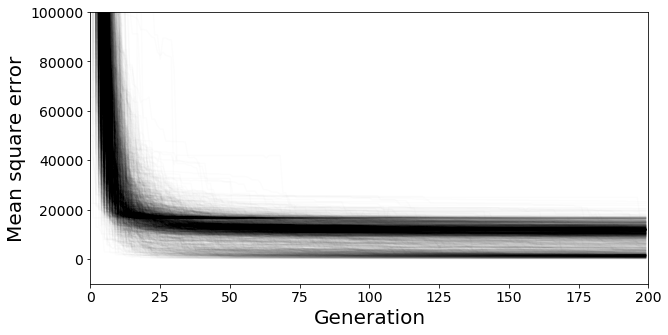

In [5]:
fig = plt.figure(figsize=(10,5))

for i in range(len(data)):
    #data[i][0][gen] = arr_best_scores
    #data[i][1] = arr_end_scores
    #data[i][2][gen] = arr_best_inds

    #plot2: MSE vs generations     
    plt.xlabel('Generation', fontsize=20)
    plt.ylabel('Mean square error', fontsize=20)
    plt.xlim([0,200])
    #plt.ylim([0,1000])
    plt.ylim([-10000,100000])
    plt.plot([x for x in range(gen)], data[i][0][:gen],alpha=0.01,color='k')
    plt.tick_params(axis='both',which='major',labelsize=14)
    #print(np.shape(data[i][0]))
    
    maxval = len(data[i][2])-1
#plt.savefig(figsavedir+'/MSE_timecourse.tif',dpi=300,bbox_inches='tight')

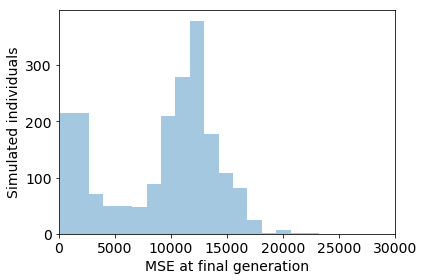

In [7]:
import seaborn as sns 
endscore = [x[1] for x in data]
sns.distplot(endscore,kde=False)
plt.xlabel('MSE at final generation',fontsize=14)
plt.ylabel('Simulated individuals',fontsize=14)
plt.xlim(0,30000)
plt.tick_params(axis='both',which='major',labelsize=14)
#plt.savefig(figsavedir+'/MSE_finalgen.tif',dpi=300,bbox_inches='tight')
plt.tight_layout()
plt.show()

# Analysis of lifetime results

## High-scoring dox-dependence

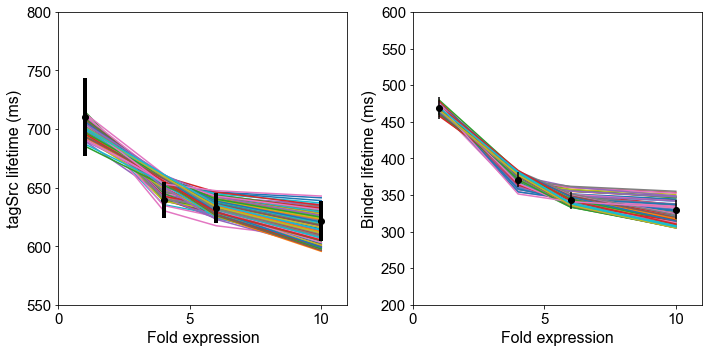

In [14]:
from scipy.integrate import odeint

np.set_printoptions(precision=1)
#plt.figure(figsize=(14,5))
fig,ax=plt.subplots(1,2)
fig.set_figheight(5)
fig.set_figwidth(10)
for i in range(0,200):
    #print(i,data[i][1],data[i][2][200])
    tsL,bL=sim(data[i][2][-1],False)
    ax[0].plot([1,4,6,10],tsL)
    ax[1].plot([1,4,6,10],bL)

ax[0].set_xlabel('Fold expression',fontsize=16,fontname='arial')
ax[0].set_ylabel('tagSrc lifetime (ms)',fontsize=16,fontname='arial')
ax[1].set_xlabel('Fold expression',fontsize=16,fontname='arial')
ax[1].set_ylabel('Binder lifetime (ms)',fontsize=16,fontname='arial')

ax[0].tick_params(axis='both',which='major',labelsize=15)
ax[1].tick_params(axis='both',which='major',labelsize=15)

ax[0].set_ylim((550,800))
ax[1].set_ylim((200,600))
ax[0].set_xticks((0,5,10))
ax[1].set_xticks((0,5,10))
ax[0].set_xlim(0,11)
ax[1].set_xlim(0,11)


import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42



for tick in ax[0].get_xticklabels():
    tick.set_fontname('arial')
for tick in ax[0].get_yticklabels():
    tick.set_fontname('arial')
for tick in ax[1].get_xticklabels():
    tick.set_fontname('arial')
for tick in ax[1].get_yticklabels():
    tick.set_fontname('arial')


ax[0].errorbar([1,4,6,10],[710.4,639.5,632.4,621.8],[33,15,13,17],marker='o',mfc='k',
            mec='k',linestyle='none',color='k',zorder=1000,elinewidth=4)


ax[1].errorbar([1,4,6,10],[469,371,343,330],[14.8,10.6,11.6,12.5],marker='o',mfc='k',
            mec='k',linestyle='none',color='k',zorder=1000)


plt.tight_layout()

#plt.savefig('/Volumes/SATAdrive/20180912/180919/model_curves.tif',dpi=300)

#plt.tick_params(axis='both',which='major',labelsize=14)
plt.savefig(figsavedir+'/lifetime_vs_expression_top200.tif',dpi=300,bbox_inches='tight',transparent=True)
plt.savefig(figsavedir+'/lifetime_vs_expression_top200.pdf',dpi=300,bbox_inches='tight',transparent=True)
plt.show()

### GIF version (fitting + MSE)

In [ ]:
# For comparison: static "final generation" version

gen = 200
fig,ax1 = plt.subplots(figsize=(12,7))

left,bottom,width,height = [0.35,0.48,0.2,0.35]
axInset1=fig.add_axes([left,bottom,width,height])
axInset2=fig.add_axes([left+.3,bottom,width,height])

for i in range(len(data)):
    #data[i][0][gen] = arr_best_scores
    #data[i][1] = arr_end_scores
    #data[i][2][gen] = arr_best_inds

    #plot2: MSE vs generations     
    ax1.set_xlabel('Generation', fontsize=20)
    ax1.set_ylabel('Mean square error', fontsize=20)
    ax1.set_xlim([0,200])
    #plt.ylim([0,1000])
    #plt.ylim([0,1500])
    ax1.set_ylim([-10000,100000])
    ax1.plot([x for x in range(gen)], data[i][0][:gen],alpha=0.01,color='k')
    ax1.tick_params(axis='both',which='major',labelsize=14)
    #print(np.shape(data[i][0]))
    
    maxval = len(data[i][2])-1
    
axInset1.plot()
    
    
for i in range(0,200):
    #print(i,data[i][1],data[i][2][200])
    tsL,bL=sim(data[i][2][-1],False)
    axInset1.plot([1,4,6,10],tsL)
    axInset2.plot([1,4,6,10],bL)

axInset1.set_xlabel('Fold expression',fontsize=16)
axInset1.set_ylabel('tagSrc lifetime (ms)',fontsize=16)
axInset2.set_xlabel('Fold expression',fontsize=16)
axInset2.set_ylabel('Binder lifetime (ms)',fontsize=16)

axInset1.tick_params(axis='both',which='major',labelsize=15)
axInset2.tick_params(axis='both',which='major',labelsize=15)

axInset1.set_ylim((550,800))
axInset2.set_ylim((200,600))
axInset1.set_xticks((0,5,10))
axInset2.set_xticks((0,5,10))
axInset1.set_xlim(0,11)
axInset2.set_xlim(0,11)



axInset1.errorbar([1,4,6,10],[710.4,639.5,632.4,621.8],[33,15,13,17],marker='o',mfc='k',
            mec='k',linestyle='none',color='k',zorder=1000,elinewidth=4)

axInset2.errorbar([1,4,6,10],[469,371,343,330],[14.8,10.6,11.6,12.5],marker='o',mfc='k',
            mec='k',linestyle='none',color='k',zorder=1000)

plt.show()

Constructing individual plots
	On file 190110/figs//wqbio_tmp/wqbio_EAgen000
	On file 190110/figs//wqbio_tmp/wqbio_EAgen001
	On file 190110/figs//wqbio_tmp/wqbio_EAgen002
	On file 190110/figs//wqbio_tmp/wqbio_EAgen003
	On file 190110/figs//wqbio_tmp/wqbio_EAgen004
	On file 190110/figs//wqbio_tmp/wqbio_EAgen005
	On file 190110/figs//wqbio_tmp/wqbio_EAgen006
	On file 190110/figs//wqbio_tmp/wqbio_EAgen007
	On file 190110/figs//wqbio_tmp/wqbio_EAgen008
	On file 190110/figs//wqbio_tmp/wqbio_EAgen009
	On file 190110/figs//wqbio_tmp/wqbio_EAgen010
	On file 190110/figs//wqbio_tmp/wqbio_EAgen011
	On file 190110/figs//wqbio_tmp/wqbio_EAgen012
	On file 190110/figs//wqbio_tmp/wqbio_EAgen013
	On file 190110/figs//wqbio_tmp/wqbio_EAgen014
	On file 190110/figs//wqbio_tmp/wqbio_EAgen015
	On file 190110/figs//wqbio_tmp/wqbio_EAgen016
	On file 190110/figs//wqbio_tmp/wqbio_EAgen020
	On file 190110/figs//wqbio_tmp/wqbio_EAgen024
	On file 190110/figs//wqbio_tmp/wqbio_EAgen028
	On file 190110/figs//wqbio_tm

FileNotFoundError: [Errno 2] No such file or directory: '190110/figs//wqbio_tmp/wqbio_EAgen001'

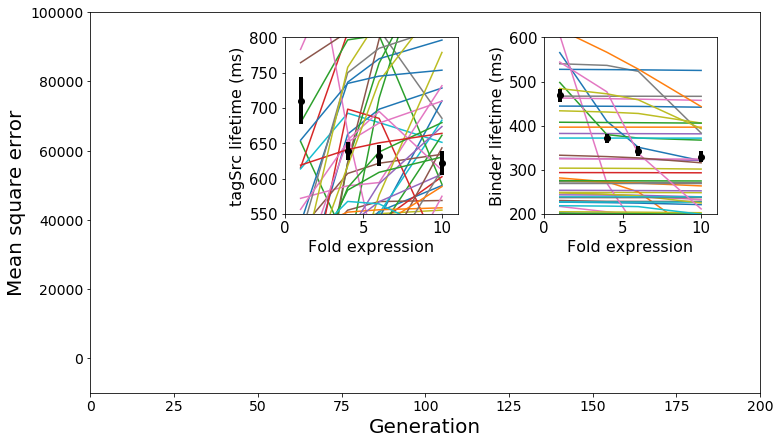

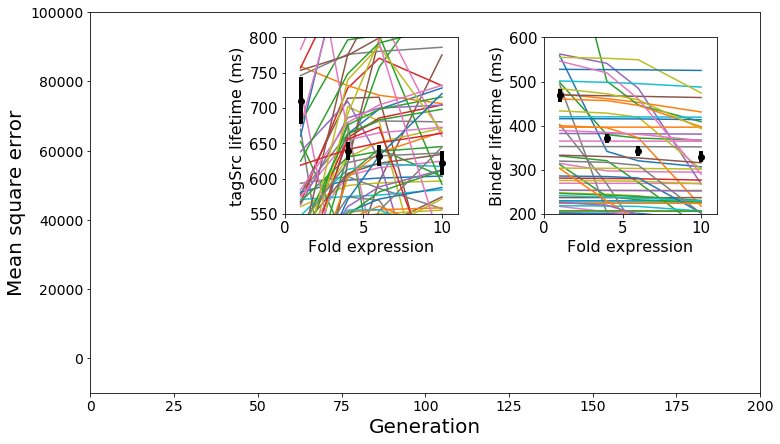

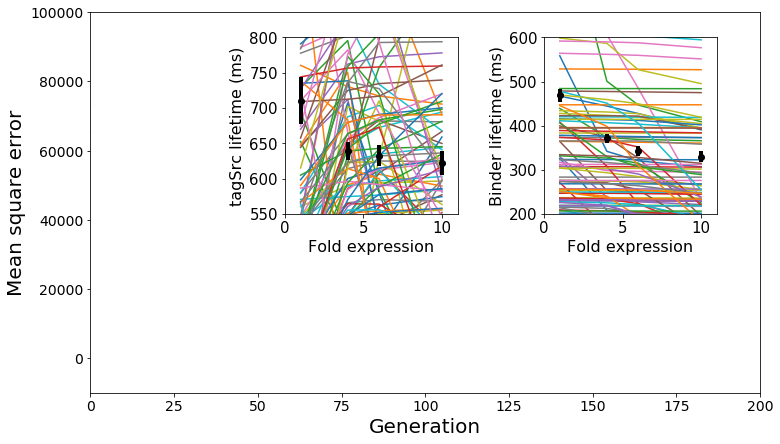

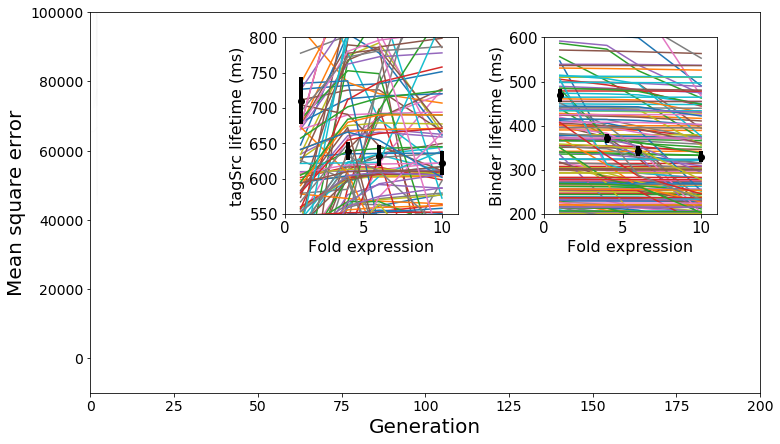

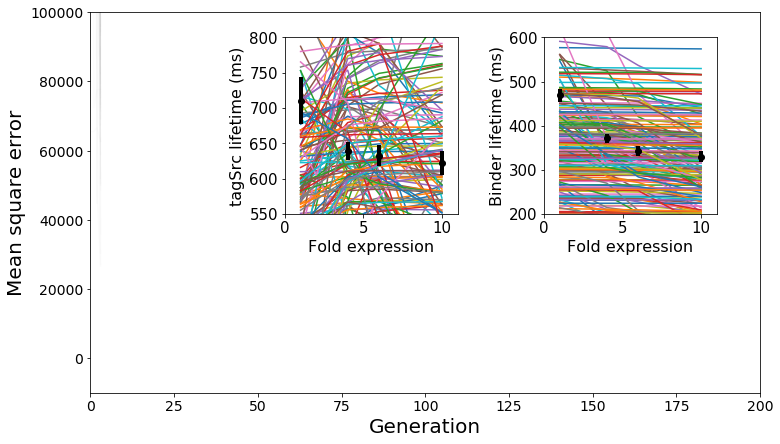

...

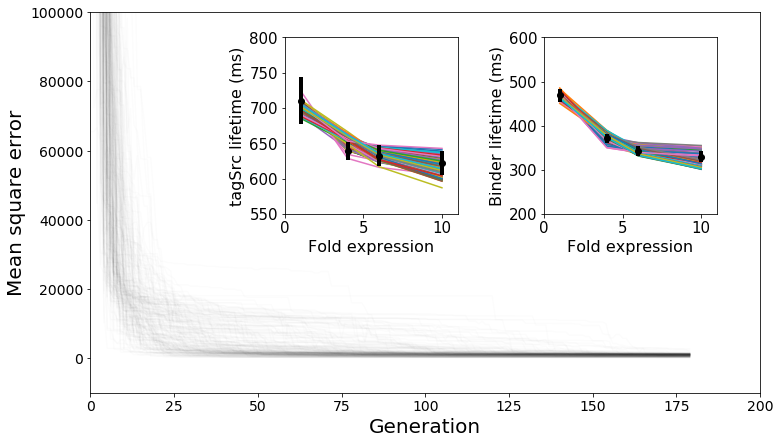

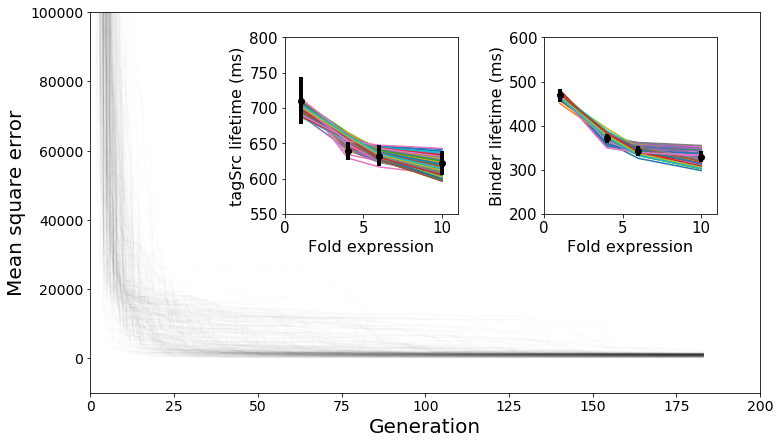

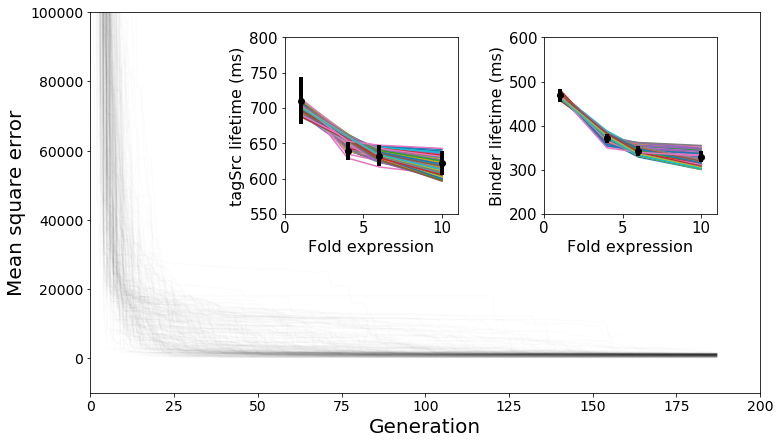

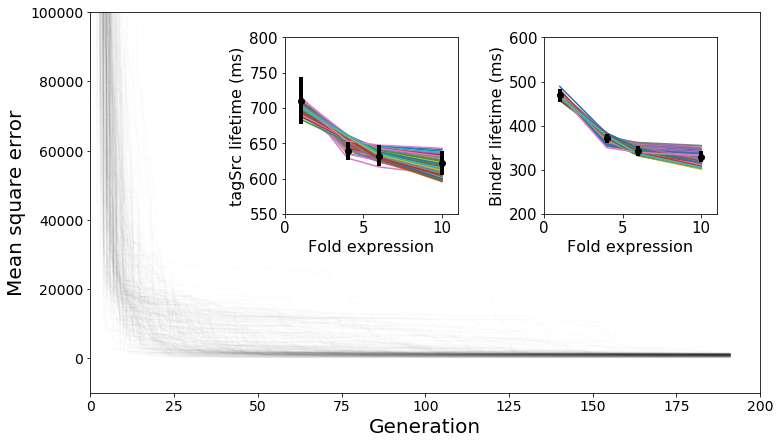

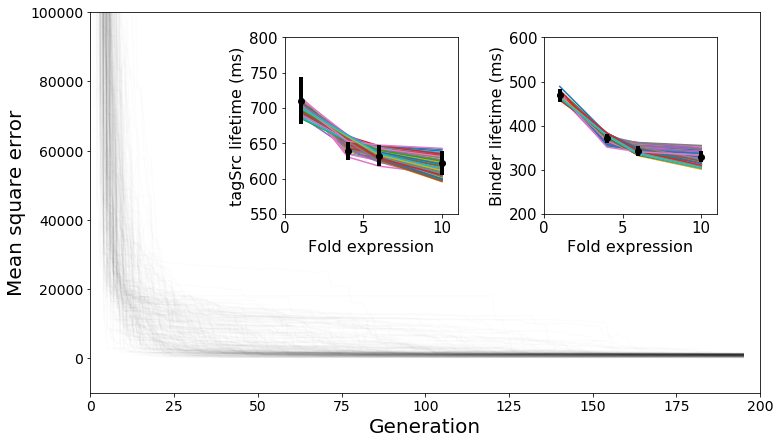

In [79]:
# Create moving GIF

def make_figure(data,gen,savename):
    #gen = 200
    fig,ax1 = plt.subplots(figsize=(12,7))

    left,bottom,width,height = [0.35,0.48,0.2,0.35]
    axInset1=fig.add_axes([left,bottom,width,height])
    axInset2=fig.add_axes([left+.3,bottom,width,height])

    for i in range(len(data)):
        #data[i][0][gen] = arr_best_scores
        #data[i][1] = arr_end_scores
        #data[i][2][gen] = arr_best_inds

        #plot2: MSE vs generations     
        ax1.set_xlabel('Generation', fontsize=20)
        ax1.set_ylabel('Mean square error', fontsize=20)
        ax1.set_xlim([0,200])
        #plt.ylim([0,1000])
        #plt.ylim([0,1500])
        ax1.set_ylim([-10000,100000])
        ax1.plot([x for x in range(gen)], data[i][0][:gen],alpha=0.01,color='k')
        ax1.tick_params(axis='both',which='major',labelsize=14)
        #print(np.shape(data[i][0]))

        #print(range(gen))
        #print(data[i][0][:gen])

    #axInset1.plot()
    for i in range(0,200):
        #print(i,data[i][1],data[i][2][200])
        tsL,bL=sim(data[i][2][gen],False)
        axInset1.plot([1,4,6,10],tsL)
        axInset2.plot([1,4,6,10],bL)

        
        
    axInset1.set_xlabel('Fold expression',fontsize=16)
    axInset1.set_ylabel('tagSrc lifetime (ms)',fontsize=16)
    axInset2.set_xlabel('Fold expression',fontsize=16)
    axInset2.set_ylabel('Binder lifetime (ms)',fontsize=16)

    axInset1.tick_params(axis='both',which='major',labelsize=15)
    axInset2.tick_params(axis='both',which='major',labelsize=15)

    axInset1.set_ylim((550,800))
    axInset2.set_ylim((200,600))
    axInset1.set_xticks((0,5,10))
    axInset2.set_xticks((0,5,10))
    axInset1.set_xlim(0,11)
    axInset2.set_xlim(0,11)

    # 13<->15?
    axInset1.errorbar([1,4,6,10],[710.4,639.5,632.4,621.8],[33,13,15,17],marker='o',mfc='k',
                mec='k',linestyle='none',color='k',zorder=1000,elinewidth=4)

    axInset2.errorbar([1,4,6,10],[469,371,343,330],[14.8,10.6,11.6,12.5],marker='o',mfc='k',
                mec='k',linestyle='none',color='k',zorder=1000,elinewidth=4)
    
    
    plt.savefig(savename+'.png',dpi=200)


# <CREATE INDEPENDENT FILES WITHIN A TMP FILE>
import os, errno
tmp_figsavedir = figsavedir+'/wqbio_tmp/'
try:
    os.makedirs(tmp_figsavedir)
except OSError as e:
    if e.errno != errno.EEXIST:
        raise

imagenames = []
        
print('Constructing individual plots')
for i in range(0,16,1):
    imagenames.append(tmp_figsavedir+'wqbio_EAgen%03d'%i)
    
    print('\tOn file',tmp_figsavedir+'wqbio_EAgen%03d'%i)
    make_figure(data,i,tmp_figsavedir+'wqbio_EAgen%03d'%i)

for i in range(16,200,4):
    imagenames.append(tmp_figsavedir+'wqbio_EAgen%03d'%i)
    
    print('\tOn file',tmp_figsavedir+'wqbio_EAgen%03d'%i)
    make_figure(data,i,tmp_figsavedir+'wqbio_EAgen%03d'%i)


# <CREATE GIF>
print('Constructing gif')
imagenames = imagenames[1:]
import imageio
images =[]
for fname in imagenames:
    print('\tOn file',fname)
    images.append(imageio.imread(fname+'.png'))
imageio.mimsave(tmp_figsavedir+'wqbio_EAgenMOVIE.gif',images)

# <CLEAN UP TMP FILE>
print('Cleaning up...')
import os
for fname in imagenames:
    os.remove(fname)



### GIF version (params)

In [3]:
# Get the parameter data into a plottable format
import pandas as pd
import seaborn as sns
from matplotlib import gridspec
def convert_uM_to_particles(conc,vol):
    return conc*602*vol

def convert_1stOrder_to_s(k):
    return k*1000

def convert_2ndOrder_to_uM_s(k):
    return k*1000

def get_param_dataframes(data,gen):
    data = data[:200] 

    test=[x[2][gen] for x in data]
    df = pd.DataFrame(test,columns=('k1','k2','k3','k4','k5','k7','k8','k9','k10','tagSrc_base_conc','binder_base_conc','anchor_conc'))
    melt_df = pd.melt(df)
    k_1storder = melt_df.loc[melt_df['variable'].isin(['k1','k2','k3','k4','k5','k8','k10'])]
    k_2ndorder = melt_df.loc[melt_df['variable'].isin(['k7','k9'])]
    k_concs = melt_df.loc[melt_df['variable'].isin(['tagSrc_base_conc','binder_base_conc','anchor_conc'])]

    # This emits a SettingWithCopyWarning, but by assigning the result of *.transform I get around it (I think)
    k_1storder['value'] = k_1storder['value'].transform(lambda x: convert_1stOrder_to_s(x))
    k_2ndorder['value'] = k_2ndorder['value'].transform(lambda x: convert_2ndOrder_to_uM_s(x))
    ts_abundance = k_concs[k_concs.variable=='tagSrc_base_conc']['value'].transform(lambda x: convert_uM_to_particles(x,2000))
    ts_abundance = [x for x in ts_abundance]
    bin_abundance = k_concs[k_concs.variable=='binder_base_conc']['value'].transform(lambda x: convert_uM_to_particles(x,2000))
    bin_abundance = [x for x in bin_abundance]
    anc_abundance = k_concs[k_concs.variable=='anchor_conc']['value'].transform(lambda x: convert_uM_to_particles(x,2000*0.04))
    anc_abundance = [x for x in anc_abundance]
    abund = pd.DataFrame(np.transpose([ts_abundance,bin_abundance,anc_abundance]),columns=('nTagSrc','nBinder','nAnchor'))
    abund = pd.melt(abund)
    
    return k_1storder,k_2ndorder,abund

# Create moving GIF

def make_figure(k_1storder,k_2ndorder,abund,gen,savename):
    #gen = 200
    plt.figure(figsize=(16,6))
    gs = gridspec.GridSpec(1, 3, width_ratios=[7,2,3]) 
    plt.subplot(gs[0])
    plt.tick_params(axis='both',which='major',labelsize=16)
    sns.swarmplot(x=k_1storder["variable"],y=k_1storder["value"])
    plt.ylabel('Reaction rate (s$^{-1}$)',fontsize=20)
    plt.xticks(rotation=30)
    plt.xlabel('')
    plt.title('1$^\degree$ rxns (generation' + '%03d)'%gen ,fontsize=16)
    plt.ylim((-6,106))
    plt.subplot(gs[1])
    plt.tick_params(axis='both',which='major',labelsize=14)
    sns.swarmplot(x=k_2ndorder["variable"],y=k_2ndorder["value"])
    plt.ylabel('Reaction rate ($\mu$M$^{-1}$s$^{-1}$)',fontsize=20)
    plt.xticks(rotation=30)
    plt.xlabel('')
    plt.title('2$^\degree$ rxns',fontsize=16)
    plt.ylim((-60,1060))
    plt.subplot(gs[2])
    plt.tick_params(axis='both',which='major',labelsize=14)
    sns.swarmplot(x=abund["variable"],y=abund["value"])
    plt.ylabel('# molecules at 1-fold expr.',fontsize=20)
    plt.xticks(rotation=30)
    plt.xticks((0,1,2),('tagSrc','Binder','Anchor'))
    plt.title('Abundances',fontsize=16)
    plt.ylim((-250000, 5000000))
    plt.xlabel('')
    
    plt.tight_layout()
    
    plt.savefig(savename+'.png',dpi=200)

Constructing individual plots
	On file 190110/figs//tmp_param/param_EAgen000


/Users/mikepab/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/Users/mikepab/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


	On file 190110/figs//tmp_param/param_EAgen001
	On file 190110/figs//tmp_param/param_EAgen002
	On file 190110/figs//tmp_param/param_EAgen003
	On file 190110/figs//tmp_param/param_EAgen004
	On file 190110/figs//tmp_param/param_EAgen005
	On file 190110/figs//tmp_param/param_EAgen006
	On file 190110/figs//tmp_param/param_EAgen007
	On file 190110/figs//tmp_param/param_EAgen008
	On file 190110/figs//tmp_param/param_EAgen009
	On file 190110/figs//tmp_param/param_EAgen010
	On file 190110/figs//tmp_param/param_EAgen011
	On file 190110/figs//tmp_param/param_EAgen012
	On file 190110/figs//tmp_param/param_EAgen013
	On file 190110/figs//tmp_param/param_EAgen014
	On file 190110/figs//tmp_param/param_EAgen015
	On file 190110/figs//tmp_param/param_EAgen016
	On file 190110/figs//tmp_param/param_EAgen020
	On file 190110/figs//tmp_param/param_EAgen024
	On file 190110/figs//tmp_param/param_EAgen028
	On file 190110/figs//tmp_param/param_EAgen032
	On file 190110/figs//tmp_param/param_EAgen036
	On file 1901

FileNotFoundError: [Errno 2] No such file or directory: '190110/figs//tmp_param/param_EAgen001'

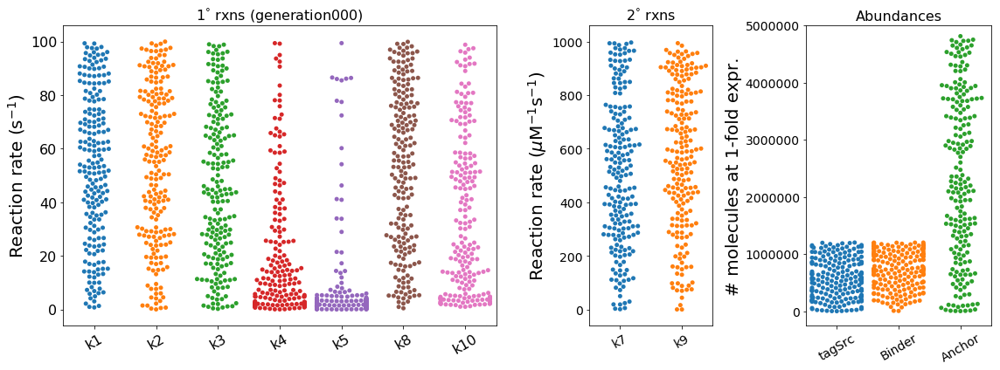

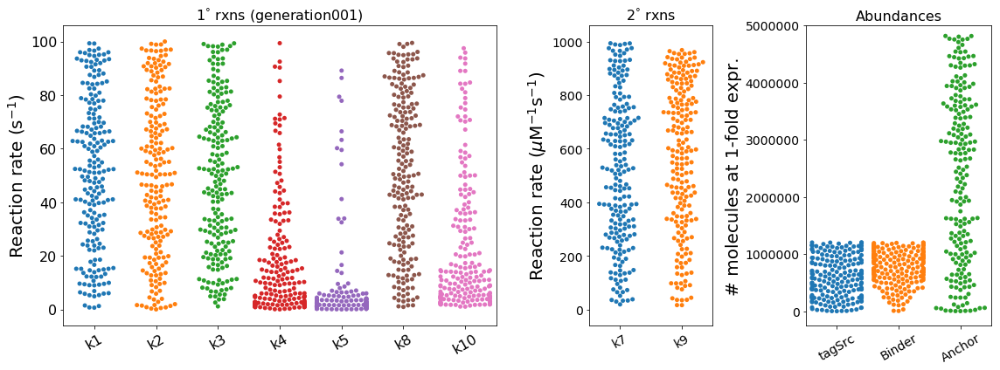

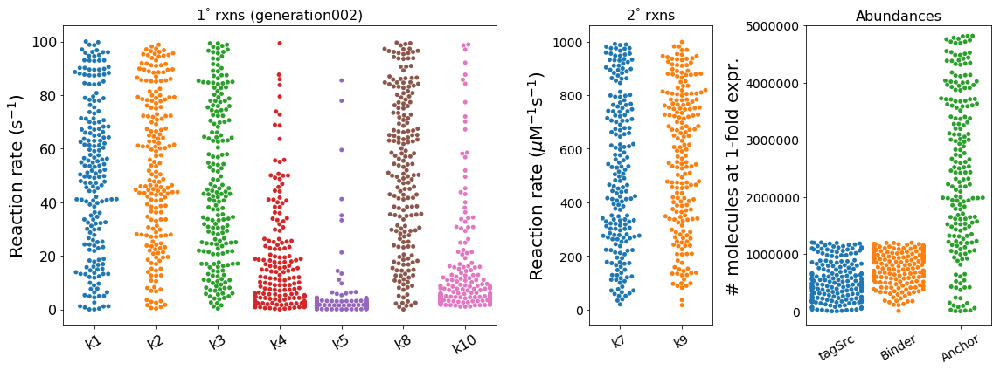

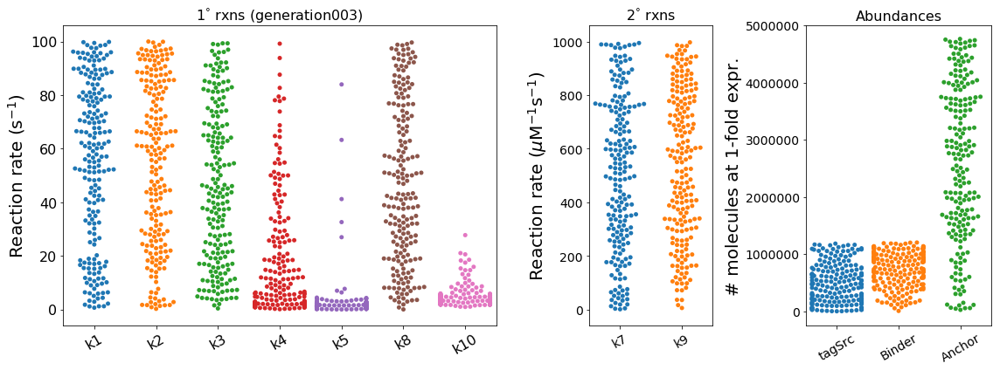

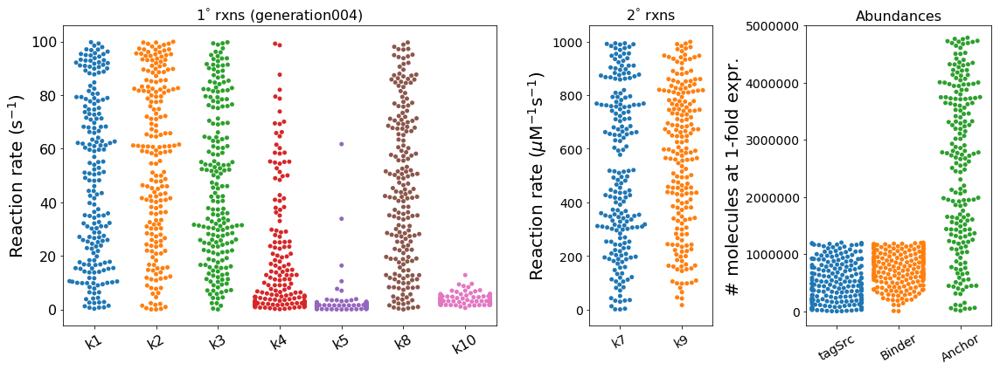

...

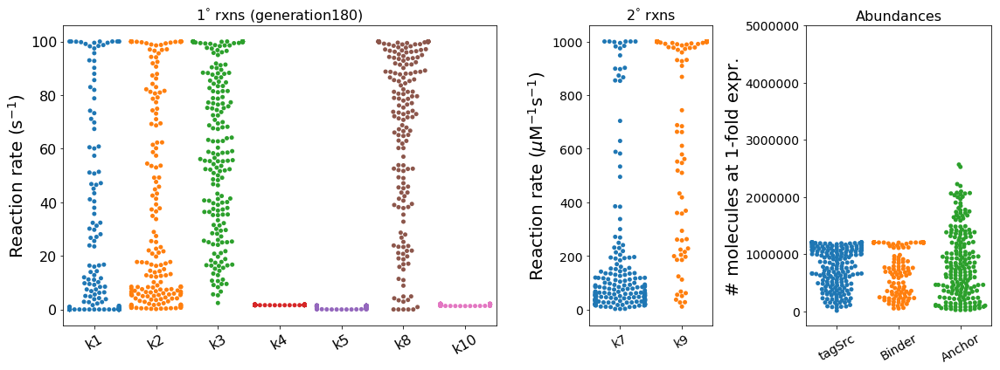

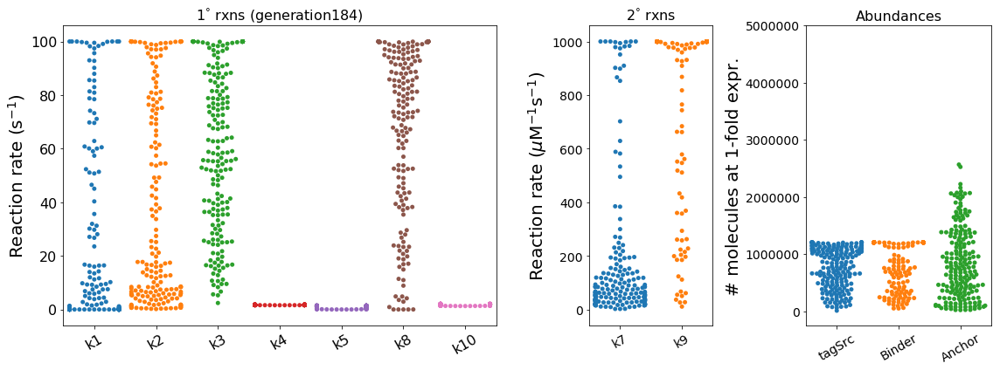

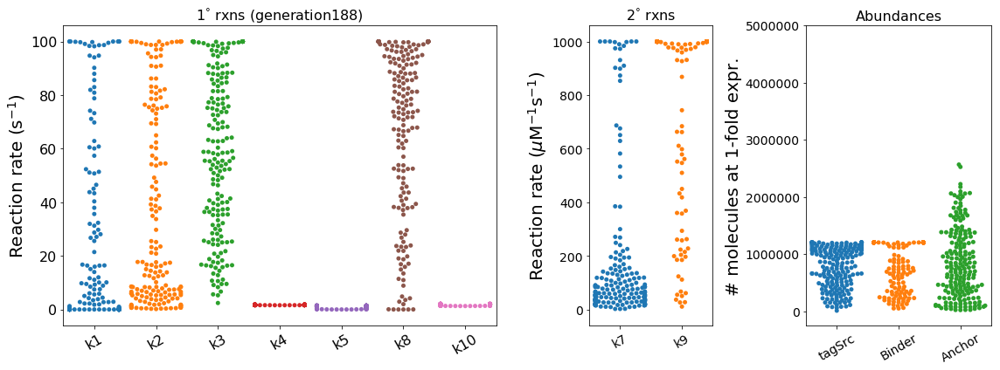

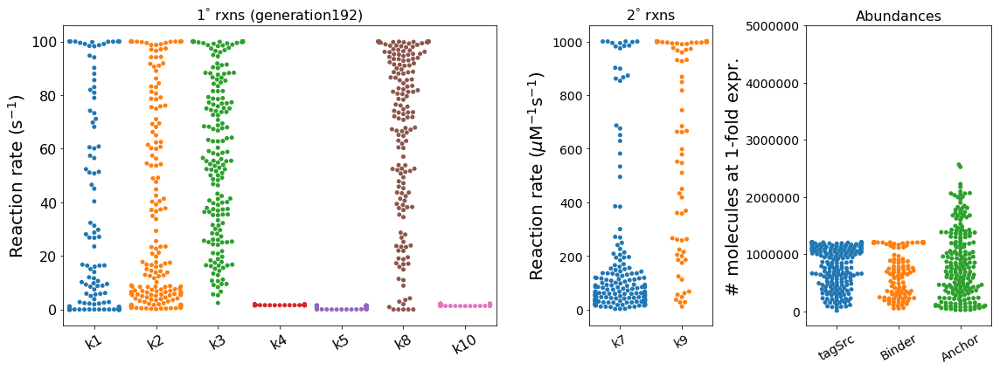

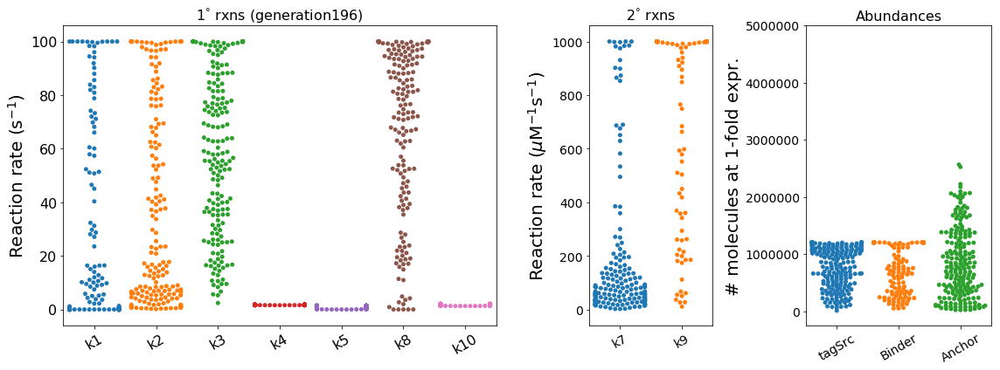

In [78]:
# <CREATE INDEPENDENT FILES WITHIN A TMP FILE>
import os, errno
tmp_figsavedir = figsavedir+'/tmp_param/'
try:
    os.makedirs(tmp_figsavedir)
except OSError as e:
    if e.errno != errno.EEXIST:
        raise

imagenames = []
        
print('Constructing individual plots')
# 
for i in range(0,16,1):
    imagenames.append(tmp_figsavedir+'param_EAgen%03d'%i)
    
    print('\tOn file',tmp_figsavedir+'param_EAgen%03d'%i)
    
    k1st,k2nd,abund = get_param_dataframes(data,i)
    
    make_figure(k1st,k2nd,abund,i,tmp_figsavedir+'param_EAgen%03d'%i)
for i in range(16,200,4):
    imagenames.append(tmp_figsavedir+'param_EAgen%03d'%i)
    
    print('\tOn file',tmp_figsavedir+'param_EAgen%03d'%i)
    
    k1st,k2nd,abund = get_param_dataframes(data,i)
    
    make_figure(k1st,k2nd,abund,i,tmp_figsavedir+'param_EAgen%03d'%i)

# <CREATE GIF>
print('Constructing gif')
imagenames = imagenames[1:]
import imageio
images =[]
for fname in imagenames:
    print('\tOn file',fname)
    images.append(imageio.imread(fname+'.png'))
imageio.mimsave(tmp_figsavedir+'param_EAgenMOVIE.gif',images)

# <CLEAN UP TMP FILE>
print('Cleaning up...')
import os
for fname in imagenames:
    os.remove(fname)

/Users/mikepab/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/Users/mikepab/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


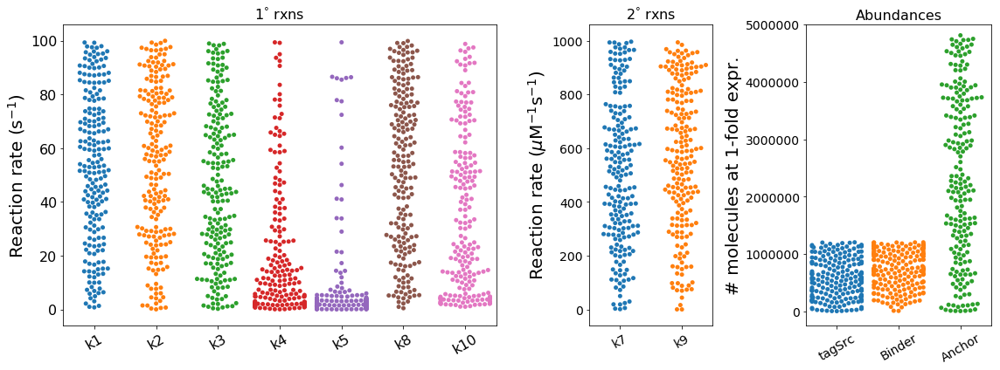

In [75]:
k1st,k2nd,abund = get_param_dataframes(data,0)
make_figure(k1st,k2nd,abund,'test')

## Parameter analysis

### Anchor molecules become saturated by tagSrc

In [4]:
def convert_uM_to_particles(conc,vol):
    return conc*602*vol

def convert_1stOrder_to_s(k):
    return k*1000

def convert_2ndOrder_to_uM_s(k):
    return k*1000

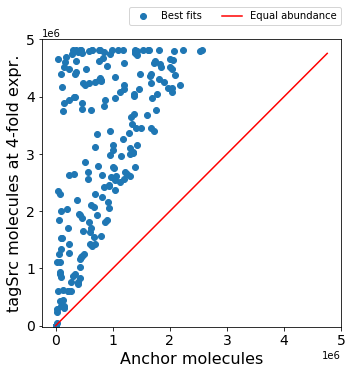

In [6]:
ts_abund_HIGH = np.zeros(len(data))
anc_abund_HIGH = np.zeros(len(data))
ts_abund_LOW = np.zeros(len(data))
anc_abund_LOW = np.zeros(len(data))


for i in range(0,200):
    curr_data = data[i]
    ts_abund_HIGH[i] = convert_uM_to_particles(curr_data[2][-1][-3],2000)
    anc_abund_HIGH[i] = convert_uM_to_particles(curr_data[2][-1][-1],0.04*2000)

for i in range(0,200):
    curr_data = data[-i]
    ts_abund_LOW[i] = convert_uM_to_particles(curr_data[2][0][-3],2000)
    anc_abund_LOW[i] = convert_uM_to_particles(curr_data[2][0][-1],0.04*2000)

   
plt.figure(figsize=(5,5))
mn = min(min(anc_abund_HIGH),min(ts_abund_HIGH),min(anc_abund_LOW),min(ts_abund_LOW))
mx = max(max(anc_abund_HIGH),max(ts_abund_HIGH),max(anc_abund_LOW),max(ts_abund_LOW))

plt.plot(anc_abund_HIGH,ts_abund_HIGH*4,marker='o',linestyle='none',label="Best fits")
#plt.plot(anc_abund_LOW,ts_abund_LOW*4,marker='o',markeredgecolor='gray',markerfacecolor='none',linestyle='none',label="Worst fits")
plt.xlabel('Anchor molecules',fontsize=16)
plt.ylabel('tagSrc molecules at 4-fold expr.',fontsize=16)
plt.tick_params(axis='both',which='major',labelsize=14)
plt.plot([mn,mx],[mn,mx],color='red',label='Equal abundance')
plt.ylim((-20000,2*2500000))
plt.ticklabel_format(style='sci',axis='both',scilimits=(0,0),fontsize=20)
#plt.legend(,loc=4)
plt.legend(bbox_to_anchor=(0., 1.05, 1., .102), loc=4,
           ncol=2, borderaxespad=0.)
plt.tight_layout()
plt.savefig(figsavedir+'/anchor_saturation_v3.png',dpi=300,bbox_inches='tight')
plt.savefig(figsavedir+'/anchor_saturation_v3.svg',bbox_inches='tight')
plt.show()

### Formatting results into a Pandas DataFrame

In [6]:
import pandas as pd
import seaborn as sns

data = data[:200] 

test=[x[2][-1] for x in data]
df = pd.DataFrame(test,columns=('k1','k2','k3','k4','k5','k7','k8','k9','k10','tagSrc_base_conc','binder_base_conc','anchor_conc'))
melt_df = pd.melt(df)
k_1storder = melt_df.loc[melt_df['variable'].isin(['k1','k2','k3','k4','k5','k8','k10'])]
k_2ndorder = melt_df.loc[melt_df['variable'].isin(['k7','k9'])]
k_concs = melt_df.loc[melt_df['variable'].isin(['tagSrc_base_conc','binder_base_conc','anchor_conc'])]

# This emits a SettingWithCopyWarning, but by assigning the result of *.transform I get around it (I think)
k_1storder['value'] = k_1storder['value'].transform(lambda x: convert_1stOrder_to_s(x))
k_2ndorder['value'] = k_2ndorder['value'].transform(lambda x: convert_2ndOrder_to_uM_s(x))
ts_abundance = k_concs[k_concs.variable=='tagSrc_base_conc']['value'].transform(lambda x: convert_uM_to_particles(x,2000))
ts_abundance = [x for x in ts_abundance]
bin_abundance = k_concs[k_concs.variable=='binder_base_conc']['value'].transform(lambda x: convert_uM_to_particles(x,2000))
bin_abundance = [x for x in bin_abundance]
anc_abundance = k_concs[k_concs.variable=='anchor_conc']['value'].transform(lambda x: convert_uM_to_particles(x,2000*0.04))
anc_abundance = [x for x in anc_abundance]
abund = pd.DataFrame(np.transpose([ts_abundance,bin_abundance,anc_abundance]),columns=('nTagSrc','nBinder','nAnchor'))
abund = pd.melt(abund)

/Users/mikepab/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
/Users/mikepab/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


In [24]:
df

,k1,k2,k3,k4,k5,k7,k8,k9,k10,tagSrc_base_conc,binder_base_conc,anchor_conc
0,3.674497e-04,0.005586,0.005640,0.001688,1.146930e-03,0.271039,9.523565e-02,0.260714,0.001625,0.477056,0.999999,1.527136
1,1.597670e-02,0.036589,0.019676,0.001655,3.029194e-04,0.383479,1.000000e-01,0.184821,0.001543,0.317780,0.076369,2.302266
2,9.834072e-02,0.039198,0.099833,0.001692,1.779051e-07,0.022951,4.362420e-02,0.998305,0.001779,0.943119,0.177386,18.618887
3,8.088926e-02,0.049180,0.052339,0.001655,1.869984e-04,0.067046,9.999952e-02,0.999999,0.001663,1.000000,0.245221,13.259349
4,9.992820e-02,0.076090,0.053082,0.001692,1.214754e-03,0.074308,9.993392e-02,0.930481,0.001504,0.264337,0.408258,4.719724
5,4.277573e-04,0.001185,0.054250,0.001676,9.643044e-04,0.142615,9.999999e-02,0.991860,0.001760,0.354672,1.000000,4.474162
6,5.312057e-06,0.003880,0.016448,0.001660,1.204119e-03,0.047433,6.670729e-02,0.999972,0.001720,0.993085,0.999998,8.130394
7,4.258287e-05,0.085584,0.096482,0.001692,1.327227e-03,0.016009,7.829805e-02,0.999996,0.001725,0.840790,1.000000,28.427887
8,2.871338e-02,0.001022,0.043203,0.001724,2.617949e-04,0.628907,7.364574e-02,0.111417,0.001621,0.061827,0.295777,0.471191
9,5.670112e-08,0.029322,0.017434,0.001637,1.308385e-03,0.049900,9.948523e-02,1.000000,0.001617,0.999997,1.000000,9.273233


### Checking Binder dissociation rate

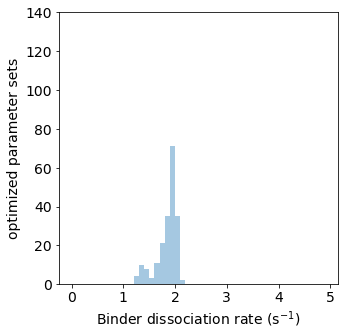

In [14]:
import seaborn as sns

fig=plt.figure(figsize=(5,5))

plt.tick_params(axis='both',which='major',labelsize=14)
sns.distplot(k_1storder[k_1storder['variable']=='k10'].value,bins=(np.arange(0.,5,.1)),kde=False)
plt.ylabel('optimized parameter sets',fontsize=14)
plt.xlabel('Binder dissociation rate (s$^{-1}$)',fontsize=14)#'k$_4$, s$^{-1}$',fontsize=14)
plt.ylim(0,140)
plt.savefig(figsavedir+'/parameter_ranges_k9.tif',dpi=300,bbox_inches='tight')
plt.savefig(figsavedir+'/parameter_ranges_k9.svg',bbox_inches='tight')
plt.show()

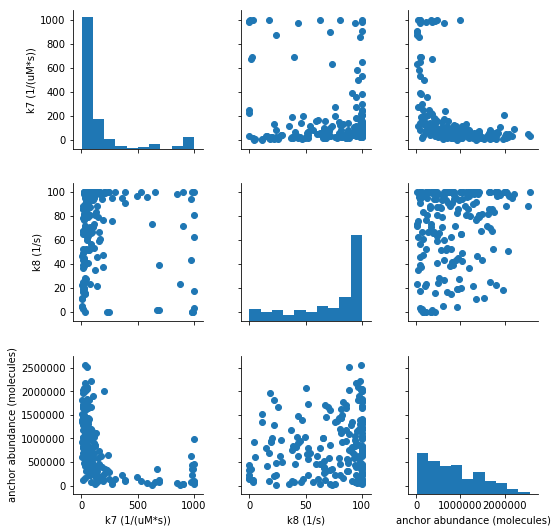

In [62]:
data = data[:200] 

test=[x[2][-1] for x in data]
df = pd.DataFrame(test,columns=('k1','k2','k3','k4','k5','k7','k8','k9','k10','tagSrc_base_conc','binder_base_conc','anchor_conc'))
melt_df = pd.melt(df)
k_1storder = melt_df.loc[melt_df['variable'].isin(['k1','k2','k3','k4','k5','k8','k10'])]
k_2ndorder = melt_df.loc[melt_df['variable'].isin(['k7','k9'])]
k_concs = melt_df.loc[melt_df['variable'].isin(['tagSrc_base_conc','binder_base_conc','anchor_conc'])]


k7 = k_2ndorder[k_2ndorder.variable=='k7']['value'].transform(lambda x: convert_2ndOrder_to_uM_s(x))
k7 = [x for x in k7]
k8 = k_1storder[k_1storder.variable=='k8']['value'].transform(lambda x: convert_1stOrder_to_s(x))
k8 = [x for x in k8]

anc_abundance = k_concs[k_concs.variable=='anchor_conc']['value'].transform(lambda x: convert_uM_to_particles(x,2000*0.04))
anc_abundance = [x for x in anc_abundance]
anchor_data = pd.DataFrame(np.transpose([k7,k8,anc_abundance]),columns=('k7 (1/(uM*s))','k8 (1/s)','anchor abundance (molecules)'))
#abund = pd.melt(abund)

g=sns.PairGrid(anchor_data)
g=g.map_offdiag(plt.scatter)
g=g.map_diag(plt.hist)

plt.savefig(figsavedir+'/anchor_affinity_vs_abundance.tif',dpi=300,bbox_inches='tight')
plt.savefig(figsavedir+'/anchor_affinity_vs_abundance.svg',bbox_inches='tight')

# for i in range(0,12):
#     g.axes[i,3].set_xlim((.0015,2./1000))
#     g.axes[i,4].set_xlim((1/1000,1.5/1000))
#     g.axes[i,8].set_xlim((1/1000,2.5/1000))
#     g.axes[3,i].set_ylim((.0015,2./1000))
#     g.axes[4,i].set_ylim((1/1000,1.5/1000))
#     g.axes[8,i].set_ylim((1/1000,2.5/1000))

6.232685264117824

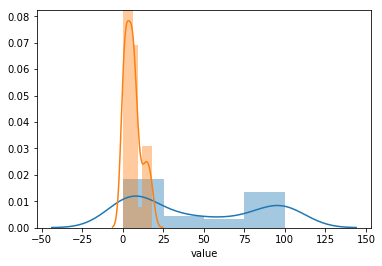

In [53]:
sns.distplot(k_1storder[k_1storder['variable']=='k2'].value)
tmp=k_1storder[k_1storder['variable']=='k2'].value
tmp2=tmp[tmp<20]
sns.distplot(tmp2)
np.mean(tmp2)



### "Anchor" function is predicted

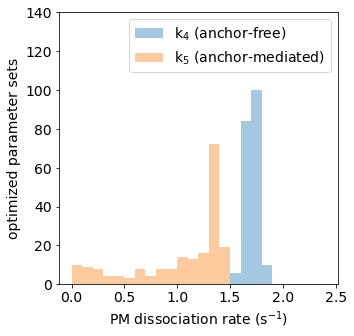

In [15]:
import seaborn as sns

fig=plt.figure(figsize=(5,5))

plt.tick_params(axis='both',which='major',labelsize=14)
sns.distplot(k_1storder[k_1storder['variable']=='k4'].value,bins=(np.arange(0.,2.5,.1)),kde=False)
sns.distplot(k_1storder[k_1storder['variable']=='k5'].value,bins=(np.arange(0.,2.5,.1)),kde=False)
plt.ylabel('optimized parameter sets',fontsize=14)
plt.xlabel('PM dissociation rate (s$^{-1}$)',fontsize=14)#'k$_4$, s$^{-1}$',fontsize=14)
plt.legend(('k$_4$ (anchor-free)','k$_5$ (anchor-mediated)'),fontsize=14)
plt.ylim(0,140)
plt.savefig(figsavedir+'/parameter_ranges_k4k5.tif',dpi=300,bbox_inches='tight')
plt.savefig(figsavedir+'/parameter_ranges_k4k5.svg',bbox_inches='tight')
plt.show()

### Estimation of tagSrc/Binder KD

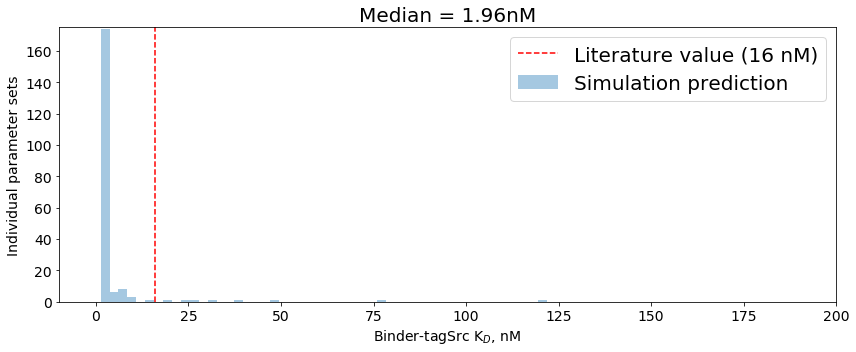

In [32]:
plt.figure(figsize=(12,5))
plt.tick_params(axis='both',which='major',labelsize=14)
KD = (np.asarray((k_1storder[k_1storder['variable']=='k10'].value))) / \
     (np.asarray((k_2ndorder[k_2ndorder['variable']=='k9'].value))) * 1000
sns.distplot(KD,kde=False)#,bins=100)
#plt.xticks(rotation=90)
plt.ylabel('Individual parameter sets',fontsize=14)
plt.xlabel('Binder-tagSrc K$_D$, nM',fontsize=14)
plt.title('Median = '+'%.2f'%(np.median(KD))+'nM',fontsize=20)
plt.plot([16,16],[0,190],'r--')
plt.xlim(-10,200)
plt.ylim(0,175)
plt.legend(('Literature value (16 nM)','Simulation prediction'),fontsize=20)
plt.tight_layout()
plt.savefig(figsavedir+'/tagSrcBinder_KD.tif',dpi=300,bbox_inches='tight')
plt.savefig(figsavedir+'/tagSrcBinder_KD.svg',bbox_inches='tight')
plt.show()

### Effective anchor KD

In [ ]:
plt.figure(figsize=(12,5))
plt.tick_params(axis='both',which='major',labelsize=14)
# (There are two off rates -- should I sum them?)
KD = (np.asarray((k_1storder[k_1storder['variable']=='k8'].value))+np.asarray(k_1storder[k_1storder['variable']=='k5'].value)) / \
     (np.asarray((k_2ndorder[k_2ndorder['variable']=='k7'].value))) *1000
sns.distplot(KD,kde=False)#,bins=100)
#plt.xticks(rotation=90)
plt.ylabel('Individual parameter sets',fontsize=14)
plt.xlabel('Anchor-tagSrc (open) K$_D$, nM',fontsize=14)
plt.title('Median = '+'%i'%(np.median(KD))+'nM',fontsize=20)
#plt.ylim([0,200])
#plt.xlim([0,500])
plt.tight_layout()
plt.savefig(figsavedir+'/anchor_KD.tif',dpi=300,bbox_inches='tight')
plt.savefig(figsavedir+'/anchor_KD.svg',bbox_inches='tight')
plt.show()

### General rate constants

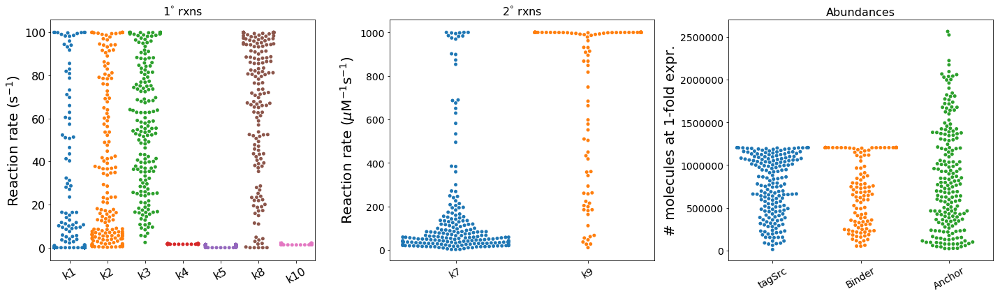

In [7]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

#print(melt_df)
plt.figure(figsize=(20,6))
plt.subplot(1,3,1)
plt.tick_params(axis='both',which='major',labelsize=16)
sns.swarmplot(x=k_1storder["variable"],y=k_1storder["value"])
plt.ylabel('Reaction rate (s$^{-1}$)',fontsize=20)
plt.xticks(rotation=30)
plt.xlabel('')
plt.title('1$^\degree$ rxns',fontsize=16)
plt.subplot(1,3,2)
plt.tick_params(axis='both',which='major',labelsize=14)
sns.swarmplot(x=k_2ndorder["variable"],y=k_2ndorder["value"])
plt.ylabel('Reaction rate ($\mu$M$^{-1}$s$^{-1}$)',fontsize=20)
plt.xticks(rotation=30)
plt.xlabel('')
plt.title('2$^\degree$ rxns',fontsize=16)
plt.subplot(1,3,3)
plt.tick_params(axis='both',which='major',labelsize=14)
sns.swarmplot(x=abund["variable"],y=abund["value"])
plt.ylabel('# molecules at 1-fold expr.',fontsize=20)
plt.xticks(rotation=30)
plt.xticks((0,1,2),('tagSrc','Binder','Anchor'))
plt.title('Abundances',fontsize=16)
plt.xlabel('')
plt.tight_layout()
plt.savefig(figsavedir+'/parameter_ranges.tif',dpi=300,bbox_inches='tight')
plt.savefig(figsavedir+'/parameter_ranges.svg',bbox_inches='tight')
plt.show()

In [30]:
k_1storder.loc[k_1storder["variable"].isin(['k4','k5','k10'])]

,variable,value
600,k4,1.687869
601,k4,1.655298
602,k4,1.691837
603,k4,1.655486
604,k4,1.691700
605,k4,1.675627
606,k4,1.659561
607,k4,1.691743
608,k4,1.723986
609,k4,1.636743


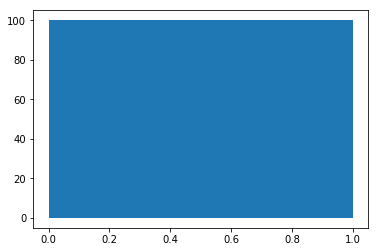

In [46]:

plt.fill_between((0,1),0,100)

[0.  0.2 0.4 0.6 0.8 1. ]


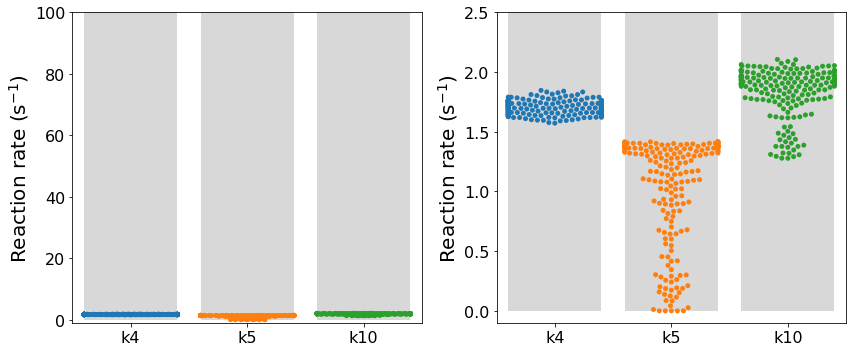

In [58]:
# Visualize k4, k5, and k10 only
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.patches as patches 
#print(melt_df)
fig,(ax1,ax2)=plt.subplots(1,2,figsize=(12,5))
plt.subplot(1,2,1)
plt.tick_params(axis='both',which='major',labelsize=16)
sns.swarmplot(x=k_1storder.loc[k_1storder["variable"].isin(['k4','k5','k10'])]["variable"],
              y=k_1storder.loc[k_1storder["variable"].isin(['k4','k5','k10'])]["value"])
plt.ylabel('Reaction rate (s$^{-1}$)',fontsize=20)
#plt.xticks(rotation=30)
plt.ylim(-1,100)
plt.xlabel('')

#rect=patches.Rectangle((1,1),10,100,edgecolor='none',facecolor='gray')
#ax1.add_patch(rect)
plt.fill_between((-.4,.4),0,100,facecolor='gray',alpha=0.3)
plt.fill_between((.6,1.4),0,100,facecolor='gray',alpha=0.3)
plt.fill_between((1.6,2.4),0,100,facecolor='gray',alpha=0.3)

plt.subplot(1,2,2)
plt.tick_params(axis='both',which='major',labelsize=16)
sns.swarmplot(x=k_1storder.loc[k_1storder["variable"].isin(['k4','k5','k10'])]["variable"],
              y=k_1storder.loc[k_1storder["variable"].isin(['k4','k5','k10'])]["value"])
plt.ylabel('Reaction rate (s$^{-1}$)',fontsize=20)
#plt.xticks(rotation=30)
plt.xlabel('')

plt.fill_between((-.4,.4),0,2.5,facecolor='gray',alpha=0.3)
plt.fill_between((.6,1.4),0,2.5,facecolor='gray',alpha=0.3)
plt.fill_between((1.6,2.4),0,2.5,facecolor='gray',alpha=0.3)
plt.ylim((-.1,2.5))


plt.tight_layout()
plt.savefig(figsavedir+'/parameter_ranges.tif',dpi=300,bbox_inches='tight')
plt.savefig(figsavedir+'/parameter_ranges.svg',bbox_inches='tight')
plt.show()

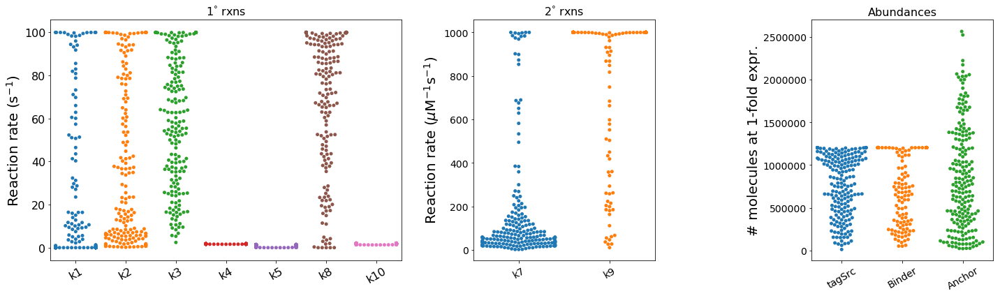

In [35]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

gridspec.GridSpec(1,12)

#print(melt_df)
fig=plt.figure(figsize=(20,6))
#plt.subplot(1,3,1)
plt.subplot2grid((1,12),(0,0),colspan=5,rowspan=1)
plt.tick_params(axis='both',which='major',labelsize=16)
sns.swarmplot(x=k_1storder["variable"],y=k_1storder["value"])#,cut=0)
plt.ylabel('Reaction rate (s$^{-1}$)',fontsize=20)
plt.xticks(rotation=30)
plt.xlabel('')
plt.title('1$^\degree$ rxns',fontsize=16)

#plt.subplot(1,3,2)
plt.subplot2grid((1,12),(0,5),colspan=3,rowspan=1)

plt.tick_params(axis='both',which='major',labelsize=14)
sns.swarmplot(x=k_2ndorder["variable"],y=k_2ndorder["value"])#,cut=0)
plt.ylabel('Reaction rate ($\mu$M$^{-1}$s$^{-1}$)',fontsize=20)
plt.xticks(rotation=30)
plt.xlabel('')
plt.title('2$^\degree$ rxns',fontsize=16)

#plt.subplot(1,3,3)
plt.subplot2grid((1,12),(0,9),colspan=4,rowspan=1)
plt.tick_params(axis='both',which='major',labelsize=14)
sns.swarmplot(x=abund["variable"],y=abund["value"])#,cut=0)
plt.ylabel('# molecules at 1-fold expr.',fontsize=20)
plt.xticks(rotation=30)
plt.xticks((0,1,2),('tagSrc','Binder','Anchor'))
plt.title('Abundances',fontsize=16)
plt.xlabel('')

fig.tight_layout()
fig.savefig(figsavedir+'/parameter_ranges.tif',dpi=300,bbox_inches='tight')
fig.savefig(figsavedir+'/parameter_ranges.svg',bbox_inches='tight')
fig.show()

### Predicted proportion of anchored tagSrc on the membrane

In [ ]:
from scipy.integrate import odeint
def get_ss(EA_param_vec,expression_level):
    # raw params, ms-1 and uM-1
    k1,k2,k3,k4,k5,k7,k8,k9,k10,tS_base,bin_base,anchor = EA_param_vec
    
    # Useful parameters
    cell_vol = 2000 # um3
    
    # Solve steady-state of system in original units, then convert to nearest particles
    # This ensures we avoid numerical issues
    y0 = np.array([tS_base*expression_level,0.,0.,0.,0.,0.,0.,0.,bin_base*expression_level,0.04*anchor])
    t = np.arange(0.,10000,.1) # run to SS.
    #k5=0.
    k6=0.
    k11=0.
    odeparams = [k1,k2,k3,k4,k5,k6,k7,k8,k9,k10,k11]
    odeSoln = odeint(ssODE,y0,t,args=(odeparams,))
    raw_ss = odeSoln[-1,:]*602
    raw_ss[0] = raw_ss[0]*cell_vol
    raw_ss[1] = raw_ss[1]*cell_vol*0.04
    raw_ss[2] = raw_ss[2]*cell_vol
    raw_ss[3] = raw_ss[3]*cell_vol*0.04
    raw_ss[4] = raw_ss[4]*cell_vol*0.04
    raw_ss[5] = raw_ss[5]*cell_vol*0.04
    raw_ss[6] = raw_ss[6]*cell_vol*0.04
    raw_ss[7] = raw_ss[7]*cell_vol
    raw_ss[8] = raw_ss[8]*cell_vol
    raw_ss[9] = raw_ss[9]*cell_vol*0.04
    
    ss_counts = [int(x) for x in raw_ss]
    return ss_counts

expr_lvl = [1,4,6,10]
data=data[:200]
inds = [x[2][-1] for x in data]
steady_states = np.zeros((len(inds),10,4))
for i in range(0,4):
    for j in range(0,len(inds)):
        steady_states[j,:,i] = get_ss(inds[j],expr_lvl[i])

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
# Checking expression level = 1, % of tagSrc in any inactive form
plt.figure(figsize=(10,3))
nBin_anc = steady_states[:,6,0]
nBin_memb = steady_states[:,4,0] + steady_states[:,6,0]
plt.hist(nBin_anc/nBin_memb*100)
plt.xlabel('Binder, anchored (% of memb-Bin)',fontsize=20)
plt.tick_params(which='both',labelsize=20)
plt.ylabel('Counts',fontsize=20)
plt.title('Median:%.1f%%'%(np.median(nBin_anc/nBin_memb*100)))
plt.xlim(0,100)
plt.show()

## Sensitivity analysis

Here, we perform 2-fold increase and decrease of each parameter value ONE-BY-ONE to examine how sensitive the model score (MSE) is with respect to perturbations. I suspect the best way to visualize the results will be the $\text{log}_2(\text{fold-change})$ relative to the original MSE of that parameter set.

### Figure subdirectory

In [2]:
import os, errno
subfigsavedir = figsavedir + '/sens/'
try:
    os.makedirs(subfigsavedir)
except OSError as e:
    if e.errno != errno.EEXIST:
        raise

### Define simulation; load parameters and MSEs

Loaded 2004 files (out of 2005) with cutoff score of 10000000


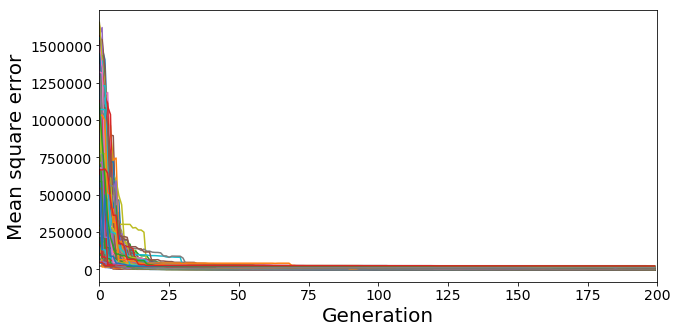

In [25]:
# Basic function for loading data

import numpy as np
import os
import pickle
import matplotlib.pyplot as plt
from scipy.integrate import odeint
%matplotlib inline

def ssODE(y,t,p):
    eta = 0.04
    A,B,C,D,E,F,G,H,I,J = y
    [k1,k2,k3,k4,k5,k6,k7,k8,k9,k10,k11]=p
    #k11=0.
    dA = -k3*A + k4*B
    dB = -(k2+k4)*B + k3*A + k1*D
    dC = -(k3+k6*J)*C + k4*D + k11*H + k5*F
    dD = -(k1+k4+k9*I+k7*J)*D + k2*B + k3*C + k10*E + k8*F
    dE = -(k10+k7*J+k4)*E + k9*I*D + k8*G + k3*H
    dF = -(k8+k9*I+k5)*F + k7*J*D + k10*G + k6*J*C
    dG = -(k8+k10+k5)*G + k7*E*J + k9*I*F +k6*J*H
    dH = -(k3+k11+k6*J)*H + k4*E + k5*G
    dI = -(k9*D+k9*F)*I + k10*(E+G) + k11*H
    dJ = -(k6*(C+H)+k7*(D+E))*J + k5*(F+G) + k8*(F+G)
        
    derivs = [dA*eta,dB,dC*eta,dD,dE,dF,dG,dH*eta,dI*eta,dJ]
    return derivs

def get_lifetime(ss,p):
    A,B,C,D,E,F,G,H,I,J = ss
    [k1,k2,k3,k4,k5,k6,k7,k8,k9,k10,k11]=p
    
    ts_flux = (B*k4 + D*k4 + E*k4 + F*k4 + F*k5 + G*k5) / (B+D+E+F+G) 
    bin_flux = (E*k10 + G*k10 + E*k4) / (E+G)
    
    ts_lifetime = 1./ts_flux
    bin_lifetime = 1./bin_flux
    
    return ts_lifetime,bin_lifetime

def sim(p,doplot):
    eta = 0.04
    # added k5 back in, which is the anchor-mediated release rate.
    k1,k2,k3,k4,k5,k7,k8,k9,k10,tS_base,bin_base,J_tot = p
    k11=0.
    #k5=0.
    k6=0.
    odeparams = [k1,k2,k3,k4,k5,k6,k7,k8,k9,k10,k11]
    
    tS_tot = tS_base * np.array((1.,4.,6.,10.))
    bin_tot = bin_base * np.array((1.,4.,6.,10.))
    
    ts_life = np.zeros(4)
    bin_life = np.zeros(4)
    
    for i in range(0,4):
        y0 = [tS_tot[i],0.,0.,0.,0.,0.,0.,0.,bin_tot[i],J_tot]
        t = np.arange(0.,1000.,.1) # run to SS.
        odeSoln = odeint(ssODE,y0,t,args=(odeparams,))
        ts_life[i],bin_life[i] = get_lifetime(odeSoln[-1,:],odeparams)

    if doplot:
        eta = 0.04
        plt.figure()
        plt.plot([1.,4.,6.,10.],ts_life,marker='o',linestyle='none',markeredgecolor='k',
                markerfacecolor='k')
        plt.figure()
        plt.plot([1.,4.,6.,10.],bin_life,marker='o',linestyle='none',markeredgecolor='k',
                markerfacecolor='k')     
        plt.figure()
        result = odeSoln
        
        tS_tot_tc = result[:,0] + eta*result[:,1] + result[:,2] + eta*result[:,3] \
                                + eta*result[:,4] + eta*result[:,5] + eta*result[:,6] \
                                + result[:,7]
        bin_tot_tc = eta*result[:,4] + eta*result[:,6] + result[:,7] + result[:,8]
        J_tot_tc = eta*result[:,5] + eta*result[:,6] + eta*result[:,9]
        fig,ax=plt.subplots(1,3)
        ax[0].plot(t,tS_tot_tc)
        ax[1].plot(t,bin_tot_tc)
        ax[2].plot(t,J_tot_tc)
        plt.title('mass conservation check')

    return ts_life,bin_life

def load_data(dir_to_check, score_cutoff):
    #MSE threshold score at which to not include 
    val_to_keep_end_score = score_cutoff
    
    #load training data:
    #scorefxn_time, scorefxn_data = pickle.load(open(file_path_train, 'rb'))

    #load new data:
    arr_best_scores = []
    arr_best_inds = []
    arr_end_scores = []
    files = os.listdir(dir_to_check)
    for i in range(0,len(files)):
        filename = dir_to_check + '/' + files[i]
        if os.path.isfile(filename):
            if '.pickled' in files[i]:
                #print(filename)
                arr_to_unpickle = pickle.load(open(filename,'rb'))
                arr_best_score, arr_best_ind = arr_to_unpickle
                temp_end_score = arr_best_score[-1]
                if temp_end_score < val_to_keep_end_score:
                    arr_end_scores.append(temp_end_score)
                    arr_best_scores.append(arr_best_score)
                    arr_best_inds.append(arr_best_ind)
                #print(len(arr_to_unpickle), len(arr_best_score), len(arr_best_ind))
        else:
            break

    arr_best_scores = np.asarray(arr_best_scores)
    arr_best_inds = np.asarray(arr_best_inds)
    arr_end_scores = np.asarray(arr_end_scores)

    print('Loaded ' + str(len(arr_best_scores)) + ' files (out of ' + str(len(files)) + ') with cutoff score of ' + str(score_cutoff))

    return arr_best_scores, arr_end_scores, arr_best_inds

################################################################
# Loads the data.
# Data are located @ /Users/mikepab/Dropbox/jeff_mike/phd_pde/ML-RDE-phagosynapse/171020/171020_0-1_100g50i10m50c/
################################################################

arr_best_scores, arr_end_scores, arr_best_inds =\
load_data('/Volumes/SATAdrive/20181005_try4_EAdata/181006_eta_200g200i10m50c/', 10000000)
#CONVERT DATA:
from operator import itemgetter
import numpy as np
np.set_printoptions(precision=1, suppress=True)

data = sorted(zip(arr_best_scores, arr_end_scores, arr_best_inds), key=itemgetter(1))

#MSE PLOT    
import matplotlib.pyplot as plt
%matplotlib inline

gen = 200
fig = plt.figure(figsize=(10,5))

for i in range(len(data)):
    #data[i][0][gen] = arr_best_scores
    #data[i][1] = arr_end_scores
    #data[i][2][gen] = arr_best_inds

    plt.xlabel('Generation', fontsize=20)
    plt.ylabel('Mean square error', fontsize=20)
    plt.xlim([0,200])
    plt.plot([x for x in range(gen)], data[i][0][:gen])
    plt.tick_params(axis='both',which='major',labelsize=14)
    
    maxval = len(data[i][2])-1
plt.show()

### Run sensitivity simulations

In [35]:
def score(ts_lifetime,bin_lifetime):    
    ts_ref=[710.4,639.5,632.4,621.8]
    bin_ref = [469.,371.,343.,330.]
    score = sum( (ts_ref-ts_lifetime)**2 + (bin_ref-bin_lifetime)**2 )
    return score,

assert len(data[0][2][-1])==12,'Expected twelve parameters'

poolLifetime_ts_2f_less = np.zeros((200,12,4))
poolLifetime_ts_2f_more = np.zeros((200,12,4))
poolLifetime_b_2f_less = np.zeros((200,12,4))
poolLifetime_b_2f_more = np.zeros((200,12,4))

poolScore_2f_less = np.zeros((200,12))
poolScore_2f_more = np.zeros((200,12))

import pickle

for i in range(0,200):
    print('Testing sensitivity of individual %i'%i)
    for j in range(0,12):
        # Compute 2fold less simulations
        currparams = data[i][2][-1].copy()
        currparams[j]=currparams[j]/2.
        tsL,bL=sim(currparams,False)
        poolLifetime_ts_2f_less[i][j][:] = tsL
        poolLifetime_b_2f_less[i][j][:] = bL
        
        # Compute scores
        less_score = score(tsL,bL)
        poolScore_2f_less[i][j] = less_score[0]
        
        # Compute 2fold more effect
        currparams = data[i][2][-1].copy()
        currparams[j]=currparams[j]*2.
        tsL,bL=sim(currparams,False)
        poolLifetime_ts_2f_more[i][j][:] = tsL
        poolLifetime_b_2f_more[i][j][:] = bL
        
        # Compute scores
        more_score = score(tsL,bL)
        poolScore_2f_more[i][j] = more_score[0]
        
with open('sens.pickle','wb') as f:
    pickle.dump([poolLifetime_ts_2f_less,
                 poolLifetime_ts_2f_more,
                 poolLifetime_b_2f_less,
                 poolLifetime_b_2f_more,
                 poolScore_2f_less,
                 poolScore_2f_more],f)

Testing sensitivity of individual 0
Testing sensitivity of individual 1
Testing sensitivity of individual 2
Testing sensitivity of individual 3
Testing sensitivity of individual 4
Testing sensitivity of individual 5
Testing sensitivity of individual 6
Testing sensitivity of individual 7
Testing sensitivity of individual 8
Testing sensitivity of individual 9
Testing sensitivity of individual 10
Testing sensitivity of individual 11
Testing sensitivity of individual 12
Testing sensitivity of individual 13
Testing sensitivity of individual 14
Testing sensitivity of individual 15
Testing sensitivity of individual 16
Testing sensitivity of individual 17
Testing sensitivity of individual 18
Testing sensitivity of individual 19
Testing sensitivity of individual 20
Testing sensitivity of individual 21
Testing sensitivity of individual 22
Testing sensitivity of individual 23
Testing sensitivity of individual 24
Testing sensitivity of individual 25
Testing sensitivity of individual 26
Testing sen

### Load sensitivity simulations

In [36]:
with open('sens.pickle','rb') as f:  # Python 3: open(..., 'rb')
    tsL_less, bL_less, tsL_more, bL_more, score_less, score_more = pickle.load(f)

# Construct pandas dataframe to manage all the information...

### Analyze

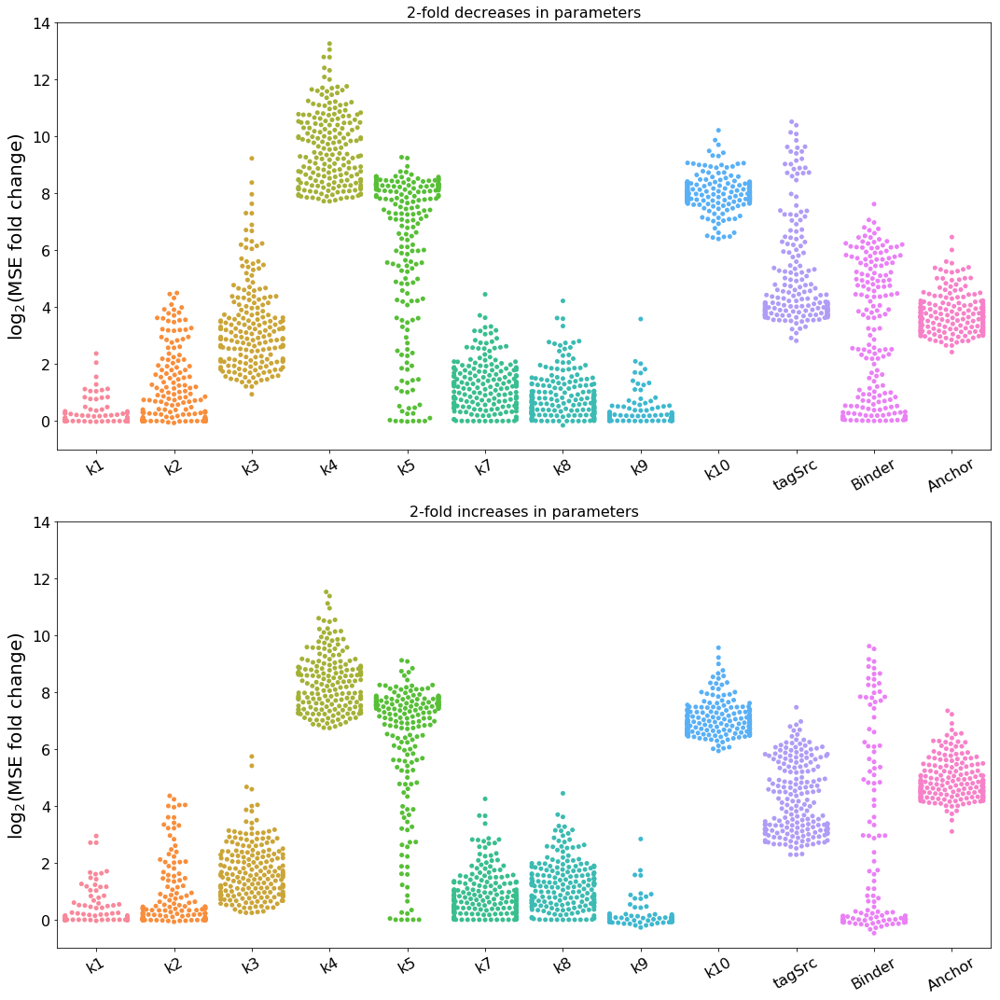

In [108]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

datasubset=data[:200]
log2score_less = [np.log2(x/y[1]) for (x,y) in zip(score_less,datasubset)]
log2score_more = [np.log2(x/y[1]) for (x,y) in zip(score_more,datasubset)]

scoreDF_less = pd.DataFrame(log2score_less,columns=['k1','k2','k3','k4','k5','k7','k8','k9','k10','tagSrc','Binder','Anchor'])
scoreDF_more = pd.DataFrame(log2score_more,columns=['k1','k2','k3','k4','k5','k7','k8','k9','k10','tagSrc','Binder','Anchor'])

# Melt for swarmplot
scoreDF_less_melt = pd.melt(scoreDF_less)
scoreDF_more_melt = pd.melt(scoreDF_more)

plt.figure(figsize=(15,15))
plt.subplot(2,1,1)
plt.tick_params(axis='both',which='major',labelsize=16)
sns.swarmplot(x=scoreDF_less_melt["variable"],y=scoreDF_less_melt["value"])
plt.ylabel('log$_2$(MSE fold change)',fontsize=20)
plt.xticks(rotation=30)
plt.xlabel('')
plt.title('2-fold decreases in parameters',fontsize=16)
plt.tick_params(labelsize=16)
plt.ylim(-1,14)

plt.subplot(2,1,2)
plt.tick_params(axis='both',which='major',labelsize=16)
sns.swarmplot(x=scoreDF_more_melt["variable"],y=scoreDF_more_melt["value"])
plt.ylabel('log$_2$(MSE fold change)',fontsize=20)
plt.xticks(rotation=30)
plt.xlabel('')
plt.title('2-fold increases in parameters',fontsize=16)
plt.tick_params(labelsize=16)
plt.ylim(-1,14)

plt.xlabel('')
plt.tight_layout()
plt.savefig(subfigsavedir+'/parameter_sensitivity.tif',dpi=300,bbox_inches='tight')
plt.savefig(subfigsavedir+'/parameter_sensitivity.svg',bbox_inches='tight')
plt.show()
                            

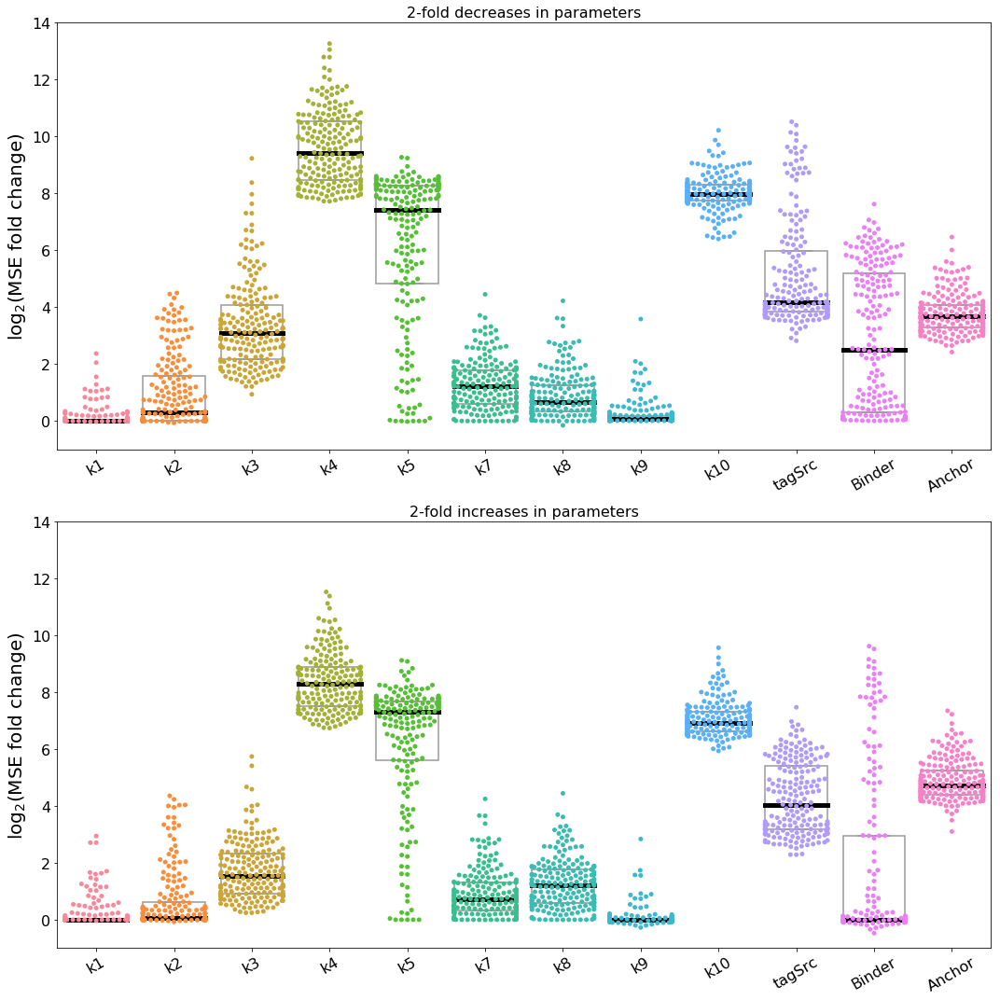

In [109]:
medianprops = dict(linestyle='-', linewidth=5, color='k')

plt.figure(figsize=(15,15))
plt.subplot(2,1,1)
plt.tick_params(axis='both',which='major',labelsize=16)
sns.boxplot(x=scoreDF_less_melt["variable"],y=scoreDF_less_melt["value"],
            showfliers=False,whis=0,medianprops=medianprops,color='1')
sns.swarmplot(x=scoreDF_less_melt["variable"],y=scoreDF_less_melt["value"])
plt.ylabel('log$_2$(MSE fold change)',fontsize=20)
plt.xticks(rotation=30)
plt.xlabel('')
plt.title('2-fold decreases in parameters',fontsize=16)
plt.tick_params(labelsize=16)
plt.ylim(-1,14)

plt.subplot(2,1,2)
plt.tick_params(axis='both',which='major',labelsize=16)
sns.boxplot(x=scoreDF_more_melt["variable"],y=scoreDF_more_melt["value"],
            showfliers=False,whis=0,medianprops=medianprops,color='1')
sns.swarmplot(x=scoreDF_more_melt["variable"],y=scoreDF_more_melt["value"])
plt.ylabel('log$_2$(MSE fold change)',fontsize=20)
plt.xticks(rotation=30)
plt.xlabel('')
plt.title('2-fold increases in parameters',fontsize=16)
plt.tick_params(labelsize=16)
plt.ylim(-1,14)

plt.xlabel('')
plt.tight_layout()
plt.savefig(subfigsavedir+'/parameter_sensitivity_v2.tif',dpi=300,bbox_inches='tight')
plt.savefig(subfigsavedir+'/parameter_sensitivity_v2.svg',bbox_inches='tight')
plt.show()

### Evaluation 

In [67]:
# Expect that k1 lifetime plots are OK -- are they?
check_k1_ts_less=np.zeros((200,4))
check_k1_b_less=np.zeros((200,4))
check_k1_ts_more=np.zeros((200,4))
check_k1_b_more=np.zeros((200,4))


for i in range(0,200):
    for j in range(0,12):
        if j != 0:
            continue
        
        # Compute 2fold less simulations
        currparams = data[i][2][-1].copy()
        currparams[j]=currparams[j]/2.
        tsL,bL=sim(currparams,False)
        check_k1_ts_less[i][:] = tsL
        check_k1_b_less[i][:] = bL        
        # Compute 2fold more effect
        currparams = data[i][2][-1].copy()
        currparams[j]=currparams[j]*2.
        tsL,bL=sim(currparams,False)
        check_k1_ts_more[i][:] = tsL
        check_k1_b_more[i][:] = bL

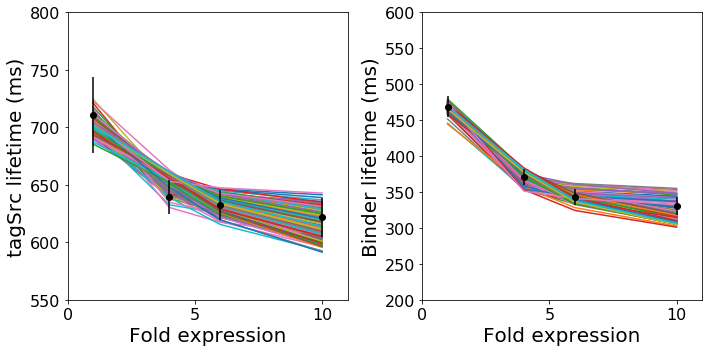

In [104]:
fig,(ax1,ax2)=plt.subplots(1,2,figsize=(10,5))
for i in range(0,200):
    ax1.plot([1,4,6,10],check_k1_ts_less[i][:])
    ax2.plot([1,4,6,10],check_k1_b_less[i][:])
ax1.errorbar([1,4,6,10],[710.4,639.5,632.4,621.8],[33,15,13,17],marker='o',mfc='k',
            mec='k',linestyle='none',color='k',zorder=1000)

ax2.errorbar([1,4,6,10],[469,371,343,330],[14.8,10.6,11.6,12.5],marker='o',mfc='k',
            mec='k',linestyle='none',color='k',zorder=1000)

ax1.set_xlim(0,11)
ax1.set_ylim(550,800)
ax2.set_xlim(0,11)
ax2.set_ylim(200,600)
ax1.set_xlabel('Fold expression',fontsize=20)
ax1.set_ylabel('tagSrc lifetime (ms)',fontsize=20)
ax2.set_xlabel('Fold expression',fontsize=20)
ax2.set_ylabel('Binder lifetime (ms)',fontsize=20)
ax1.tick_params(labelsize=16)
ax2.tick_params(labelsize=16)
ax1.set_xticks((0,5,10))
ax2.set_xticks((0,5,10))
plt.tight_layout()
plt.savefig(figsavedir+'/k1_sensitivity.png',dpi=300,bbox_inches='tight')
plt.show()

This example fit shows that the qualitative behavior doesn't suffer much for some of the milder perturbations (i.e. the behavior is fairly insensitive to k$_1$). However, if we consider, say, k$_4$...

In [112]:
# Expect that k1 lifetime plots are OK -- are they?
check_k4_ts_less=np.zeros((200,4))
check_k4_b_less=np.zeros((200,4))
check_k4_ts_more=np.zeros((200,4))
check_k4_b_more=np.zeros((200,4))


for i in range(0,200):
    for j in range(0,12):
        if j != 3:
            continue
        
        # Compute 2fold less simulations
        currparams = data[i][2][-1].copy()
        currparams[j]=currparams[j]/2.
        tsL,bL=sim(currparams,False)
        check_k4_ts_less[i][:] = tsL
        check_k4_b_less[i][:] = bL        
        # Compute 2fold more effect
        currparams = data[i][2][-1].copy()
        currparams[j]=currparams[j]*2.
        tsL,bL=sim(currparams,False)
        check_k4_ts_more[i][:] = tsL
        check_k4_b_more[i][:] = bL

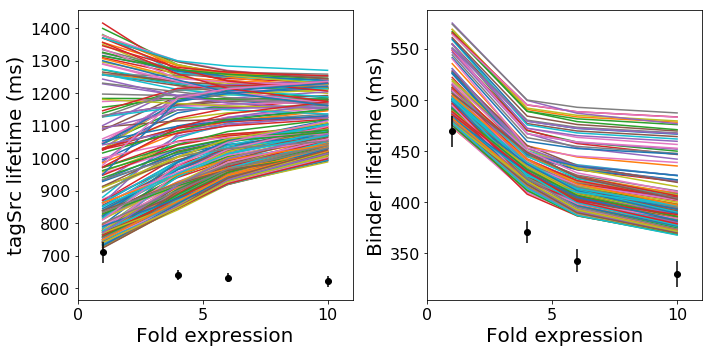

In [118]:
fig,(ax1,ax2)=plt.subplots(1,2,figsize=(10,5))
for i in range(0,200):
    ax1.plot([1,4,6,10],check_k4_ts_less[i][:])
    ax2.plot([1,4,6,10],check_k4_b_less[i][:])
ax1.errorbar([1,4,6,10],[710.4,639.5,632.4,621.8],[33,15,13,17],marker='o',mfc='k',
            mec='k',linestyle='none',color='k',zorder=1000)

ax2.errorbar([1,4,6,10],[469,371,343,330],[14.8,10.6,11.6,12.5],marker='o',mfc='k',
            mec='k',linestyle='none',color='k',zorder=1000)

ax1.set_xlim(0,11)
#ax1.set_ylim(550,800)
ax2.set_xlim(0,11)
#ax2.set_ylim(200,600)
ax1.set_xlabel('Fold expression',fontsize=20)
ax1.set_ylabel('tagSrc lifetime (ms)',fontsize=20)
ax2.set_xlabel('Fold expression',fontsize=20)
ax2.set_ylabel('Binder lifetime (ms)',fontsize=20)
ax1.tick_params(labelsize=16)
ax2.tick_params(labelsize=16)
ax1.set_xticks((0,5,10))
ax2.set_xticks((0,5,10))
plt.tight_layout()
plt.savefig(figsavedir+'/k4_sensitivity_zoomout.png',dpi=300,bbox_inches='tight')
plt.show()

That's surprisingly well-behaved, particularly for Binder. What if we play with the anchor stabilization?

In [114]:
# Expect that k1 lifetime plots are OK -- are they?
check_k5_ts_less=np.zeros((200,4))
check_k5_b_less=np.zeros((200,4))
check_k5_ts_more=np.zeros((200,4))
check_k5_b_more=np.zeros((200,4))


for i in range(0,200):
    for j in range(0,12):
        if j != 4:
            continue
        
        # Compute 2fold less simulations
        currparams = data[i][2][-1].copy()
        currparams[j]=currparams[j]/2.
        tsL,bL=sim(currparams,False)
        check_k5_ts_less[i][:] = tsL
        check_k5_b_less[i][:] = bL        
        # Compute 2fold more effect
        currparams = data[i][2][-1].copy()
        currparams[j]=currparams[j]*2.
        tsL,bL=sim(currparams,False)
        check_k5_ts_more[i][:] = tsL
        check_k5_b_more[i][:] = bL

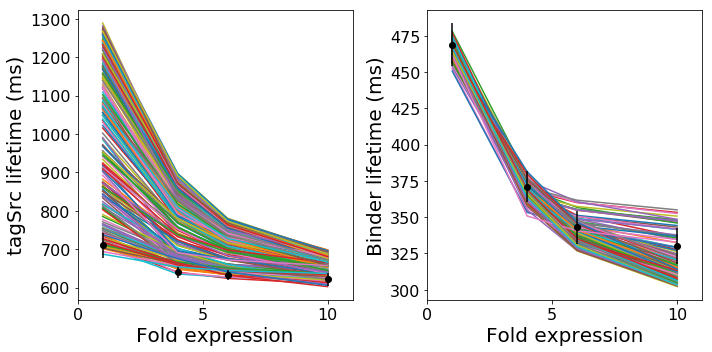

In [119]:
fig,(ax1,ax2)=plt.subplots(1,2,figsize=(10,5))
for i in range(0,200):
    ax1.plot([1,4,6,10],check_k5_ts_less[i][:])
    ax2.plot([1,4,6,10],check_k5_b_less[i][:])
ax1.errorbar([1,4,6,10],[710.4,639.5,632.4,621.8],[33,15,13,17],marker='o',mfc='k',
            mec='k',linestyle='none',color='k',zorder=1000)

ax2.errorbar([1,4,6,10],[469,371,343,330],[14.8,10.6,11.6,12.5],marker='o',mfc='k',
            mec='k',linestyle='none',color='k',zorder=1000)

ax1.set_xlim(0,11)
#ax1.set_ylim(550,800)
ax2.set_xlim(0,11)
#ax2.set_ylim(200,600)
ax1.set_xlabel('Fold expression',fontsize=20)
ax1.set_ylabel('tagSrc lifetime (ms)',fontsize=20)
ax2.set_xlabel('Fold expression',fontsize=20)
ax2.set_ylabel('Binder lifetime (ms)',fontsize=20)
ax1.tick_params(labelsize=16)
ax2.tick_params(labelsize=16)
ax1.set_xticks((0,5,10))
ax2.set_xticks((0,5,10))
plt.tight_layout()
plt.savefig(figsavedir+'/k5_sensitivity_zoomout.png',dpi=300,bbox_inches='tight')
plt.show()

Messing with the anchor stabilization doesn't do much. What about the off-rate of Binder itself (this has to affect things, right?)

In [116]:
# Expect that k1 lifetime plots are OK -- are they?
check_k10_ts_less=np.zeros((200,4))
check_k10_b_less=np.zeros((200,4))
check_k10_ts_more=np.zeros((200,4))
check_k10_b_more=np.zeros((200,4))


for i in range(0,200):
    for j in range(0,12):
        if j != 8:
            continue
        
        # Compute 2fold less simulations
        currparams = data[i][2][-1].copy()
        currparams[j]=currparams[j]/2.
        tsL,bL=sim(currparams,False)
        check_k10_ts_less[i][:] = tsL
        check_k10_b_less[i][:] = bL        
        # Compute 2fold more effect
        currparams = data[i][2][-1].copy()
        currparams[j]=currparams[j]*2.
        tsL,bL=sim(currparams,False)
        check_k10_ts_more[i][:] = tsL
        check_k10_b_more[i][:] = bL

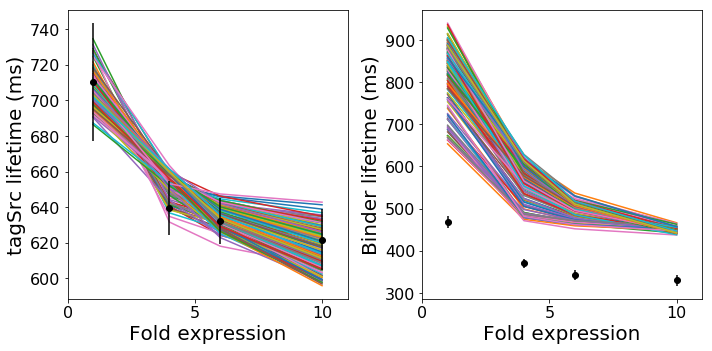

In [120]:
fig,(ax1,ax2)=plt.subplots(1,2,figsize=(10,5))
for i in range(0,200):
    ax1.plot([1,4,6,10],check_k10_ts_less[i][:])
    ax2.plot([1,4,6,10],check_k10_b_less[i][:])
ax1.errorbar([1,4,6,10],[710.4,639.5,632.4,621.8],[33,15,13,17],marker='o',mfc='k',
            mec='k',linestyle='none',color='k',zorder=1000)

ax2.errorbar([1,4,6,10],[469,371,343,330],[14.8,10.6,11.6,12.5],marker='o',mfc='k',
            mec='k',linestyle='none',color='k',zorder=1000)

ax1.set_xlim(0,11)
#ax1.set_ylim(550,800)
ax2.set_xlim(0,11)
#ax2.set_ylim(200,600)
ax1.set_xlabel('Fold expression',fontsize=20)
ax1.set_ylabel('tagSrc lifetime (ms)',fontsize=20)
ax2.set_xlabel('Fold expression',fontsize=20)
ax2.set_ylabel('Binder lifetime (ms)',fontsize=20)
ax1.tick_params(labelsize=16)
ax2.tick_params(labelsize=16)
ax1.set_xticks((0,5,10))
ax2.set_xticks((0,5,10))
plt.tight_layout()
plt.savefig(figsavedir+'/k10_sensitivity_zoomout.png',dpi=300,bbox_inches='tight')
plt.show()

It appears that the EA approach has managed to find rather robust parameter sets (which makes sense, given that they must resist changes caused by mating/crossover/mutation).

## 20190204 -- follow up by pre-constraining parameters

In [8]:
import os, errno
#figsavedir = '190110/figs/'
figsavedir = '190204/preconstrain/'


try:
    os.makedirs(figsavedir)
except OSError as e:
    if e.errno != errno.EEXIST:
        raise

In [9]:
# Basic function for loading data

import numpy as np
import os
import pickle

def load_data(dir_to_check, score_cutoff):
    #MSE threshold score at which to not include 
    val_to_keep_end_score = score_cutoff
    
    #load training data:
    #scorefxn_time, scorefxn_data = pickle.load(open(file_path_train, 'rb'))

    #load new data:
    arr_best_scores = []
    arr_best_inds = []
    arr_end_scores = []
    files = os.listdir(dir_to_check)
    for i in range(0,len(files)):
        filename = dir_to_check + '/' + files[i]
        if os.path.isfile(filename):
            if '.pickled' in files[i]:
                #print(filename)
                arr_to_unpickle = pickle.load(open(filename,'rb'))
                arr_best_score, arr_best_ind = arr_to_unpickle
                temp_end_score = arr_best_score[-1]
                if temp_end_score < val_to_keep_end_score:
                    arr_end_scores.append(temp_end_score)
                    arr_best_scores.append(arr_best_score)
                    arr_best_inds.append(arr_best_ind)
                #print(len(arr_to_unpickle), len(arr_best_score), len(arr_best_ind))
        else:
            break

    arr_best_scores = np.asarray(arr_best_scores)
    arr_best_inds = np.asarray(arr_best_inds)
    arr_end_scores = np.asarray(arr_end_scores)

    print('Loaded ' + str(len(arr_best_scores)) + ' files (out of ' + str(len(files)) + ') with cutoff score of ' + str(score_cutoff))

    return arr_best_scores, arr_end_scores, arr_best_inds

Loaded 1987 files (out of 1988) with cutoff score of 10000000


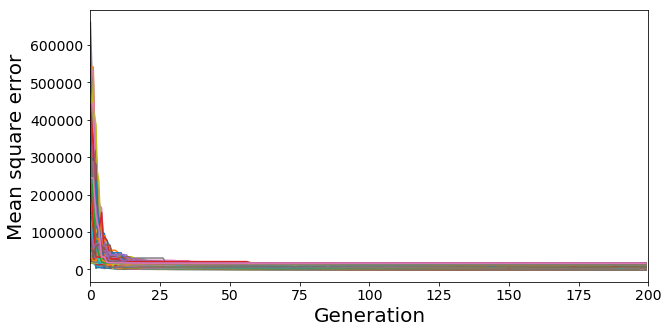

In [10]:
################################################################
# Loads the data.
# Data are located @ /Users/mikepab/Dropbox/jeff_mike/phd_pde/ML-RDE-phagosynapse/171020/171020_0-1_100g50i10m50c/
################################################################

arr_best_scores, arr_end_scores, arr_best_inds =\
load_data('/Volumes/SATAdrive/20190204_preconstrain_btEA/190204_ea_200g200i10m50c/', 10000000)

#load_data('/Volumes/med/Elston Lab/MikePablo/20181010 - satadrive backup/20181005_try4_EAdata/181006_eta_200g200i10m50c/',10000000)
#CONVERT DATA:
from operator import itemgetter
import numpy as np
np.set_printoptions(precision=1, suppress=True)

data = sorted(zip(arr_best_scores, arr_end_scores, arr_best_inds), key=itemgetter(1))

#MSE PLOT    
import matplotlib.pyplot as plt
%matplotlib inline

gen = 200
fig = plt.figure(figsize=(10,5))

for i in range(len(data)):
    #data[i][0][gen] = arr_best_scores
    #data[i][1] = arr_end_scores
    #data[i][2][gen] = arr_best_inds

    #plot2: MSE vs generations     
    plt.xlabel('Generation', fontsize=20)
    plt.ylabel('Mean square error', fontsize=20)
    plt.xlim([0,200])
    #plt.ylim([0,1000])
    #plt.ylim([0,1500])
    plt.plot([x for x in range(gen)], data[i][0][:gen])
    plt.tick_params(axis='both',which='major',labelsize=14)
    #print(np.shape(data[i][0]))
    
    maxval = len(data[i][2])-1
#plt.savefig(figsavedir+'/MSE_timecourse.tif',dpi=300,bbox_inches='tight')

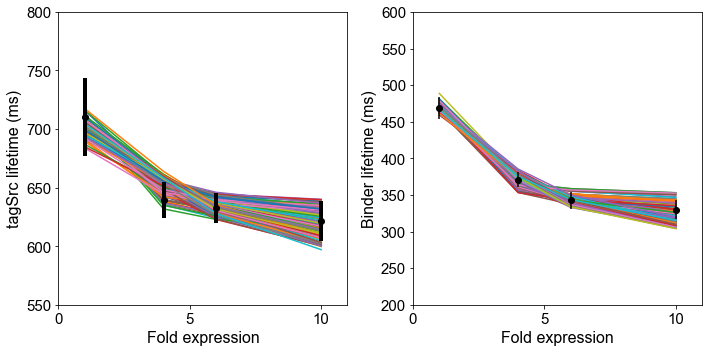

In [13]:
from scipy.integrate import odeint

np.set_printoptions(precision=1)
#plt.figure(figsize=(14,5))
fig,ax=plt.subplots(1,2)
fig.set_figheight(5)
fig.set_figwidth(10)
for i in range(0,200):
    #print(i,data[i][1],data[i][2][200])
    tsL,bL=sim(data[i][2][-1],False)
    ax[0].plot([1,4,6,10],tsL)
    ax[1].plot([1,4,6,10],bL)

ax[0].set_xlabel('Fold expression',fontsize=16,fontname='arial')
ax[0].set_ylabel('tagSrc lifetime (ms)',fontsize=16,fontname='arial')
ax[1].set_xlabel('Fold expression',fontsize=16,fontname='arial')
ax[1].set_ylabel('Binder lifetime (ms)',fontsize=16,fontname='arial')

ax[0].tick_params(axis='both',which='major',labelsize=15)
ax[1].tick_params(axis='both',which='major',labelsize=15)

ax[0].set_ylim((550,800))
ax[1].set_ylim((200,600))
ax[0].set_xticks((0,5,10))
ax[1].set_xticks((0,5,10))
ax[0].set_xlim(0,11)
ax[1].set_xlim(0,11)


import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42



for tick in ax[0].get_xticklabels():
    tick.set_fontname('arial')
for tick in ax[0].get_yticklabels():
    tick.set_fontname('arial')
for tick in ax[1].get_xticklabels():
    tick.set_fontname('arial')
for tick in ax[1].get_yticklabels():
    tick.set_fontname('arial')


ax[0].errorbar([1,4,6,10],[710.4,639.5,632.4,621.8],[33,15,13,17],marker='o',mfc='k',
            mec='k',linestyle='none',color='k',zorder=1000,elinewidth=4)


ax[1].errorbar([1,4,6,10],[469,371,343,330],[14.8,10.6,11.6,12.5],marker='o',mfc='k',
            mec='k',linestyle='none',color='k',zorder=1000)


plt.tight_layout()

#plt.savefig('/Volumes/SATAdrive/20180912/180919/model_curves.tif',dpi=300)

#plt.tick_params(axis='both',which='major',labelsize=14)
plt.savefig(figsavedir+'/lifetime_vs_expression_top200.tif',dpi=300,bbox_inches='tight',transparent=True)
plt.savefig(figsavedir+'/lifetime_vs_expression_top200.pdf',dpi=300,bbox_inches='tight',transparent=True)
plt.show()

### Anchor molecules become saturated by tagSrc

In [94]:
def convert_uM_to_particles(conc,vol):
    return conc*602*vol

def convert_1stOrder_to_s(k):
    return k*1000

def convert_2ndOrder_to_uM_s(k):
    return k*1000

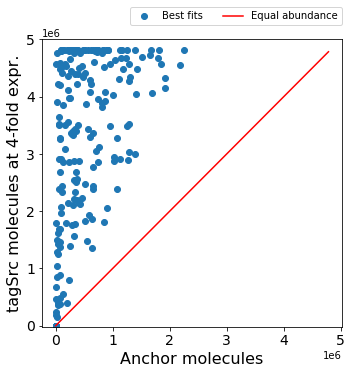

In [70]:
import matplotlib.pyplot as plt

ts_abund_HIGH = np.zeros(len(data))
anc_abund_HIGH = np.zeros(len(data))
ts_abund_LOW = np.zeros(len(data))
anc_abund_LOW = np.zeros(len(data))


for i in range(0,200):
    curr_data = data[i]
    ts_abund_HIGH[i] = convert_uM_to_particles(curr_data[2][-1][-3],2000)
    anc_abund_HIGH[i] = convert_uM_to_particles(curr_data[2][-1][-1],0.04*2000)

for i in range(0,200):
    curr_data = data[-i]
    ts_abund_LOW[i] = convert_uM_to_particles(curr_data[2][0][-3],2000)
    anc_abund_LOW[i] = convert_uM_to_particles(curr_data[2][0][-1],0.04*2000)

   
plt.figure(figsize=(5,5))
mn = min(min(anc_abund_HIGH),min(ts_abund_HIGH),min(anc_abund_LOW),min(ts_abund_LOW))
mx = max(max(anc_abund_HIGH),max(ts_abund_HIGH),max(anc_abund_LOW),max(ts_abund_LOW))

plt.plot(anc_abund_HIGH,ts_abund_HIGH*4,marker='o',linestyle='none',label="Best fits")
#plt.plot(anc_abund_LOW,ts_abund_LOW*4,marker='o',markeredgecolor='gray',markerfacecolor='none',linestyle='none',label="Worst fits")
plt.xlabel('Anchor molecules',fontsize=16)
plt.ylabel('tagSrc molecules at 4-fold expr.',fontsize=16)
plt.tick_params(axis='both',which='major',labelsize=14)
plt.plot([mn,mx],[mn,mx],color='red',label='Equal abundance')
plt.ylim((-20000,2*2500000))
plt.ticklabel_format(style='sci',axis='both',scilimits=(0,0),fontsize=20)
#plt.legend(,loc=4)
plt.legend(bbox_to_anchor=(0., 1.05, 1., .102), loc=4,
           ncol=2, borderaxespad=0.)
plt.tight_layout()
plt.savefig(figsavedir+'/anchor_saturation_v3.png',dpi=300,bbox_inches='tight')
plt.savefig(figsavedir+'/anchor_saturation_v3.svg',bbox_inches='tight')
plt.show()

### Formatting results into a Pandas DataFrame

In [95]:
import pandas as pd
import seaborn as sns

data = data[:200] 

test=[x[2][-1] for x in data]
df = pd.DataFrame(test,columns=('k1','k2','k3','k4','k5','k7','k8','k9','k10','tagSrc_base_conc','binder_base_conc','anchor_conc'))
melt_df = pd.melt(df)
k_1storder = melt_df.loc[melt_df['variable'].isin(['k1','k2','k3','k4','k5','k8','k10'])]
k_2ndorder = melt_df.loc[melt_df['variable'].isin(['k7','k9'])]
k_concs = melt_df.loc[melt_df['variable'].isin(['tagSrc_base_conc','binder_base_conc','anchor_conc'])]

# This emits a SettingWithCopyWarning, but by assigning the result of *.transform I get around it (I think)
k_1storder['value'] = k_1storder['value'].transform(lambda x: convert_1stOrder_to_s(x))
k_2ndorder['value'] = k_2ndorder['value'].transform(lambda x: convert_2ndOrder_to_uM_s(x))
ts_abundance = k_concs[k_concs.variable=='tagSrc_base_conc']['value'].transform(lambda x: convert_uM_to_particles(x,2000))
ts_abundance = [x for x in ts_abundance]
bin_abundance = k_concs[k_concs.variable=='binder_base_conc']['value'].transform(lambda x: convert_uM_to_particles(x,2000))
bin_abundance = [x for x in bin_abundance]
anc_abundance = k_concs[k_concs.variable=='anchor_conc']['value'].transform(lambda x: convert_uM_to_particles(x,2000*0.04))
anc_abundance = [x for x in anc_abundance]
abund = pd.DataFrame(np.transpose([ts_abundance,bin_abundance,anc_abundance]),columns=('nTagSrc','nBinder','nAnchor'))
abund = pd.melt(abund)

/Users/mikepab/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
/Users/mikepab/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


### Checking Binder dissociation rate

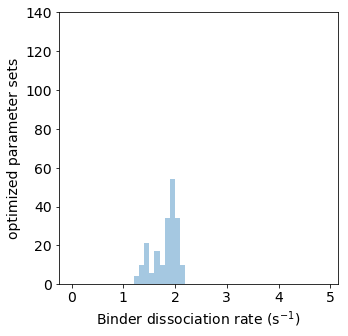

In [96]:
import seaborn as sns

fig=plt.figure(figsize=(5,5))

plt.tick_params(axis='both',which='major',labelsize=14)
sns.distplot(k_1storder[k_1storder['variable']=='k10'].value,bins=(np.arange(0.,5,.1)),kde=False)
plt.ylabel('optimized parameter sets',fontsize=14)
plt.xlabel('Binder dissociation rate (s$^{-1}$)',fontsize=14)#'k$_4$, s$^{-1}$',fontsize=14)
plt.ylim(0,140)
plt.savefig(figsavedir+'/parameter_ranges_k9.tif',dpi=300,bbox_inches='tight')
plt.savefig(figsavedir+'/parameter_ranges_k9.svg',bbox_inches='tight')
plt.show()

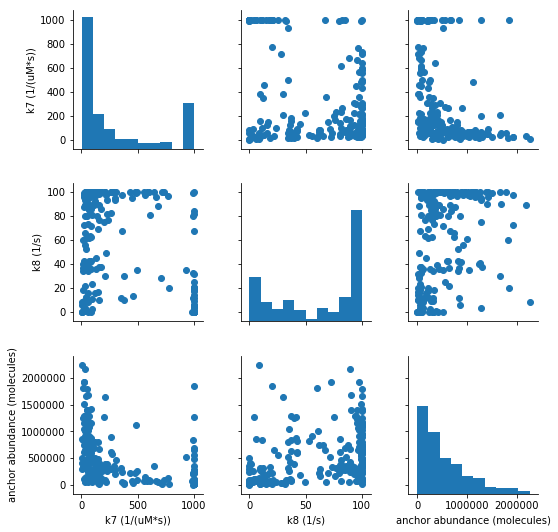

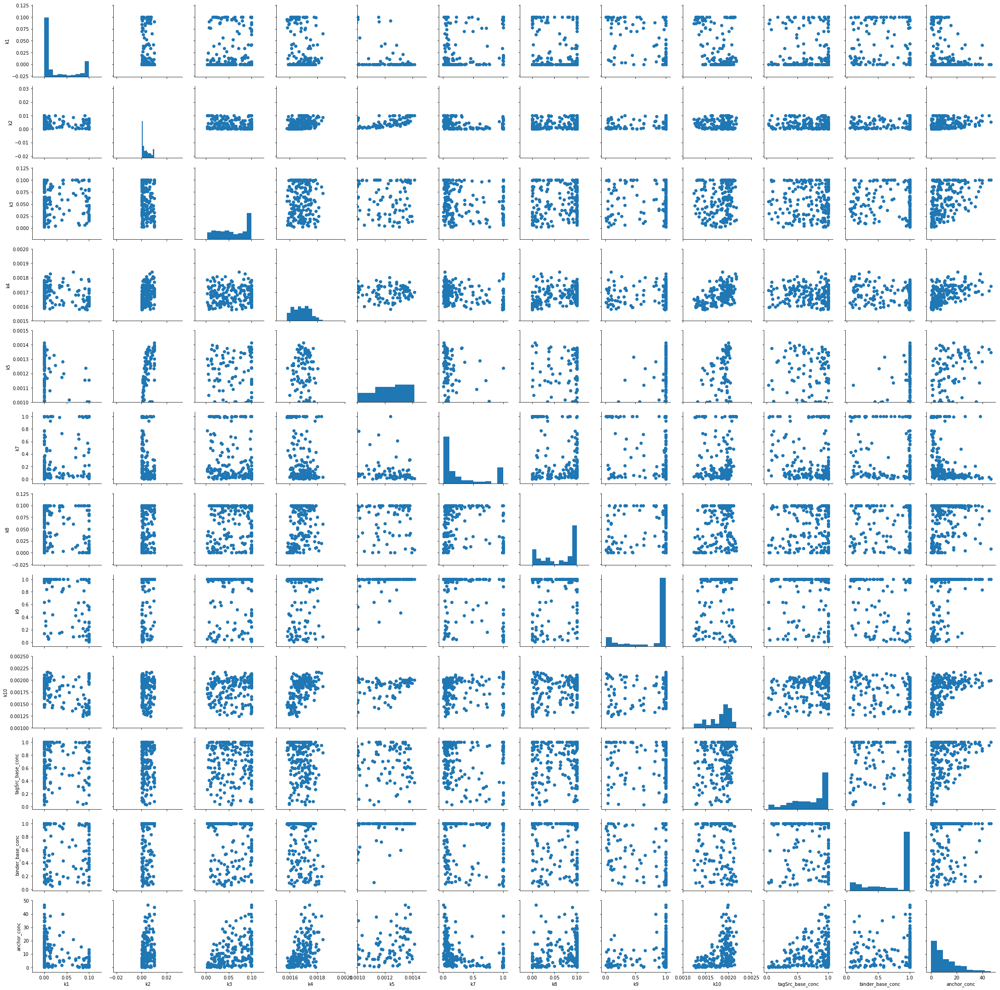

In [79]:
data = data[:200] 

test=[x[2][-1] for x in data]
df = pd.DataFrame(test,columns=('k1','k2','k3','k4','k5','k7','k8','k9','k10','tagSrc_base_conc','binder_base_conc','anchor_conc'))
melt_df = pd.melt(df)
k_1storder = melt_df.loc[melt_df['variable'].isin(['k1','k2','k3','k4','k5','k8','k10'])]
k_2ndorder = melt_df.loc[melt_df['variable'].isin(['k7','k9'])]
k_concs = melt_df.loc[melt_df['variable'].isin(['tagSrc_base_conc','binder_base_conc','anchor_conc'])]


k7 = k_2ndorder[k_2ndorder.variable=='k7']['value'].transform(lambda x: convert_2ndOrder_to_uM_s(x))
k7 = [x for x in k7]
k8 = k_1storder[k_1storder.variable=='k8']['value'].transform(lambda x: convert_1stOrder_to_s(x))
k8 = [x for x in k8]

anc_abundance = k_concs[k_concs.variable=='anchor_conc']['value'].transform(lambda x: convert_uM_to_particles(x,2000*0.04))
anc_abundance = [x for x in anc_abundance]
anchor_data = pd.DataFrame(np.transpose([k7,k8,anc_abundance]),columns=('k7 (1/(uM*s))','k8 (1/s)','anchor abundance (molecules)'))
#abund = pd.melt(abund)

g=sns.PairGrid(anchor_data)
g=g.map_offdiag(plt.scatter)
g=g.map_diag(plt.hist)

plt.savefig(figsavedir+'/anchor_affinity_vs_abundance.tif',dpi=300,bbox_inches='tight')
plt.savefig(figsavedir+'/anchor_affinity_vs_abundance.svg',bbox_inches='tight')


g2=sns.PairGrid(df)
g2=g2.map_offdiag(plt.scatter)
g2=g2.map_diag(plt.hist)
for i in range(0,12):
    g2.axes[i,3].set_xlim((.0015,2./1000))
    g2.axes[i,4].set_xlim((1/1000,1.5/1000))
    g2.axes[i,8].set_xlim((1/1000,2.5/1000))
    g2.axes[3,i].set_ylim((.0015,2./1000))
    g2.axes[4,i].set_ylim((1/1000,1.5/1000))
    g2.axes[8,i].set_ylim((1/1000,2.5/1000))
plt.show()

### "Anchor" function is predicted

In [88]:
k_1storder[k_1storder['variable']=='k4'].value

600    1.673031
601    1.678400
602    1.660257
603    1.682963
604    1.661500
605    1.680355
606    1.630503
607    1.706564
608    1.626156
609    1.716393
610    1.711077
611    1.730998
612    1.627431
613    1.665072
614    1.726539
615    1.642231
616    1.643591
617    1.615995
618    1.666287
619    1.626239
620    1.730908
621    1.664844
622    1.718269
623    1.617508
624    1.662263
625    1.634765
626    1.713292
627    1.622980
628    1.687503
629    1.629981
         ...   
770    1.689872
771    1.699504
772    1.730508
773    1.709209
774    1.801214
775    1.637373
776    1.693703
777    1.633123
778    1.740112
779    1.772795
780    1.629098
781    1.792691
782    1.713521
783    1.744526
784    1.672555
785    1.740380
786    1.615633
787    1.769185
788    1.685972
789    1.671472
790    1.624945
791    1.749826
792    1.719750
793    1.742575
794    1.709065
795    1.828129
796    1.745409
797    1.711716
798    1.725872
799    1.839730
Name: value, Length: 200

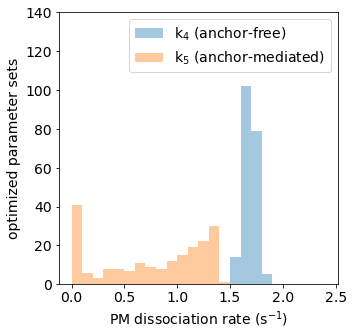

In [97]:
import seaborn as sns

fig=plt.figure(figsize=(5,5))

plt.tick_params(axis='both',which='major',labelsize=14)
sns.distplot(k_1storder[k_1storder['variable']=='k4'].value,bins=(np.arange(0.,2.5,.1)),kde=False)
sns.distplot(k_1storder[k_1storder['variable']=='k5'].value,bins=(np.arange(0.,2.5,.1)),kde=False)
plt.ylabel('optimized parameter sets',fontsize=14)
plt.xlabel('PM dissociation rate (s$^{-1}$)',fontsize=14)#'k$_4$, s$^{-1}$',fontsize=14)
plt.legend(('k$_4$ (anchor-free)','k$_5$ (anchor-mediated)'),fontsize=14)
plt.ylim(0,140)
plt.savefig(figsavedir+'/parameter_ranges_k4k5.tif',dpi=300,bbox_inches='tight')
plt.savefig(figsavedir+'/parameter_ranges_k4k5.svg',bbox_inches='tight')
plt.show()

### Estimation of tagSrc/Binder KD

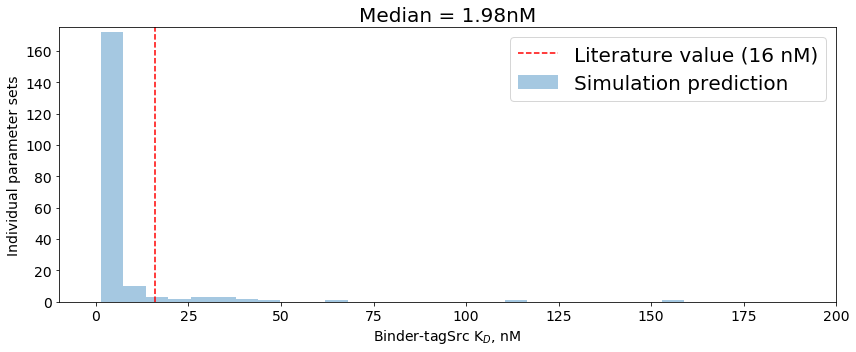

In [98]:
plt.figure(figsize=(12,5))
plt.tick_params(axis='both',which='major',labelsize=14)
KD = (np.asarray((k_1storder[k_1storder['variable']=='k10'].value))) / \
     (np.asarray((k_2ndorder[k_2ndorder['variable']=='k9'].value))) * 1000
sns.distplot(KD,kde=False)#,bins=100)
#plt.xticks(rotation=90)
plt.ylabel('Individual parameter sets',fontsize=14)
plt.xlabel('Binder-tagSrc K$_D$, nM',fontsize=14)
plt.title('Median = '+'%.2f'%(np.median(KD))+'nM',fontsize=20)
plt.plot([16,16],[0,190],'r--')
plt.xlim(-10,200)
plt.ylim(0,175)
plt.legend(('Literature value (16 nM)','Simulation prediction'),fontsize=20)
plt.tight_layout()
plt.savefig(figsavedir+'/tagSrcBinder_KD.tif',dpi=300,bbox_inches='tight')
plt.savefig(figsavedir+'/tagSrcBinder_KD.svg',bbox_inches='tight')
plt.show()

### Effective anchor KD

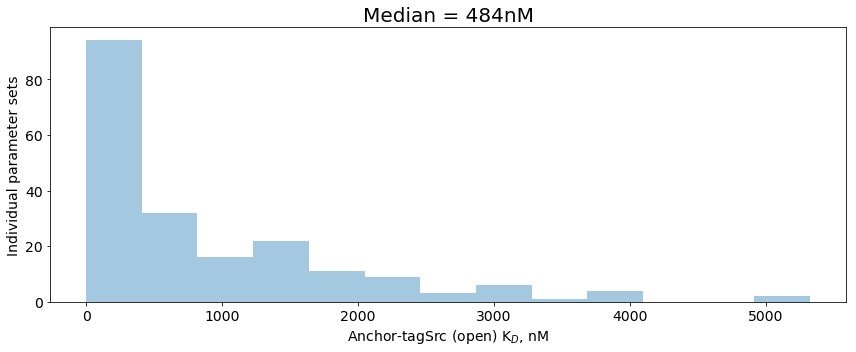

In [91]:
plt.figure(figsize=(12,5))
plt.tick_params(axis='both',which='major',labelsize=14)
# (There are two off rates -- should I sum them?)
KD = (np.asarray((k_1storder[k_1storder['variable']=='k8'].value))+np.asarray(k_1storder[k_1storder['variable']=='k5'].value)) / \
     (np.asarray((k_2ndorder[k_2ndorder['variable']=='k7'].value))) *1000
sns.distplot(KD,kde=False)#,bins=100)
#plt.xticks(rotation=90)
plt.ylabel('Individual parameter sets',fontsize=14)
plt.xlabel('Anchor-tagSrc (open) K$_D$, nM',fontsize=14)
plt.title('Median = '+'%i'%(np.median(KD))+'nM',fontsize=20)
#plt.ylim([0,200])
#plt.xlim([0,500])
plt.tight_layout()
plt.savefig(figsavedir+'/anchor_KD.tif',dpi=300,bbox_inches='tight')
plt.savefig(figsavedir+'/anchor_KD.svg',bbox_inches='tight')
plt.show()

### General rate constants

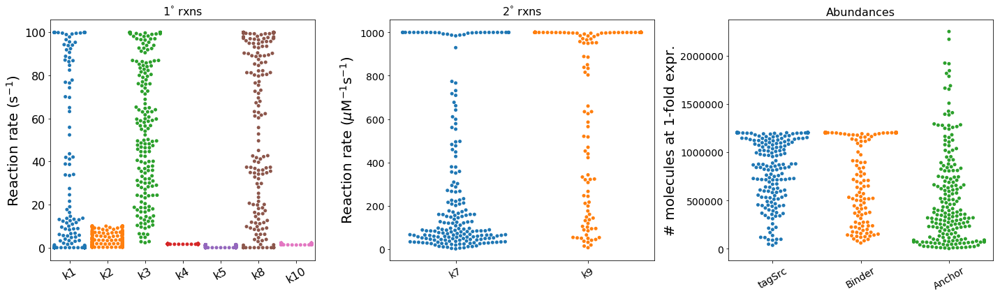

In [99]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

#print(melt_df)
plt.figure(figsize=(20,6))
plt.subplot(1,3,1)
plt.tick_params(axis='both',which='major',labelsize=16)
sns.swarmplot(x=k_1storder["variable"],y=k_1storder["value"])
plt.ylabel('Reaction rate (s$^{-1}$)',fontsize=20)
plt.xticks(rotation=30)
plt.xlabel('')
plt.title('1$^\degree$ rxns',fontsize=16)
plt.subplot(1,3,2)
plt.tick_params(axis='both',which='major',labelsize=14)
sns.swarmplot(x=k_2ndorder["variable"],y=k_2ndorder["value"])
plt.ylabel('Reaction rate ($\mu$M$^{-1}$s$^{-1}$)',fontsize=20)
plt.xticks(rotation=30)
plt.xlabel('')
plt.title('2$^\degree$ rxns',fontsize=16)
plt.subplot(1,3,3)
plt.tick_params(axis='both',which='major',labelsize=14)
sns.swarmplot(x=abund["variable"],y=abund["value"])
plt.ylabel('# molecules at 1-fold expr.',fontsize=20)
plt.xticks(rotation=30)
plt.xticks((0,1,2),('tagSrc','Binder','Anchor'))
plt.title('Abundances',fontsize=16)
plt.xlabel('')
plt.tight_layout()
plt.savefig(figsavedir+'/parameter_ranges.tif',dpi=300,bbox_inches='tight')
plt.savefig(figsavedir+'/parameter_ranges.svg',bbox_inches='tight')
plt.show()

In [30]:
k_1storder.loc[k_1storder["variable"].isin(['k4','k5','k10'])]

,variable,value
600,k4,1.687869
601,k4,1.655298
602,k4,1.691837
603,k4,1.655486
604,k4,1.691700
605,k4,1.675627
606,k4,1.659561
607,k4,1.691743
608,k4,1.723986
609,k4,1.636743


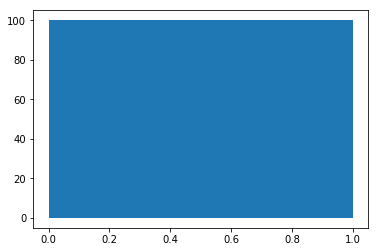

In [46]:

plt.fill_between((0,1),0,100)

[0.  0.2 0.4 0.6 0.8 1. ]


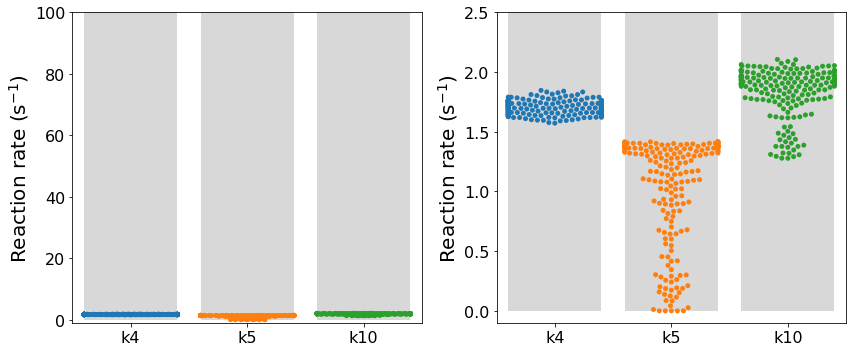

In [58]:
# Visualize k4, k5, and k10 only
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.patches as patches 
#print(melt_df)
fig,(ax1,ax2)=plt.subplots(1,2,figsize=(12,5))
plt.subplot(1,2,1)
plt.tick_params(axis='both',which='major',labelsize=16)
sns.swarmplot(x=k_1storder.loc[k_1storder["variable"].isin(['k4','k5','k10'])]["variable"],
              y=k_1storder.loc[k_1storder["variable"].isin(['k4','k5','k10'])]["value"])
plt.ylabel('Reaction rate (s$^{-1}$)',fontsize=20)
#plt.xticks(rotation=30)
plt.ylim(-1,100)
plt.xlabel('')

#rect=patches.Rectangle((1,1),10,100,edgecolor='none',facecolor='gray')
#ax1.add_patch(rect)
plt.fill_between((-.4,.4),0,100,facecolor='gray',alpha=0.3)
plt.fill_between((.6,1.4),0,100,facecolor='gray',alpha=0.3)
plt.fill_between((1.6,2.4),0,100,facecolor='gray',alpha=0.3)

plt.subplot(1,2,2)
plt.tick_params(axis='both',which='major',labelsize=16)
sns.swarmplot(x=k_1storder.loc[k_1storder["variable"].isin(['k4','k5','k10'])]["variable"],
              y=k_1storder.loc[k_1storder["variable"].isin(['k4','k5','k10'])]["value"])
plt.ylabel('Reaction rate (s$^{-1}$)',fontsize=20)
#plt.xticks(rotation=30)
plt.xlabel('')

plt.fill_between((-.4,.4),0,2.5,facecolor='gray',alpha=0.3)
plt.fill_between((.6,1.4),0,2.5,facecolor='gray',alpha=0.3)
plt.fill_between((1.6,2.4),0,2.5,facecolor='gray',alpha=0.3)
plt.ylim((-.1,2.5))


plt.tight_layout()
plt.savefig(figsavedir+'/parameter_ranges.tif',dpi=300,bbox_inches='tight')
plt.savefig(figsavedir+'/parameter_ranges.svg',bbox_inches='tight')
plt.show()

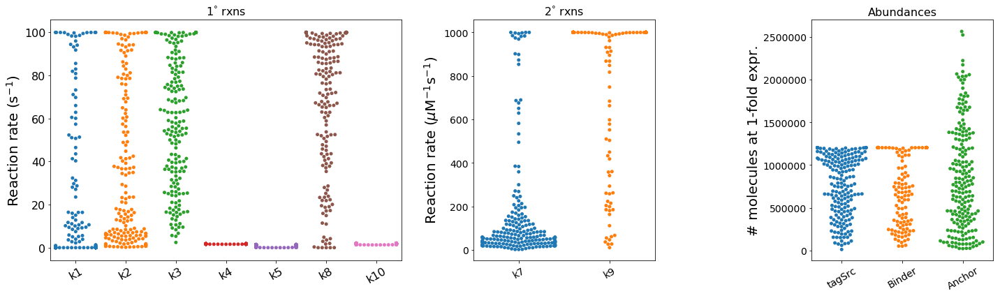

In [35]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

gridspec.GridSpec(1,12)

#print(melt_df)
fig=plt.figure(figsize=(20,6))
#plt.subplot(1,3,1)
plt.subplot2grid((1,12),(0,0),colspan=5,rowspan=1)
plt.tick_params(axis='both',which='major',labelsize=16)
sns.swarmplot(x=k_1storder["variable"],y=k_1storder["value"])#,cut=0)
plt.ylabel('Reaction rate (s$^{-1}$)',fontsize=20)
plt.xticks(rotation=30)
plt.xlabel('')
plt.title('1$^\degree$ rxns',fontsize=16)

#plt.subplot(1,3,2)
plt.subplot2grid((1,12),(0,5),colspan=3,rowspan=1)

plt.tick_params(axis='both',which='major',labelsize=14)
sns.swarmplot(x=k_2ndorder["variable"],y=k_2ndorder["value"])#,cut=0)
plt.ylabel('Reaction rate ($\mu$M$^{-1}$s$^{-1}$)',fontsize=20)
plt.xticks(rotation=30)
plt.xlabel('')
plt.title('2$^\degree$ rxns',fontsize=16)

#plt.subplot(1,3,3)
plt.subplot2grid((1,12),(0,9),colspan=4,rowspan=1)
plt.tick_params(axis='both',which='major',labelsize=14)
sns.swarmplot(x=abund["variable"],y=abund["value"])#,cut=0)
plt.ylabel('# molecules at 1-fold expr.',fontsize=20)
plt.xticks(rotation=30)
plt.xticks((0,1,2),('tagSrc','Binder','Anchor'))
plt.title('Abundances',fontsize=16)
plt.xlabel('')

fig.tight_layout()
fig.savefig(figsavedir+'/parameter_ranges.tif',dpi=300,bbox_inches='tight')
fig.savefig(figsavedir+'/parameter_ranges.svg',bbox_inches='tight')
fig.show()

# SPT kinetics analysis

## Motivation

We now want to take each individual, and generate 1000 realizations of SPT trajectories from the ODE system. After generating these sets of trajectories, we can consider how well we can predict other aspects of Bei's data (e.g., lifetime distributions, delay time distributions, co-diffusion categories, etc).

## Implementation
We will assume each of our 1000 particle realizations are stochastically reacting within a well-mixed bath at steady-state. Here we assume that stochastic effects do not appreciately affect reaction kinetics. As usual, the timestep must be sufficiently small to maintain the Poisson assumption, i.e.  $\text{max}(P_{rxn})<0.1$.

### First order reactions
We will use the standard approach $P_{rxn} = 1-e^{-k\Delta t}$ where $k$ is the rate constant, and $\Delta t$ is the simulation timestep. 

### Second order reactions
For an individual molecule A reacting in a _well-mixed bath of many reactants_ B, the reaction probability is: <br>

\begin{align}
P_{rxn} & = \frac{k_{macro}N_B\Delta t}{V_{rxn}}
\end{align}

where $k_{macro}$ is the macroscopic rate constant obtained from the ODE fits, $N_B$ is the __PARTICLE NUMBER__ of the partner reactant, $\Delta t$ is the simulation timestep, and $V_{rxn}$ is the volume in which the reaction can occur.

## Simulation execution

In [ ]:
#!/usr/bin/env python

# Generate simulated tracks. Intended for use in combination with launch_sim.py
import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import odeint
import sys

def get_1stOrder_Prxn(k,dt):
    return 1-np.exp(-k*dt)

def get_2ndOrder_Prxn(k,dt,NB,V):
    return k*NB*dt/V

def check_poisson_assumption(Prxns):
    for i in range(0,len(Prxns)):
        assert Prxns[i]<0.1,'Poisson assumption violated for P(%i) = %.1f'%(i,Prxns[i])

def ssODE(y,t,p):
    eta = 0.04
    A,B,C,D,E,F,G,H,I,J = y
    [k1,k2,k3,k4,k5,k6,k7,k8,k9,k10,k11]=p
    #k11=0.
    dA = -k3*A + k4*B
    dB = -(k2+k4)*B + k3*A + k1*D
    dC = -(k3+k6*J)*C + k4*D + k11*H + k5*F
    dD = -(k1+k4+k9*I+k7*J)*D + k2*B + k3*C + k10*E + k8*F
    dE = -(k10+k7*J+k4)*E + k9*I*D + k8*G + k3*H
    dF = -(k8+k9*I+k5)*F + k7*J*D + k10*G + k6*J*C
    dG = -(k8+k10+k5)*G + k7*E*J + k9*I*F +k6*J*H
    dH = -(k3+k11+k6*J)*H + k4*E + k5*G
    dI = -(k9*D+k9*F)*I + k10*(E+G) + k11*H
    dJ = -(k6*(C+H)+k7*(D+E))*J + k5*(F+G) + k8*(F+G)
    
    derivs = [dA*eta,dB,dC*eta,dD,dE,dF,dG,dH*eta,dI*eta,dJ]
    return derivs

def resolve_rxns(currState,targStates,didRxnStates,Prxn):
# currStates: current state of molecule
# targStates: state necessary for reaction(s) to occur
# didRxnStates: state resulting from a succesful reaction
# Prxns: probabilities of reaction.
    nrxns = len(targStates)
    was_successful = False
    for i in range(0,nrxns):
        if currState==targStates[i]:
            if np.random.rand() < Prxn:
                #print('Fired a reaction (%i->%i)'%(currState,didRxnStates[i]))
                was_successful = True
                return didRxnStates[i],was_successful # this reaction succeeded.
    return currState,was_successful # no reaction succeeded

# Assumes we use raw parameter sets from the EA, which are in units of ms-1 and uM-1. 
# We convert to s, um3, and particles, and assume a 2000 um3 cubic volume for the cell. 
def sim(EA_param_vec,randomseed,expression_level,savename):
    # raw params, ms-1 and uM-1
    k1,k2,k3,k4,k7,k8,k9,k10,tS_base,bin_base,anchor = EA_param_vec
        
    # Useful parameters
    cell_vol = 2000 # um3
    eta = 0.04 # ratio of cytosol volume to membrane volume
    #dt = 0.00002 # s
    dt = 0.0001 # s
    
    np.random.seed(seed=randomseed)
    #nsteps = 100000 # simulate 200*dt (super-long)
    nsteps = 60000 # simulate 200*dt (super-long)
    nTracks = 1000
    acquisition_time = 0.0001 # s
    nsampframes = int(nsteps*dt/acquisition_time)+1
    
    print('Simulating %.1f seconds'%(nsteps*dt),'at timestep',dt,'seconds')
    sys.stdout.flush()
    # Solve initial ODE in same units used for EA optimization to ensure no numerical issues
    y0 = np.array([tS_base*expression_level,0.,0.,0.,0.,0.,0.,0.,bin_base*expression_level,anchor])
    t = np.arange(0.,10000,.1) # run to SS.
    k5=0.
    k6=0.
    k11=0.
    odeparams = [k1,k2,k3,k4,k5,k6,k7,k8,k9,k10,k11] # Solve this in base units
    odeSoln = odeint(ssODE,y0,t,args=(odeparams,))
    ss_counts = odeSoln[-1,:] # convert to particle number
    # Scale counts of membrane-associated species by eta.
    nSpec_A = int(ss_counts[0]*602*cell_vol)     # closed form cytosolic Src (1)
    nSpec_B = int(ss_counts[1]*602*cell_vol*eta) # closed form membrane Src (2)
    nSpec_C = int(ss_counts[2]*602*cell_vol)     # open form cytosolic Src (3)
    nSpec_D = int(ss_counts[3]*602*cell_vol*eta) # open form membrane Src (4)
    nSpec_E = int(ss_counts[4]*602*cell_vol*eta) # open form membrane Src w/ Binder (5)
    nSpec_F = int(ss_counts[5]*602*cell_vol*eta) # open form membrane Src w/ Anchor (6)
    nSpec_G = int(ss_counts[6]*602*cell_vol*eta) # open form membrane Src w/ Binder + Anchor (7)
    nSpec_H = int(ss_counts[7]*602*cell_vol)     # open form cytosolic Src w/ Binder (8)
    nSpec_I = int(ss_counts[8]*602*cell_vol)     # (cytosolic) Binder (9)
    nSpec_J = int(ss_counts[9]*602*cell_vol*eta) # (membrane) Anchor (10)
    
    nTotSrc = nSpec_A + nSpec_B + nSpec_C + nSpec_D + nSpec_E + nSpec_F + nSpec_G + nSpec_H

    # Convert rate constants.
    Prxn_1  = get_1stOrder_Prxn(k1*1000,dt) # Convert all from 1/ms to 1/s
    Prxn_2  = get_1stOrder_Prxn(k2*1000,dt)
    Prxn_3  = get_1stOrder_Prxn(k3*1000*eta,dt) # <-- note that this eta is crucial for cytosolic scaling.
    Prxn_4  = get_1stOrder_Prxn(k4*1000,dt)
    Prxn_8  = get_1stOrder_Prxn(k8*1000,dt)
    Prxn_10 = get_1stOrder_Prxn(k10*1000,dt)
    
    # The 2nd order rxns happen at the membrane, so scale the volume.
    Prxn_7 = get_2ndOrder_Prxn(k7/602*1000,dt,nSpec_J,cell_vol) # Convert all from 1/uM*ms to particle*um3/ms
    Prxn_9 = get_2ndOrder_Prxn(k9/602*1000,dt,nSpec_I,cell_vol) # next try removing the eta from this
    
    Prxn_arr = [Prxn_1,Prxn_2,Prxn_3,Prxn_4,Prxn_7,Prxn_8,Prxn_9,Prxn_10]
    
    print('Running simulation with reaction probabilities:',Prxn_arr)
    sys.stdout.flush()
    check_poisson_assumption(Prxn_arr)
    
    TS_tc=np.zeros((nTracks,nsampframes),dtype=np.uint8) # can take on values from [1,8] corresponding to [A,B,...H]
    
    # Select start states randomly
    start_species_weights = np.array([nSpec_A,nSpec_B,nSpec_C,nSpec_D,nSpec_E,nSpec_F,nSpec_G,nSpec_H]) / nTotSrc
    #start_species_weights = np.array([1,0,0,0,0,0,0,0])
    
    starting_states = np.random.choice([1,2,3,4,5,6,7,8],nTracks,p=start_species_weights)
    currTS = starting_states
    TS_tc[:,0] = currTS
    
    # Begin simulation loop
    saveindex = 1
    for i in range(0,nsteps):
        for j in range(0,nTracks): 
            # Randomized reaction order. 
            rxn_order = np.random.choice([0,1,2,3,4,5,6,7],size=len(Prxn_arr),replace=False)
            
            for rxn_list_idx in range(0,len(Prxn_arr)):
                rxn_idx = rxn_order[rxn_list_idx]
                
                if rxn_idx == 0: # k1; open tagSrc (4) --> closed tagSrc (2)
                    currTS[j],was_successful = resolve_rxns(currTS[j],[4],[2],Prxn_arr[rxn_idx])
                    if was_successful:
                        break # do not check any more reactions for this molecule, for this timestep
                elif rxn_idx == 1: # k2; closed tagSrc (2) --> open tagSrc (4)
                    currTS[j],was_successful = resolve_rxns(currTS[j],[2],[4],Prxn_arr[rxn_idx])
                    if was_successful:
                        break
                elif rxn_idx == 2: # k3; multiple reactions (lipid-mediated PM association)
                    currTS[j],was_successful = resolve_rxns(currTS[j],[1,3,8],[2,4,5],Prxn_arr[rxn_idx])
                    if was_successful:
                        break 
                elif rxn_idx == 3: # k4; multiple reactions (lipid-mediated PM dissociation)
                    currTS[j],was_successful = resolve_rxns(currTS[j],[2,4,5],[1,3,8],Prxn_arr[rxn_idx])
                    if was_successful:
                        break 
                elif rxn_idx == 4: # k7; multiple reactions (anchor association)
                    currTS[j],was_successful = resolve_rxns(currTS[j],[4,5],[6,7],Prxn_arr[rxn_idx])
                    if was_successful:
                        break 
                elif rxn_idx == 5: # k8; multiple reactions (anchor release)
                    currTS[j],was_successful = resolve_rxns(currTS[j],[6,7],[4,5],Prxn_arr[rxn_idx])
                    if was_successful:
                        break 
                elif rxn_idx == 6: # k9; multiple reactions (binder association)
                    currTS[j],was_successful = resolve_rxns(currTS[j],[4,6],[5,7],Prxn_arr[rxn_idx])
                    if was_successful:
                        break 
                elif rxn_idx == 7: #k10; multiple reactions (binder release)
                    currTS[j],was_successful = resolve_rxns(currTS[j],[5,7],[4,6],Prxn_arr[rxn_idx])
                    if was_successful:
                        break 
                else:
                    print('Reaction index:',rxn_idx)
                    assert False,'Invalid reaction index drawn during simulation loop.'
                # <end> reaction list check.
        if ((i+1)%(int(acquisition_time/dt)))==0:
            TS_tc[:,saveindex] = currTS
            saveindex+=1
            print('Simulation at t= %.4f s'%(i*dt))
        if ((i+1)%(int(acquisition_time/dt*100)))==0:
            print('Wrote to matrix, saving file at timestep %i (%.3f s)'%(i,i*dt))
            np.savetxt(savename+'.csv',TS_tc,fmt='%i',delimiter=',')
            sys.stdout.flush()
    
            
    np.savetxt(savename+'.csv',TS_tc,fmt='%i',delimiter=',')
    print('Completed simulation')

def main():
    params = np.fromstring(sys.argv[1][1:(len(sys.argv[1])-1)],sep=',')
    randomseed = int(sys.argv[2])
    expr_level = float(sys.argv[3])
    savename = sys.argv[4]

    print('Launching sim(',params,randomseed,expr_level,savename,')')
    sys.stdout.flush()
    sim(params.tolist(),randomseed,expr_level,savename)
    print('Completed simulation')
    sys.stdout.flush()

if __name__ == "__main__":
    main()

 ## Simulation management

In [ ]:
#!/usr/bin/env python
# Command line usage: 
# python launch_sim.py 1809XX_YY_src-1809ZZ EAdata/datasource/ scoreThresh

import numpy as np
import os
import pickle
from scipy.integrate import odeint
import sys

def load_data(dir_to_check, score_cutoff):
    #MSE threshold score at which to not include 
    val_to_keep_end_score = score_cutoff
    
    #load training data:
    #scorefxn_time, scorefxn_data = pickle.load(open(file_path_train, 'rb'))

    #load new data:
    arr_best_scores = []
    arr_best_inds = []
    arr_end_scores = []
    files = os.listdir(dir_to_check)
    for i in range(0,len(files)):
        filename = dir_to_check + '/' + files[i]
        if os.path.isfile(filename):
            if '.pickled' in files[i]:
                #print(filename)
                arr_to_unpickle = pickle.load(open(filename,'rb'))
                arr_best_score, arr_best_ind = arr_to_unpickle
                temp_end_score = arr_best_score[-1]
                if temp_end_score < val_to_keep_end_score:
                    arr_end_scores.append(temp_end_score)
                    arr_best_scores.append(arr_best_score)
                    arr_best_inds.append(arr_best_ind)
                #print(len(arr_to_unpickle), len(arr_best_score), len(arr_best_ind))
        else:
            break

    arr_best_scores = np.asarray(arr_best_scores)
    arr_best_inds = np.asarray(arr_best_inds)
    arr_end_scores = np.asarray(arr_end_scores)

    print('Loaded ' + str(len(arr_best_scores)) + ' files (out of ' + str(len(files)) + ') with cutoff score of ' + str(score_cutoff))

    return arr_best_scores, arr_end_scores, arr_best_inds

def main():
    base_savename = sys.argv[1]
    EA_result_loc = sys.argv[2]
    EA_score_filt = int(sys.argv[3])

    arr_best_scores, arr_end_scores, arr_best_inds = load_data(EA_result_loc,EA_score_filt)
    
    # arr_best_scores, arr_end_scores, arr_best_inds =\
    # load_data('C:\\Users\\mike\\Documents\\bindertag\\180912\\180915_03\\180915_EA_200g200i10m50c\\',300)
    
    #CONVERT DATA:
    from operator import itemgetter
    import numpy as np
    
    # set print options to make sure np.array2string works correctly
    np.set_printoptions(precision=8,floatmode='fixed')

    data = sorted(zip(arr_best_scores, arr_end_scores, arr_best_inds), key=itemgetter(1))
    expr_level = [1,4,6,10]

    for i in range(0,min(200,len(data))):
        for j in range(0,len(expr_level)):
            # Set up and launch simulations on longleaf.
            savename = base_savename + 'ind%03d'%i + '_' + 'expr%02d'%(expr_level[j])
            cmd = 'sbatch -p general -N 1 -n 1 -t 24:00:00 --wrap="python runsim_v3.py ' + \
                  np.array2string(data[i][2][-1],separator=',',max_line_width=20000) + \
                  ' 1 ' + str(expr_level[j]) + ' ' + savename + '"'
            print(cmd)
            os.system(cmd)

if __name__ == "__main__":
    main()

## Loading SPT kinetics results

### Code for loading data

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import sys
import multiprocessing
import pickle
import os
import numpy as np


def find_runs(x):
    # ensure array
    x = np.asanyarray(x)
    if x.ndim != 1:
        raise ValueError('only 1D array supported')
    n = x.shape[0]

    # handle empty array
    if n == 0:
        return np.array([]), np.array([]), np.array([])

    else:
        # find run starts
        loc_run_start = np.empty(n, dtype=bool)
        loc_run_start[0] = True
        np.not_equal(x[:-1], x[1:], out=loc_run_start[1:])
        run_starts = np.nonzero(loc_run_start)[0]

        # find run values
        run_values = x[loc_run_start]

        # find run lengths
        run_lengths = np.diff(np.append(run_starts, n))

        return run_values, run_starts, run_lengths
    
def find_nearest(myArr,value,direction):
    # direction = "less" or "greater" relative to value.
    # to search left of value, use "greater"
    # to search right of value, use "less"
    if direction == "less":
        validArr = myArr[myArr>value]
        if len(validArr):
            return validArr.min()
        else:
            return len(myArr)
    elif direction == "greater":
        validArr = myArr[myArr<value]
        if len(validArr):
            return validArr.max()
        else:
            return 0
    else:
        assert False,'Invalid argument'
    
# Returns a list of 4-tuples, where each 4-tuple contains:
# (binStart,binEnd,tagStart,tagEnd).
def get_start_end_frames(rawseq):
    skipBinLastToEnd = False
    
    # Get sequences
    rv,rS,rL=find_runs(rawseq)
    # VSL is a list of 3-tuples, identifying sequential runs.
    # VSL[0][0] is the first sequence's state Value
    # VSL[0][1] is the first sequence's Start index
    # VSL[0][2] is the first sequence's run Length
    VSL = [(x,y,z) for x,y,z in zip(rv,rS,rL)]
    
    # Get (start,end) tuples for Binder
    binStartEnd = [(x[1],x[1]+x[2]-1) for x in VSL if ((x[0] in [5,7]) and (x[2]>14))]
    if len(binStartEnd)==0:
        return []
    else: # found usable start/end points
        tagStartEnd = np.zeros((len(binStartEnd),2))
        for i in range(0,len(binStartEnd)):
            # if the current binder sequence includes the end point we can try skipping it 
            if (binStartEnd[i][1] == len(rawseq)) and skipBinLastToEnd:
                continue
            
            # Search for corresponding tag start/end values
            currTagStart = 0
            currTagEnd = len(rawseq)-1
            
            # Get indices of all cytosolic frames
            cytoidx = np.asarray([j for j, x in enumerate(rawseq) if x in [1,3,8]])
            
            entry_from_cyto = find_nearest(cytoidx,binStartEnd[i][0],'greater')
            exit_from_cyto = find_nearest(cytoidx,binStartEnd[i][1],'less')
            
            currTagStart = entry_from_cyto+1
            currTagEnd = exit_from_cyto-1
            tagStartEnd[i,:]=[currTagStart,currTagEnd]
        ret = [(a[0],a[1],b[0],b[1]) for a,b in zip(binStartEnd,tagStartEnd)]
        #print(ret)
        return ret

def classify_diffusive_category(BTSE,tol):
    # tolerance in frames.
    # if within tol, consider as "same time"
    categories = []
    for i in range(0,len(BTSE)):
        # BTSE[i][0] : particle index
        # BTSE[i][1] : binder start
        # BTSE[i][2] : binder end
        # BTSE[i][3] : tagSrc start
        # BTSE[i][4] : tagSrc end
        
        if abs(BTSE[i][1] - BTSE[i][3]) < tol: # start same time
            if abs(BTSE[i][2] - BTSE[i][4]) < tol: # leave same time
                currtype = 4
            else:
                currtype = 3
        else:
            assert BTSE[i][1] > BTSE[i][3],'Binder started before tagSrc?'
            if abs(BTSE[i][2] - BTSE[i][4]) < tol: # leave same time
                currtype = 2
            else:
                currtype = 1
        categories.append(currtype)
    return categories
    
def load_SPT_kinetics(fileloc,dt):
    # dt in ms
    sim_data = np.genfromtxt(fileloc,delimiter=',')
    # Find out if the simulation was pre-truncated
    #print(np.shape(sim_data))
    truncSimLoc = np.where(~sim_data.any(axis=0))
    if len(truncSimLoc[0]):
        simend = truncSimLoc[0][0]
        sim_data = sim_data[:,:simend]
    
    BTSE = []
    binLifetimes = []
    tagLifetimes = []
    delaytimes = []
    
    ntracks = np.shape(sim_data)[0]
    #ntracks = 1
    print('Working on',fileloc)
        
    for i in range(0,ntracks):        
        sys.stdout.flush()
        currBTSE = get_start_end_frames(sim_data[i,:])
        if len(currBTSE):
            for j in range(0,len(currBTSE)):
                BTSE.append([i,currBTSE[j][0],currBTSE[j][1],currBTSE[j][2],currBTSE[j][3]])
                binLifetimes.append(dt*(currBTSE[j][1]-currBTSE[j][0]))
                tagLifetimes.append(dt*(currBTSE[j][3]-currBTSE[j][2]))
                delaytimes.append(dt*(currBTSE[j][0]-currBTSE[j][2]))
    #categories = classify_diffusive_category(BTSE)
    return BTSE,binLifetimes,tagLifetimes,delaytimes

def get_hist_as_pct(data,targbins):
    H,B = np.histogram(data,bins=targbins)
    H = H.astype(np.float32) / H.sum() * 100
    return H,B

def do_analysis(file_to_load):
    sim_dt = 0.0001*1000 # ms
    BTSE,bL,tsL,delays=load_SPT_kinetics(file_to_load,sim_dt)
    cats = classify_diffusive_category(BTSE,int(20/sim_dt))
    vals,_=np.histogram(cats,bins=(.5,1.5,2.5,3.5,4.5))
    barheights = vals.astype(np.float32) / vals.sum() * 100
    #cats_by_percentage.append(barheights)
    return barheights

lifetime_bins = [260,320,380,440,500,560,620,680,740,800,860,
                  920,980,1040,1100,1160,1220,1280,1340,1400]
lifetime_binedges = [230,290,350,410,470,530,590,650,710,770,830,890,
                  950,1010,1070,1130,1190,1250,1310,1370,1430]
delay_bins = [40,80,120,160,200,240,280,320,360,400,440,480,520,560]
delay_binedges = [20,60,100,140,180,220,260,300,340,380,420,460,500,540,580]
ts_lifetime_expt = [5.739732806,6.382978723,7.718951014,
                  8.065314201,6.927263731,6.72934191,
                  5.59129144,6.580900544,5.492330529,
                  4.750123701,4.948045522,4.255319149,
                  2.919346858,2.671944582,2.226620485,
                  2.078179119,1.880257298,1.682335477,
                  1.385452746,0.791687284]
b_lifetime_expt = [14.94309748,12.8154379,11.72686789,9.549727857,
                   9.00544285,5.987135082,5.343889164,4.502721425,3.3151905,2.820385948,
                   2.474022761,2.721425037,2.17714003,1.830776843,1.237011381,0.989609104,
                   1.13805047,1.13805047,0.643245918,0.841167739]
delay_expt = [8.019441069,16.76792224,13.00121507,9.842041312,
              9.234507898,8.626974484,7.047387606,5.589307412,5.710814095,4.009720535,
              2.794653706,3.40218712,1.944106926,2.308626974]

## Analysis

### Lifetime/delay time

#### Local method (PROHIBITIVELY SLOW ON SMALL DT DATA)

In [ ]:
import os
import pickle
import multiprocessing

pool_tsH = np.zeros(200)
pool_bH = np.zeros(200)
pool_dH = np.zeros(200)

sim_dt = 0.0001*1000 # ms

for i in range(0,200):
    try:
        file_to_load = '/Volumes/SATAdrive/20181004_try4/181007_02_src-181007-01_ind%03d_expr04.csv'%(i)

        print('Working on',file_to_load)
        BTSE,bL,tsL,delays=load_SPT_kinetics(file_to_load,sim_dt)

        tsH,tsB = get_hist_as_pct(tsL,np.arange(230,5000,60))
        #ax1.bar(tsB[:-1],tsH,width=(tsB[1]-tsB[0]))
        #pool_tsH.append(tsH)
        pool_tsH[i]
        
        bH,bB = get_hist_as_pct(bL,np.arange(230,5000,60))
        #ax2.bar(bB[:-1],bH,width=(bB[1]-bB[0]))
        pool_bH.append(bH)

        dH,dB = get_hist_as_pct(delays,np.arange(20,2500,40))
        #ax3.bar(dB[:-1],dH,width=(dB[1]-dB[0]))
        pool_dH.append(dH)
    except:
        print("Encountered an exception, continuing")

#### Parallelized Longleaf method

In [ ]:
#!/usr/bin/env python
# Call on Longleaf using sbatch -n general -N 1 -n 36 -t 24:00:00 --wrap="python methodname.py"
# Note that higher n may be used to speed processing as long as you update the line
#    pool=multiprocessing.Pool(processes=36)

import numpy as np
import matplotlib.pyplot as plt
import sys
import multiprocessing
import pickle
import os
import numpy as np

def find_runs(x):
    # ensure array
    x = np.asanyarray(x)
    if x.ndim != 1:
        raise ValueError('only 1D array supported')
    n = x.shape[0]

    # handle empty array
    if n == 0:
        return np.array([]), np.array([]), np.array([])

    else:
        # find run starts
        loc_run_start = np.empty(n, dtype=bool)
        loc_run_start[0] = True
        np.not_equal(x[:-1], x[1:], out=loc_run_start[1:])
        run_starts = np.nonzero(loc_run_start)[0]

        # find run values
        run_values = x[loc_run_start]

        # find run lengths
        run_lengths = np.diff(np.append(run_starts, n))

        return run_values, run_starts, run_lengths
    
def find_nearest(myArr,value,direction):
    # direction = "less" or "greater" relative to value.
    # to search left of value, use "greater"
    # to search right of value, use "less"
    if direction == "less":
        validArr = myArr[myArr>value]
        if len(validArr):
            return validArr.min()
        else:
            return len(myArr)
    elif direction == "greater":
        validArr = myArr[myArr<value]
        if len(validArr):
            return validArr.max()
        else:
            return 0
    else:
        assert False,'Invalid argument'
    
# Returns a list of 4-tuples, where each 4-tuple contains:
# (binStart,binEnd,tagStart,tagEnd).
def get_start_end_frames(rawseq):
    skipBinLastToEnd = False
    
    # Get sequences
    rv,rS,rL=find_runs(rawseq)
    # VSL is a list of 3-tuples, identifying sequential runs.
    # VSL[0][0] is the first sequence's state Value
    # VSL[0][1] is the first sequence's Start index
    # VSL[0][2] is the first sequence's run Length
    VSL = [(x,y,z) for x,y,z in zip(rv,rS,rL)]
    
    # Get (start,end) tuples for Binder
    binStartEnd = [(x[1],x[1]+x[2]-1) for x in VSL if ((x[0] in [5,7]) and (x[2]>14))]
    if len(binStartEnd)==0:
        return []
    else: # found usable start/end points
        tagStartEnd = np.zeros((len(binStartEnd),2))
        for i in range(0,len(binStartEnd)):
            # if the current binder sequence includes the end point we can try skipping it 
            if (binStartEnd[i][1] == len(rawseq)) and skipBinLastToEnd:
                continue
            
            # Search for corresponding tag start/end values
            currTagStart = 0
            currTagEnd = len(rawseq)-1
            
            # Get indices of all cytosolic frames
            cytoidx = np.asarray([j for j, x in enumerate(rawseq) if x in [1,3,8]])
            
            entry_from_cyto = find_nearest(cytoidx,binStartEnd[i][0],'greater')
            exit_from_cyto = find_nearest(cytoidx,binStartEnd[i][1],'less')
            
            currTagStart = entry_from_cyto+1
            currTagEnd = exit_from_cyto-1
            tagStartEnd[i,:]=[currTagStart,currTagEnd]
        ret = [(a[0],a[1],b[0],b[1]) for a,b in zip(binStartEnd,tagStartEnd)]
        #print(ret)
        return ret

def classify_diffusive_category(BTSE,tol):
    # tolerance in frames.
    # if within tol, consider as "same time"
    categories = []
    for i in range(0,len(BTSE)):
        # BTSE[i][0] : particle index
        # BTSE[i][1] : binder start
        # BTSE[i][2] : binder end
        # BTSE[i][3] : tagSrc start
        # BTSE[i][4] : tagSrc end
        
        if abs(BTSE[i][1] - BTSE[i][3]) < tol: # start same time
            if abs(BTSE[i][2] - BTSE[i][4]) < tol: # leave same time
                currtype = 4
            else:
                currtype = 3
        else:
            assert BTSE[i][1] > BTSE[i][3],'Binder started before tagSrc?'
            if abs(BTSE[i][2] - BTSE[i][4]) < tol: # leave same time
                currtype = 2
            else:
                currtype = 1
        categories.append(currtype)
    return categories
    
def load_SPT_kinetics(fileloc,dt):
    # dt in ms
    sim_data = np.genfromtxt(fileloc,delimiter=',')
    # Find out if the simulation was pre-truncated
    #print(np.shape(sim_data))
    truncSimLoc = np.where(~sim_data.any(axis=0))
    if len(truncSimLoc[0]):
        simend = truncSimLoc[0][0]
        sim_data = sim_data[:,:simend]
    
    BTSE = []
    binLifetimes = []
    tagLifetimes = []
    delaytimes = []
    
    ntracks = np.shape(sim_data)[0]
    #ntracks = 1
    print('Working on',fileloc)
        
    for i in range(0,ntracks):        
        sys.stdout.flush()
        currBTSE = get_start_end_frames(sim_data[i,:])
        if len(currBTSE):
            for j in range(0,len(currBTSE)):
                BTSE.append([i,currBTSE[j][0],currBTSE[j][1],currBTSE[j][2],currBTSE[j][3]])
                binLifetimes.append(dt*(currBTSE[j][1]-currBTSE[j][0]))
                tagLifetimes.append(dt*(currBTSE[j][3]-currBTSE[j][2]))
                delaytimes.append(dt*(currBTSE[j][0]-currBTSE[j][2]))
    #categories = classify_diffusive_category(BTSE)
    return BTSE,binLifetimes,tagLifetimes,delaytimes

def get_hist_as_pct(data,targbins):
    H,B = np.histogram(data,bins=targbins)
    H = H.astype(np.float32) / H.sum() * 100
    return H,B


def do_analysis(file_to_load):
    sim_dt = 0.0001*1000 # ms
    BTSE,bL,tsL,delays=load_SPT_kinetics(file_to_load,sim_dt)

    tsH,tsB = get_hist_as_pct(tsL,np.arange(230,5000,60))
    bH,bB = get_hist_as_pct(bL,np.arange(230,5000,60))
    dH,dB = get_hist_as_pct(delays,np.arange(20,2500,40))
    
    return tsH,bH,dH

def main():
    pool=multiprocessing.Pool(processes=36)
    files_to_load = []
    for i in range(0,199):
        pool_tsH = np.zeros(200)
        pool_bH = np.zeros(200)
        pool_dH = np.zeros(200)
        
        file_to_load = '/pine/scr/m/i/mikepab/SPTkin_sim/181003_02/try4/181007_02_src-181007-01_ind%03d_expr04.csv'%(i)
        exists = os.path.isfile(file_to_load)
        if exists:
            files_to_load.append(file_to_load)
        else:
            pass
    tsH,bH,dH = pool.map(do_analysis,(myfile for myfile in files_to_load))
    f=open('time_distributions.pickle','wb')
    pickle.dump(tsH,f)
    pickle.dump(bH,f)
    pickle.dump(dH,f)
    f.close()
    
if __name__ == '__main__':
    main()

In [ ]:
plt.figure(figsize=(20,5))
ax1=plt.subplot(1,3,1)
ax2=plt.subplot(1,3,2)
ax3=plt.subplot(1,3,3)

import pickle
results=pickle.load(open('/Volumes/SATAdrive/Dropbox/ElstonHahn/20180911_lifetimeEA/opt/time_distributions.pickle','rb'))
pool_tsH = [x[0] for x in results]
pool_bH = [x[1] for x in results]
pool_dH = [x[2] for x in results]

sim_dt = 0.0001*1000 # ms
# Just to populate the histogram values
_,bL,tsL,delays=load_SPT_kinetics('/Volumes/SATAdrive/20181004_try4/181007_02_src-181007-01_ind000_expr04.csv',sim_dt)

tsH,tsB = get_hist_as_pct(tsL,np.arange(230,5000,60))
for i in range(0,len(pool_tsH)):
    ax1.plot((tsB[1:]+tsB[:-1])/2,pool_tsH[i],color='k',alpha=0.1)
ax1.bar(lifetime_bins,
        ts_lifetime_expt,width=30,color='r')

bH,bB = get_hist_as_pct(bL,np.arange(230,5000,60))
for i in range(0,len(pool_bH)):
    ax2.plot((bB[1:]+bB[:-1])/2,pool_bH[i],color='k',alpha=0.1)
ax2.bar(lifetime_bins,
         b_lifetime_expt,width=30,color='r')

dH,dB = get_hist_as_pct(delays,np.arange(20,2500,40))
for i in range(0,len(pool_dH)):
    ax3.plot((dB[:-1]+dB[1:])/2,pool_dH[i],color='k',alpha=0.1)
ax3.bar(delay_bins,
         delay_expt,width=30,color='r')

#ax2.set_title(file_to_load)

ax1.set_xlabel('tagSrc lifetime (ms)',fontsize=20)
ax2.set_xlabel('Binder lifetime (ms)',fontsize=20)
ax3.set_xlabel('Delay time (ms)',fontsize=20)
ax1.set_ylabel('Percentage',fontsize=20)

ax1.set_ylim(0,25)
ax1.set_xlim(200,1500)
ax2.set_ylim(0,55)
ax2.set_xlim(200,1500)
ax3.set_ylim(0,20)
ax3.set_xlim(20,600)

#ax1.legend(('Experimental data','Simulation prediction'))
ax1.tick_params(axis='both',which='major',labelsize=18)
ax2.tick_params(axis='both',which='major',labelsize=18)
ax3.tick_params(axis='both',which='major',labelsize=18)
ax3.set_yticks((0,5,10,15,20))

#plt.savefig(figsavedir+'/lifetime_delaytime_distributions_4FE_v3.tif',dpi=300,bbox_inches='tight')
#plt.savefig(figsavedir+'/lifetime_delaytime_distributions_4FE_v3.svg',bbox_inches='tight')

plt.tight_layout()
plt.show()

### Diffusional categories

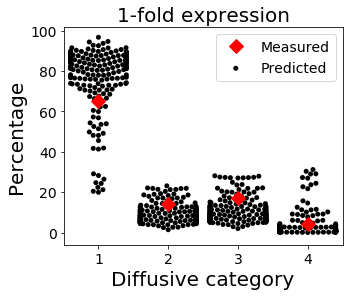

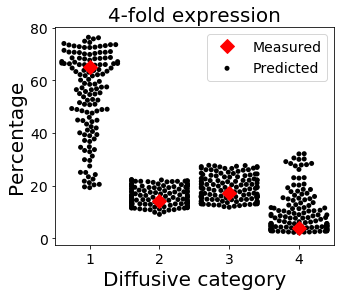

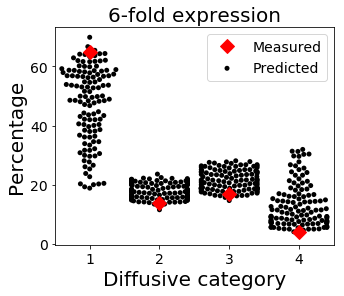

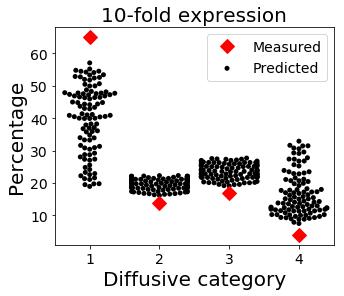

In [15]:
#tmp for 20190203
figsavedir='20190203/'
import os
if not os.path.exists(figsavedir):
    os.mkdir(figsavedir)
import pandas as pd
import seaborn as sns

import matplotlib.pyplot as plt
import pickle
%matplotlib inline


# Windows
cats_by_percentage_1x = pickle.load(open('C:\\Users\\mike\\Dropbox\\ElstonHahn\\20181010 - updated lifetime EA\\opt\\diffusivecats_1fe.pickle','rb'))
cats_by_percentage_4x = pickle.load(open('C:\\Users\\mike\\Dropbox\\ElstonHahn\\20181010 - updated lifetime EA\\opt\\diffusivecats_4fe.pickle','rb'))
cats_by_percentage_6x = pickle.load(open('C:\\Users\\mike\\Dropbox\\ElstonHahn\\20181010 - updated lifetime EA\\opt\\diffusivecats_6fe.pickle','rb'))
cats_by_percentage_10x = pickle.load(open('C:\\Users\\mike\\Dropbox\\ElstonHahn\\20181010 - updated lifetime EA\\opt\\diffusivecats_10fe.pickle','rb'))

# 1x
plt.figure(figsize=(5,4))
df = pd.melt(pd.DataFrame(cats_by_percentage_1x))
sns.swarmplot(x=df["variable"],y=df["value"],color='k')
plt.xlabel('Diffusive category',fontsize=20)
plt.ylabel('Percentage',fontsize=20)
plt.xticks((0,1,2,3),('1','2','3','4'))
plt.plot([0,1,2,3],[65,14,17,4],'Dr',zorder=3,markersize=10)
plt.legend(('Measured','Predicted'),fontsize=14)
plt.title('1-fold expression',fontsize=20)
plt.tick_params(axis='both',which='major',labelsize=14)
plt.savefig(figsavedir+'/diffusive_cat_1FE_v2.png',dpi=300,bbox_inches='tight')
plt.savefig(figsavedir+'/diffusive_cat_1FE_v2.svg',dpi=300,bbox_inches='tight')
plt.show()


# 4x
plt.figure(figsize=(5,4))
df = pd.melt(pd.DataFrame(cats_by_percentage_4x))
sns.swarmplot(x=df["variable"],y=df["value"],color='k')
plt.xlabel('Diffusive category',fontsize=20)
plt.ylabel('Percentage',fontsize=20)
plt.xticks((0,1,2,3),('1','2','3','4'))
plt.plot([0,1,2,3],[65,14,17,4],'Dr',zorder=3,markersize=10)
plt.legend(('Measured','Predicted'),fontsize=14)
plt.title('4-fold expression',fontsize=20)
plt.tick_params(axis='both',which='major',labelsize=14)
plt.savefig(figsavedir+'/diffusive_cat_4FE_v2.png',dpi=300,bbox_inches='tight')
plt.savefig(figsavedir+'/diffusive_cat_4FE_v2.svg',dpi=300,bbox_inches='tight')
plt.show()

# 6x
plt.figure(figsize=(5,4))
df = pd.melt(pd.DataFrame(cats_by_percentage_6x))
sns.swarmplot(x=df["variable"],y=df["value"],color='k')
plt.xlabel('Diffusive category',fontsize=20)
plt.ylabel('Percentage',fontsize=20)
plt.xticks((0,1,2,3),('1','2','3','4'))
plt.plot([0,1,2,3],[65,14,17,4],'Dr',zorder=3,markersize=10)
plt.legend(('Measured','Predicted'),fontsize=14)
plt.title('6-fold expression',fontsize=20)
plt.tick_params(axis='both',which='major',labelsize=14)
plt.savefig(figsavedir+'/diffusive_cat_6FE_v2.png',dpi=300,bbox_inches='tight')
plt.savefig(figsavedir+'/diffusive_cat_6FE_v2.svg',dpi=300,bbox_inches='tight')
plt.show()

# 10x
plt.figure(figsize=(5,4))
df = pd.melt(pd.DataFrame(cats_by_percentage_10x))
sns.swarmplot(x=df["variable"],y=df["value"],color='k')
plt.xlabel('Diffusive category',fontsize=20)
plt.ylabel('Percentage',fontsize=20)
plt.xticks((0,1,2,3),('1','2','3','4'))
plt.plot([0,1,2,3],[65,14,17,4],'Dr',zorder=3,markersize=10)
plt.legend(('Measured','Predicted'),fontsize=14)
plt.title('10-fold expression',fontsize=20)
plt.tick_params(axis='both',which='major',labelsize=14)
plt.savefig(figsavedir+'/diffusive_cat_10FE_v2.png',dpi=300,bbox_inches='tight')
plt.savefig(figsavedir+'/diffusive_cat_10FE_v2.svg',dpi=300,bbox_inches='tight')
plt.show()

#### 1x

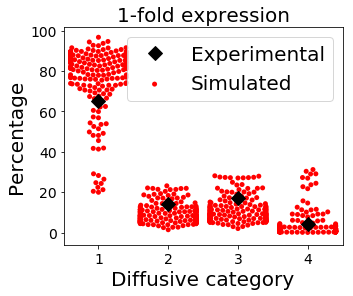

In [9]:
import seaborn as sns
import pandas as pd
import numpy as np

# cats_by_percentage = []
# for i in range(0,200):
#     try:
#         file_to_load = '/Volumes/SATAdrive/20181004_try4/181007_02_src-181007-01_ind%03d_expr01.csv'%(i)
#         #print('Loading file',file_to_load)
#         BTSE,bL,tsL,delays=load_SPT_kinetics(file_to_load,sim_dt)
#         cats = classify_diffusive_category(BTSE,int(20/sim_dt))
#         vals,_=np.histogram(cats,bins=(.5,1.5,2.5,3.5,4.5))
#         barheights = vals.astype(np.float32) / vals.sum() * 100
#         cats_by_percentage.append(barheights)
#     except:
#         pass
#         #print('analysis failed, continuing')
cats_by_percentage = pickle.load(open('/Volumes/SATAdrive/Dropbox/ElstonHahn/20180911_lifetimeEA/opt/diffusivecats_1fe.pickle','rb'))

plt.figure(figsize=(10,8))
df = pd.melt(pd.DataFrame(cats_by_percentage))
sns.swarmplot(x=df["variable"],y=df["value"],color='r')
plt.xlabel('Diffusive category',fontsize=20)
plt.ylabel('Percentage',fontsize=20)
plt.xticks((0,1,2,3),('1','2','3','4'))
plt.plot([0,1,2,3],[65,14,17,4],'Dk',zorder=3,markersize=10)
plt.legend(('Experimental','Simulated'),fontsize=20)
plt.title('1-fold expression',fontsize=20)
plt.tick_params(axis='both',which='major',labelsize=14)
plt.savefig(figsavedir+'/diffusive_cat_1FE_v2.tif',dpi=300,bbox_inches='tight')
plt.savefig(figsavedir+'/diffusive_cat_1FE_v2.svg',dpi=300,bbox_inches='tight')
plt.show()

#### 4x

In [ ]:
import seaborn as sns
import pandas as pd
import numpy as np



# cats_by_percentage = []
# for i in range(0,200):
#     try:
#         file_to_load = '/Volumes/SATAdrive/20181004_try4/181007_02_src-181007-01_ind%03d_expr04.csv'%(i)
#         print('Loading file',file_to_load)
#         BTSE,bL,tsL,delays=load_SPT_kinetics(file_to_load,sim_dt)
#         cats = classify_diffusive_category(BTSE,int(20/sim_dt))
#         vals,_=np.histogram(cats,bins=(.5,1.5,2.5,3.5,4.5))
#         barheights = vals.astype(np.float32) / vals.sum() * 100
#         cats_by_percentage.append(barheights)
#     except:
#         pass
#         #print('analysis failed, continuing')
cats_by_percentage = pickle.load(open('/Volumes/SATAdrive/Dropbox/ElstonHahn/20180911_lifetimeEA/opt/diffusivecats_4fe.pickle','rb'))



plt.figure(figsize=(10,8))
df = pd.melt(pd.DataFrame(cats_by_percentage))
sns.swarmplot(x=df["variable"],y=df["value"],color='r')
plt.xlabel('Diffusive category',fontsize=20)
plt.ylabel('Percentage',fontsize=20)
plt.xticks((0,1,2,3),('1','2','3','4'))
plt.plot([0,1,2,3],[64,11,20,5],'Dk',zorder=3,markersize=10)
plt.legend(('Experimental','Simulated'),fontsize=20)
plt.title('4-fold expression',fontsize=20)
plt.tick_params(axis='both',which='major',labelsize=14)
plt.savefig(figsavedir+'/diffusive_cat_4FE_v2.tif',dpi=300,bbox_inches='tight')
plt.savefig(figsavedir+'/diffusive_cat_4FE_v2.svg',dpi=300,bbox_inches='tight')
plt.show()

#### 6x

In [ ]:
import seaborn as sns
import pandas as pd
import numpy as np

# # Manually loading -- horribly slow. Better to use optimized BTSE analysis 
# cats_by_percentage = []
# for i in range(0,200):
#     try:
#         file_to_load = '/Volumes/SATAdrive/20181004_try4/181007_02_src-181007-01_ind%03d_expr06.csv'%(i)
#         print('Loading file',file_to_load)
#         BTSE,bL,tsL,delays=load_SPT_kinetics(file_to_load,sim_dt)
#         cats = classify_diffusive_category(BTSE,int(20/sim_dt))
#         vals,_=np.histogram(cats,bins=(.5,1.5,2.5,3.5,4.5))
#         barheights = vals.astype(np.float32) / vals.sum() * 100
#         cats_by_percentage.append(barheights)
#     except:
#         pass
#         #print('analysis failed, continuing')

# Assuming you've calculated and saved the results already
cats_by_percentage = pickle.load(open('/Volumes/SATAdrive/Dropbox/ElstonHahn/20180911_lifetimeEA/opt/diffusivecats_6fe.pickle','rb'))



plt.figure(figsize=(10,8))
df = pd.melt(pd.DataFrame(cats_by_percentage))
sns.swarmplot(x=df["variable"],y=df["value"],color='r')
plt.xlabel('Diffusive category',fontsize=20)
plt.ylabel('Percentage',fontsize=20)
plt.xticks((0,1,2,3),('1','2','3','4'))
plt.plot([0,1,2,3],[63,12,20,5],'Dk',zorder=3,markersize=10)
plt.legend(('Experimental','Simulated'),fontsize=20)
plt.title('6-fold expression',fontsize=20)
plt.tick_params(axis='both',which='major',labelsize=14)
plt.savefig(figsavedir+'/diffusive_cat_6FE_v2.tif',dpi=300,bbox_inches='tight')
plt.savefig(figsavedir+'/diffusive_cat_6FE_v2.svg',dpi=300,bbox_inches='tight')
plt.show()

#### 10x

In [ ]:
import seaborn as sns
import pandas as pd
import numpy as np
import pickle
import matplotlib.pyplot as plt
# cats_by_percentage = []
# for i in range(0,200):
#     try:
#         file_to_load = '/Volumes/SATAdrive/20181004_try4/181007_02_src-181007-01_ind%03d_expr10.csv'%(i)
#         print('Loading file',file_to_load)
#         BTSE,bL,tsL,delays=load_SPT_kinetics(file_to_load,sim_dt)
#         cats = classify_diffusive_category(BTSE,int(20/sim_dt))
#         vals,_=np.histogram(cats,bins=(.5,1.5,2.5,3.5,4.5))
#         barheights = vals.astype(np.float32) / vals.sum() * 100
#         cats_by_percentage.append(barheights)
#     except:
#         pass
#         #print('analysis failed, continuing')
cats_by_percentage = pickle.load(open('/Volumes/SATAdrive/Dropbox/ElstonHahn/20180911_lifetimeEA/opt/diffusivecats_10fe.pickle','rb'))

plt.figure(figsize=(10,8))
df = pd.melt(pd.DataFrame(cats_by_percentage))
sns.swarmplot(x=df["variable"],y=df["value"],color='r')
plt.xlabel('Diffusive category',fontsize=20)
plt.ylabel('Percentage',fontsize=20)
plt.xticks((0,1,2,3),('1','2','3','4'))
plt.plot([0,1,2,3],[62,15,18,5],'Dk',zorder=3,markersize=10)
plt.legend(('Experimental','Simulated'),fontsize=20)
plt.title('10-fold expression',fontsize=20)
plt.tick_params(axis='both',which='major',labelsize=14)
plt.savefig(figsavedir+'/diffusive_cat_10FE_v2.tif',dpi=300,bbox_inches='tight')
plt.savefig(figsavedir+'/diffusive_cat_10FE_v2.svg',dpi=300,bbox_inches='tight')
plt.show()

## Optimized BTSE analysis

In [ ]:
#!/usr/bin/env python
# This version is for 10x expression. Meant to be run on longleaf with 12 cores requested

import numpy as np
import matplotlib.pyplot as plt
import sys
import multiprocessing
import pickle
import os
import numpy as np


def find_runs(x):
    # ensure array
    x = np.asanyarray(x)
    if x.ndim != 1:
        raise ValueError('only 1D array supported')
    n = x.shape[0]

    # handle empty array
    if n == 0:
        return np.array([]), np.array([]), np.array([])

    else:
        # find run starts
        loc_run_start = np.empty(n, dtype=bool)
        loc_run_start[0] = True
        np.not_equal(x[:-1], x[1:], out=loc_run_start[1:])
        run_starts = np.nonzero(loc_run_start)[0]

        # find run values
        run_values = x[loc_run_start]

        # find run lengths
        run_lengths = np.diff(np.append(run_starts, n))

        return run_values, run_starts, run_lengths
    
def find_nearest(myArr,value,direction):
    # direction = "less" or "greater" relative to value.
    # to search left of value, use "greater"
    # to search right of value, use "less"
    if direction == "less":
        validArr = myArr[myArr>value]
        if len(validArr):
            return validArr.min()
        else:
            return len(myArr)
    elif direction == "greater":
        validArr = myArr[myArr<value]
        if len(validArr):
            return validArr.max()
        else:
            return 0
    else:
        assert False,'Invalid argument'
    
# Returns a list of 4-tuples, where each 4-tuple contains:
# (binStart,binEnd,tagStart,tagEnd).
def get_start_end_frames(rawseq):
    skipBinLastToEnd = False
    
    # Get sequences
    rv,rS,rL=find_runs(rawseq)
    # VSL is a list of 3-tuples, identifying sequential runs.
    # VSL[0][0] is the first sequence's state Value
    # VSL[0][1] is the first sequence's Start index
    # VSL[0][2] is the first sequence's run Length
    VSL = [(x,y,z) for x,y,z in zip(rv,rS,rL)]
    
    # Get (start,end) tuples for Binder
    binStartEnd = [(x[1],x[1]+x[2]-1) for x in VSL if ((x[0] in [5,7]) and (x[2]>14))]
    if len(binStartEnd)==0:
        return []
    else: # found usable start/end points
        tagStartEnd = np.zeros((len(binStartEnd),2))
        for i in range(0,len(binStartEnd)):
            # if the current binder sequence includes the end point we can try skipping it 
            if (binStartEnd[i][1] == len(rawseq)) and skipBinLastToEnd:
                continue
            
            # Search for corresponding tag start/end values
            currTagStart = 0
            currTagEnd = len(rawseq)-1
            
            # Get indices of all cytosolic frames
            cytoidx = np.asarray([j for j, x in enumerate(rawseq) if x in [1,3,8]])
            
            entry_from_cyto = find_nearest(cytoidx,binStartEnd[i][0],'greater')
            exit_from_cyto = find_nearest(cytoidx,binStartEnd[i][1],'less')
            
            currTagStart = entry_from_cyto+1
            currTagEnd = exit_from_cyto-1
            tagStartEnd[i,:]=[currTagStart,currTagEnd]
        ret = [(a[0],a[1],b[0],b[1]) for a,b in zip(binStartEnd,tagStartEnd)]
        #print(ret)
        return ret

def classify_diffusive_category(BTSE,tol):
    # tolerance in frames.
    # if within tol, consider as "same time"
    categories = []
    for i in range(0,len(BTSE)):
        # BTSE[i][0] : particle index
        # BTSE[i][1] : binder start
        # BTSE[i][2] : binder end
        # BTSE[i][3] : tagSrc start
        # BTSE[i][4] : tagSrc end
        
        if abs(BTSE[i][1] - BTSE[i][3]) < tol: # start same time
            if abs(BTSE[i][2] - BTSE[i][4]) < tol: # leave same time
                currtype = 4
            else:
                currtype = 3
        else:
            assert BTSE[i][1] > BTSE[i][3],'Binder started before tagSrc?'
            if abs(BTSE[i][2] - BTSE[i][4]) < tol: # leave same time
                currtype = 2
            else:
                currtype = 1
        categories.append(currtype)
    return categories
    
def load_SPT_kinetics(fileloc,dt):
    # dt in ms
    sim_data = np.genfromtxt(fileloc,delimiter=',')
    # Find out if the simulation was pre-truncated
    #print(np.shape(sim_data))
    truncSimLoc = np.where(~sim_data.any(axis=0))
    if len(truncSimLoc[0]):
        simend = truncSimLoc[0][0]
        sim_data = sim_data[:,:simend]
    
    BTSE = []
    binLifetimes = []
    tagLifetimes = []
    delaytimes = []
    
    ntracks = np.shape(sim_data)[0]
    #ntracks = 1
    print('Working on',fileloc)
        
    for i in range(0,ntracks):        
        sys.stdout.flush()
        currBTSE = get_start_end_frames(sim_data[i,:])
        if len(currBTSE):
            for j in range(0,len(currBTSE)):
                BTSE.append([i,currBTSE[j][0],currBTSE[j][1],currBTSE[j][2],currBTSE[j][3]])
                binLifetimes.append(dt*(currBTSE[j][1]-currBTSE[j][0]))
                tagLifetimes.append(dt*(currBTSE[j][3]-currBTSE[j][2]))
                delaytimes.append(dt*(currBTSE[j][0]-currBTSE[j][2]))
    #categories = classify_diffusive_category(BTSE)
    return BTSE,binLifetimes,tagLifetimes,delaytimes

def get_hist_as_pct(data,targbins):
    H,B = np.histogram(data,bins=targbins)
    H = H.astype(np.float32) / H.sum() * 100
    return H,B

def do_analysis(file_to_load):
    sim_dt = 0.0001*1000 # ms
    BTSE,bL,tsL,delays=load_SPT_kinetics(file_to_load,sim_dt)
    cats = classify_diffusive_category(BTSE,int(20/sim_dt))
    vals,_=np.histogram(cats,bins=(.5,1.5,2.5,3.5,4.5))
    barheights = vals.astype(np.float32) / vals.sum() * 100
    #cats_by_percentage.append(barheights)
    return barheights


def main():
    pool=multiprocessing.Pool(processes=12)
    files_to_load = []
    for i in range(0,199):
        targfile = '/pine/scr/m/i/mikepab/SPTkin_sim/181003_02/try4/181007_02_src-181007-01_ind%03d_expr10.csv'%(i)
        exists = os.path.isfile(targfile)
        if exists:
            files_to_load.append(targfile)
        else:
            pass
         
    cats_by_percentage = pool.map(do_analysis,(myfile for myfile in files_to_load))
    pickle.dump(cats_by_percentage,open('diffusivecats_10fe.pickle','wb'))

if __name__ == '__main__':
    main()
